# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [0]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [0]:
!mkdir data

## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:06, 29.0MB/s]                           
SVHN Testing Set: 64.3MB [00:03, 19.5MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [0]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

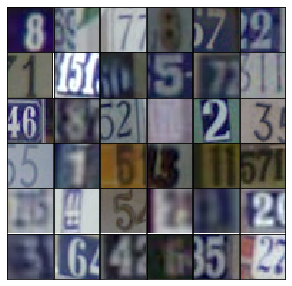

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [0]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [0]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [0]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [0]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [0]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [0]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [0]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [0]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [0]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [0]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [0]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.1840... Generator Loss: 0.7506
Epoch 1/25... Discriminator Loss: 0.5580... Generator Loss: 1.3524
Epoch 1/25... Discriminator Loss: 0.1755... Generator Loss: 2.3176
Epoch 1/25... Discriminator Loss: 0.1472... Generator Loss: 2.7874
Epoch 1/25... Discriminator Loss: 0.1582... Generator Loss: 2.9901
Epoch 1/25... Discriminator Loss: 0.5770... Generator Loss: 1.4117
Epoch 1/25... Discriminator Loss: 0.8315... Generator Loss: 1.2769
Epoch 1/25... Discriminator Loss: 1.1391... Generator Loss: 0.6795
Epoch 1/25... Discriminator Loss: 0.6454... Generator Loss: 1.6874
Epoch 1/25... Discriminator Loss: 0.4751... Generator Loss: 2.0394


/usr/local/lib/python3.6/dist-packages/matplotlib/axes/_base.py:1334: MatplotlibDeprecationWarning: 
box-forced
  "2.2", "box-forced", obj_type="keyword argument")


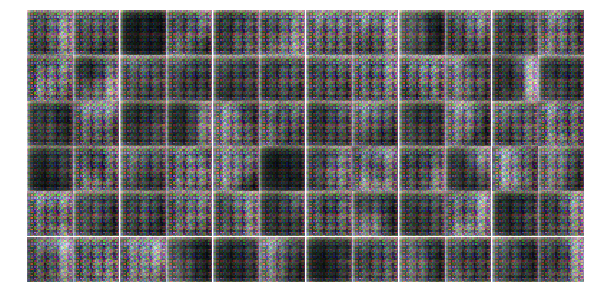

Epoch 1/25... Discriminator Loss: 0.5953... Generator Loss: 1.2204
Epoch 1/25... Discriminator Loss: 0.5082... Generator Loss: 1.7200
Epoch 1/25... Discriminator Loss: 0.5483... Generator Loss: 1.8714
Epoch 1/25... Discriminator Loss: 0.3662... Generator Loss: 2.3032
Epoch 1/25... Discriminator Loss: 0.9498... Generator Loss: 0.7328
Epoch 1/25... Discriminator Loss: 0.6791... Generator Loss: 1.9085
Epoch 1/25... Discriminator Loss: 0.4255... Generator Loss: 2.4482
Epoch 1/25... Discriminator Loss: 0.8484... Generator Loss: 1.2998
Epoch 1/25... Discriminator Loss: 0.4180... Generator Loss: 2.1125
Epoch 1/25... Discriminator Loss: 0.3340... Generator Loss: 4.0389


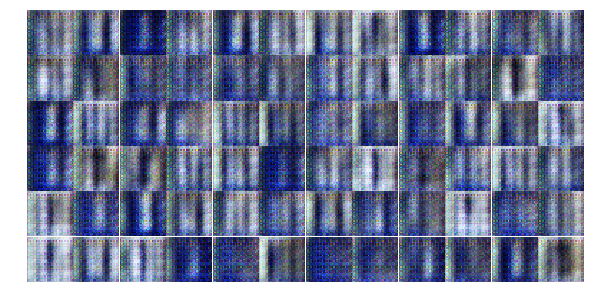

Epoch 1/25... Discriminator Loss: 0.3863... Generator Loss: 2.7798
Epoch 1/25... Discriminator Loss: 0.4876... Generator Loss: 1.6957
Epoch 1/25... Discriminator Loss: 1.9299... Generator Loss: 0.7023
Epoch 1/25... Discriminator Loss: 0.5636... Generator Loss: 3.3961
Epoch 1/25... Discriminator Loss: 0.8753... Generator Loss: 1.8329
Epoch 1/25... Discriminator Loss: 0.5120... Generator Loss: 1.5688
Epoch 1/25... Discriminator Loss: 1.2422... Generator Loss: 3.0130
Epoch 1/25... Discriminator Loss: 0.4104... Generator Loss: 2.0146
Epoch 1/25... Discriminator Loss: 0.3594... Generator Loss: 1.9330
Epoch 1/25... Discriminator Loss: 0.3635... Generator Loss: 2.8550


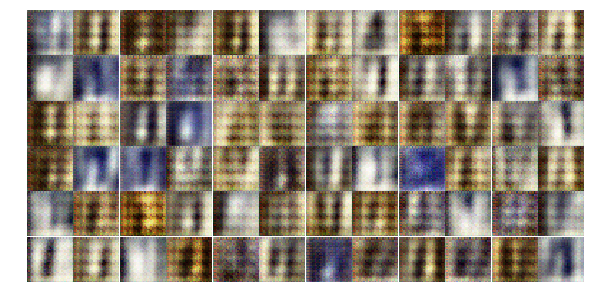

Epoch 1/25... Discriminator Loss: 0.6799... Generator Loss: 1.6232
Epoch 1/25... Discriminator Loss: 0.4607... Generator Loss: 1.4943
Epoch 1/25... Discriminator Loss: 0.4764... Generator Loss: 1.9755
Epoch 1/25... Discriminator Loss: 0.3373... Generator Loss: 2.0522
Epoch 1/25... Discriminator Loss: 0.2968... Generator Loss: 2.0848
Epoch 1/25... Discriminator Loss: 0.3369... Generator Loss: 2.0395
Epoch 1/25... Discriminator Loss: 0.3275... Generator Loss: 2.3738
Epoch 1/25... Discriminator Loss: 0.3677... Generator Loss: 2.3326
Epoch 1/25... Discriminator Loss: 0.6925... Generator Loss: 1.8694
Epoch 1/25... Discriminator Loss: 0.4485... Generator Loss: 2.2130


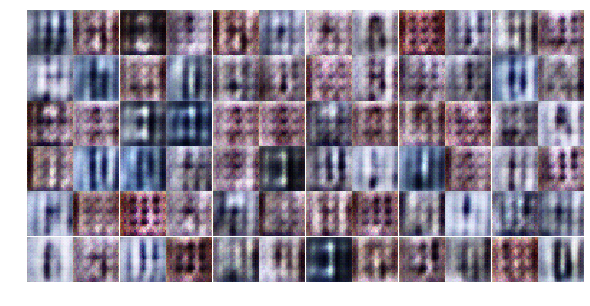

Epoch 1/25... Discriminator Loss: 0.3562... Generator Loss: 1.7613
Epoch 1/25... Discriminator Loss: 0.3552... Generator Loss: 1.5674
Epoch 1/25... Discriminator Loss: 0.2844... Generator Loss: 3.8533
Epoch 1/25... Discriminator Loss: 0.4407... Generator Loss: 2.6961
Epoch 1/25... Discriminator Loss: 0.4275... Generator Loss: 2.2329
Epoch 1/25... Discriminator Loss: 0.8448... Generator Loss: 1.1595
Epoch 1/25... Discriminator Loss: 0.4483... Generator Loss: 1.6631
Epoch 1/25... Discriminator Loss: 0.2982... Generator Loss: 2.4704
Epoch 1/25... Discriminator Loss: 0.5165... Generator Loss: 4.1946
Epoch 1/25... Discriminator Loss: 0.2837... Generator Loss: 2.1841


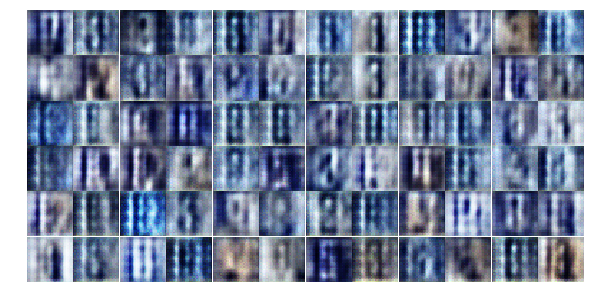

Epoch 1/25... Discriminator Loss: 0.4412... Generator Loss: 1.4712
Epoch 1/25... Discriminator Loss: 0.8313... Generator Loss: 1.0451
Epoch 1/25... Discriminator Loss: 0.3707... Generator Loss: 2.0325
Epoch 1/25... Discriminator Loss: 1.0544... Generator Loss: 0.6850
Epoch 1/25... Discriminator Loss: 0.5551... Generator Loss: 2.7343
Epoch 1/25... Discriminator Loss: 0.5603... Generator Loss: 1.5379
Epoch 1/25... Discriminator Loss: 0.5820... Generator Loss: 1.6192
Epoch 2/25... Discriminator Loss: 0.6617... Generator Loss: 2.1905
Epoch 2/25... Discriminator Loss: 0.4786... Generator Loss: 1.8270
Epoch 2/25... Discriminator Loss: 0.7775... Generator Loss: 1.3850


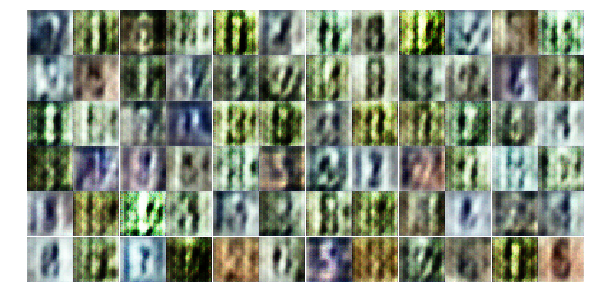

Epoch 2/25... Discriminator Loss: 0.5970... Generator Loss: 1.8239
Epoch 2/25... Discriminator Loss: 0.7428... Generator Loss: 1.2211
Epoch 2/25... Discriminator Loss: 0.7743... Generator Loss: 1.0100
Epoch 2/25... Discriminator Loss: 0.5207... Generator Loss: 1.7171
Epoch 2/25... Discriminator Loss: 0.7348... Generator Loss: 1.1219
Epoch 2/25... Discriminator Loss: 0.9480... Generator Loss: 1.2872
Epoch 2/25... Discriminator Loss: 0.7646... Generator Loss: 1.5245
Epoch 2/25... Discriminator Loss: 0.8902... Generator Loss: 1.1601
Epoch 2/25... Discriminator Loss: 0.8115... Generator Loss: 1.1963
Epoch 2/25... Discriminator Loss: 0.8221... Generator Loss: 1.0084


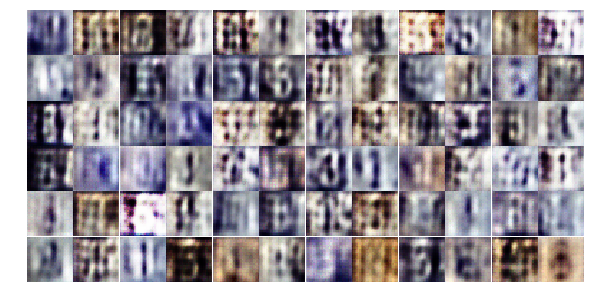

Epoch 2/25... Discriminator Loss: 0.6325... Generator Loss: 1.4242
Epoch 2/25... Discriminator Loss: 0.5771... Generator Loss: 2.0047
Epoch 2/25... Discriminator Loss: 0.9749... Generator Loss: 1.0682
Epoch 2/25... Discriminator Loss: 1.1065... Generator Loss: 1.1763
Epoch 2/25... Discriminator Loss: 0.9097... Generator Loss: 2.0000
Epoch 2/25... Discriminator Loss: 0.9056... Generator Loss: 0.9503
Epoch 2/25... Discriminator Loss: 0.8117... Generator Loss: 0.9143
Epoch 2/25... Discriminator Loss: 0.9347... Generator Loss: 1.8547
Epoch 2/25... Discriminator Loss: 1.0279... Generator Loss: 1.0127
Epoch 2/25... Discriminator Loss: 1.0978... Generator Loss: 0.6693


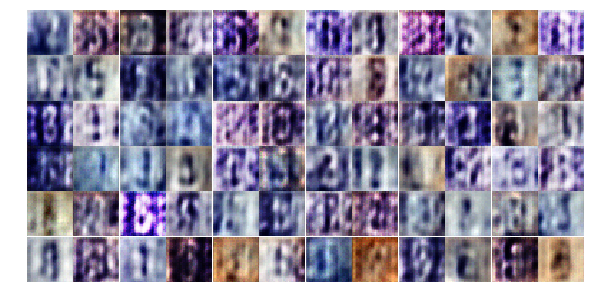

Epoch 2/25... Discriminator Loss: 1.0977... Generator Loss: 1.1751
Epoch 2/25... Discriminator Loss: 0.9311... Generator Loss: 1.5531
Epoch 2/25... Discriminator Loss: 0.7630... Generator Loss: 1.5030
Epoch 2/25... Discriminator Loss: 1.2122... Generator Loss: 1.1735
Epoch 2/25... Discriminator Loss: 1.0607... Generator Loss: 1.1820
Epoch 2/25... Discriminator Loss: 1.0953... Generator Loss: 1.1227
Epoch 2/25... Discriminator Loss: 0.6680... Generator Loss: 1.3429
Epoch 2/25... Discriminator Loss: 1.0284... Generator Loss: 0.9124
Epoch 2/25... Discriminator Loss: 1.1878... Generator Loss: 1.0924
Epoch 2/25... Discriminator Loss: 0.6749... Generator Loss: 1.5664


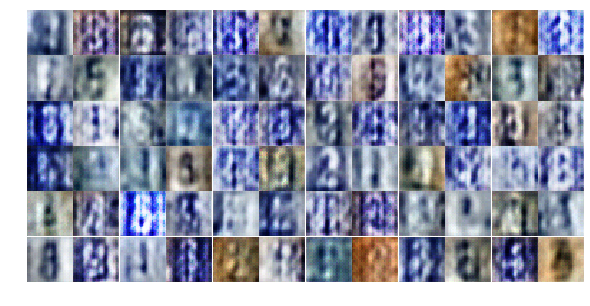

Epoch 2/25... Discriminator Loss: 1.1569... Generator Loss: 0.7438
Epoch 2/25... Discriminator Loss: 1.3312... Generator Loss: 0.7262
Epoch 2/25... Discriminator Loss: 1.2207... Generator Loss: 0.8396
Epoch 2/25... Discriminator Loss: 1.2603... Generator Loss: 0.8194
Epoch 2/25... Discriminator Loss: 1.0546... Generator Loss: 1.2805
Epoch 2/25... Discriminator Loss: 1.0348... Generator Loss: 0.8937
Epoch 2/25... Discriminator Loss: 0.8031... Generator Loss: 1.1518
Epoch 2/25... Discriminator Loss: 0.6740... Generator Loss: 1.6092
Epoch 2/25... Discriminator Loss: 1.0729... Generator Loss: 0.9433
Epoch 2/25... Discriminator Loss: 0.9638... Generator Loss: 1.2922


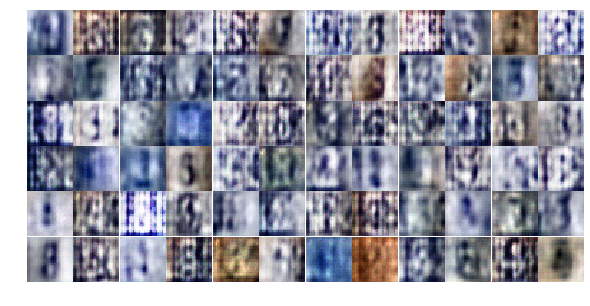

Epoch 2/25... Discriminator Loss: 0.8513... Generator Loss: 1.3120
Epoch 2/25... Discriminator Loss: 1.2186... Generator Loss: 0.9394
Epoch 2/25... Discriminator Loss: 0.7998... Generator Loss: 1.4109
Epoch 2/25... Discriminator Loss: 1.0660... Generator Loss: 0.8417
Epoch 2/25... Discriminator Loss: 1.0137... Generator Loss: 1.5322
Epoch 2/25... Discriminator Loss: 0.6659... Generator Loss: 1.1838
Epoch 2/25... Discriminator Loss: 1.0327... Generator Loss: 1.3633
Epoch 2/25... Discriminator Loss: 0.9114... Generator Loss: 1.0281
Epoch 2/25... Discriminator Loss: 0.8378... Generator Loss: 1.3569
Epoch 2/25... Discriminator Loss: 0.7199... Generator Loss: 1.2792


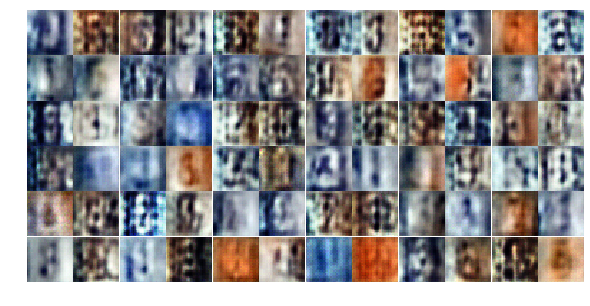

Epoch 2/25... Discriminator Loss: 1.0047... Generator Loss: 1.0374
Epoch 2/25... Discriminator Loss: 0.8365... Generator Loss: 1.1958
Epoch 2/25... Discriminator Loss: 1.0061... Generator Loss: 0.8593
Epoch 2/25... Discriminator Loss: 1.0288... Generator Loss: 1.6139
Epoch 3/25... Discriminator Loss: 0.7156... Generator Loss: 1.5085
Epoch 3/25... Discriminator Loss: 0.7528... Generator Loss: 0.9980
Epoch 3/25... Discriminator Loss: 0.8878... Generator Loss: 0.9906
Epoch 3/25... Discriminator Loss: 0.7402... Generator Loss: 1.4416
Epoch 3/25... Discriminator Loss: 0.8197... Generator Loss: 1.1846
Epoch 3/25... Discriminator Loss: 0.8646... Generator Loss: 0.8919


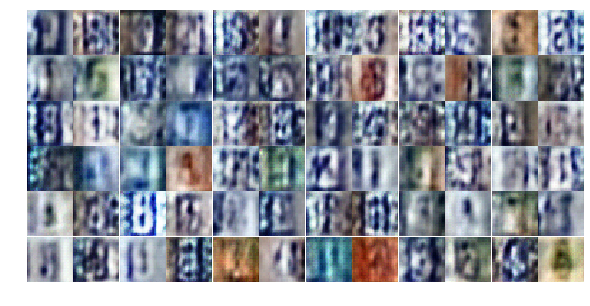

Epoch 3/25... Discriminator Loss: 0.4886... Generator Loss: 1.9956
Epoch 3/25... Discriminator Loss: 0.5693... Generator Loss: 1.7829
Epoch 3/25... Discriminator Loss: 0.9572... Generator Loss: 0.8088
Epoch 3/25... Discriminator Loss: 0.6371... Generator Loss: 1.2542
Epoch 3/25... Discriminator Loss: 0.8577... Generator Loss: 1.0774
Epoch 3/25... Discriminator Loss: 0.7260... Generator Loss: 1.2003
Epoch 3/25... Discriminator Loss: 0.5886... Generator Loss: 1.4527
Epoch 3/25... Discriminator Loss: 0.6377... Generator Loss: 1.8827
Epoch 3/25... Discriminator Loss: 0.8309... Generator Loss: 0.9957
Epoch 3/25... Discriminator Loss: 0.6001... Generator Loss: 1.3440


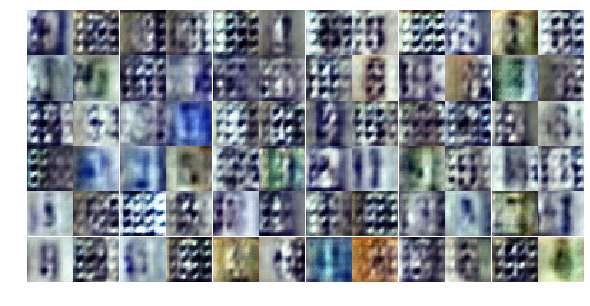

Epoch 3/25... Discriminator Loss: 0.6813... Generator Loss: 1.7844
Epoch 3/25... Discriminator Loss: 0.8728... Generator Loss: 0.9579
Epoch 3/25... Discriminator Loss: 0.6766... Generator Loss: 1.0648
Epoch 3/25... Discriminator Loss: 0.7272... Generator Loss: 1.3656
Epoch 3/25... Discriminator Loss: 0.7656... Generator Loss: 1.3351
Epoch 3/25... Discriminator Loss: 0.7531... Generator Loss: 1.0466
Epoch 3/25... Discriminator Loss: 0.6411... Generator Loss: 1.9937
Epoch 3/25... Discriminator Loss: 1.0008... Generator Loss: 2.5028
Epoch 3/25... Discriminator Loss: 0.8034... Generator Loss: 2.9125
Epoch 3/25... Discriminator Loss: 0.7511... Generator Loss: 1.0584


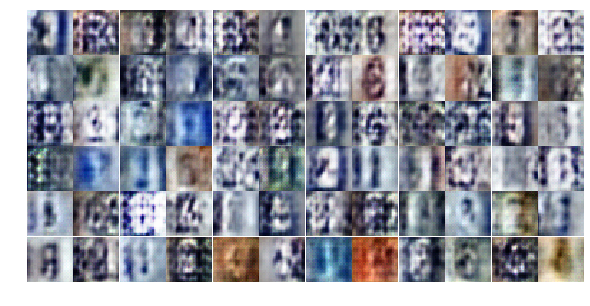

Epoch 3/25... Discriminator Loss: 0.4968... Generator Loss: 2.2079
Epoch 3/25... Discriminator Loss: 0.4872... Generator Loss: 2.0683
Epoch 3/25... Discriminator Loss: 0.4229... Generator Loss: 1.5153
Epoch 3/25... Discriminator Loss: 0.5113... Generator Loss: 1.1507
Epoch 3/25... Discriminator Loss: 0.7562... Generator Loss: 2.6078
Epoch 3/25... Discriminator Loss: 0.6609... Generator Loss: 1.3550
Epoch 3/25... Discriminator Loss: 0.7389... Generator Loss: 1.0585
Epoch 3/25... Discriminator Loss: 1.3785... Generator Loss: 0.4377
Epoch 3/25... Discriminator Loss: 0.7625... Generator Loss: 1.4959
Epoch 3/25... Discriminator Loss: 0.6333... Generator Loss: 1.2709


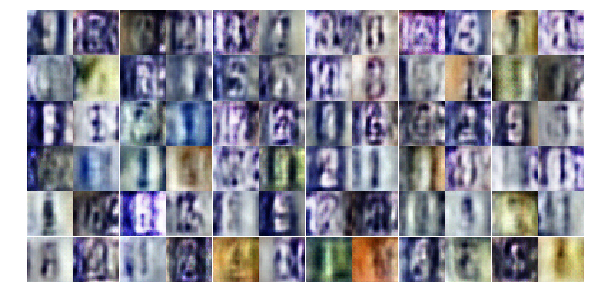

Epoch 3/25... Discriminator Loss: 0.2773... Generator Loss: 2.8102
Epoch 3/25... Discriminator Loss: 0.3915... Generator Loss: 2.1129
Epoch 3/25... Discriminator Loss: 0.3574... Generator Loss: 2.0716
Epoch 3/25... Discriminator Loss: 0.5562... Generator Loss: 1.7968
Epoch 3/25... Discriminator Loss: 0.4265... Generator Loss: 1.9735
Epoch 3/25... Discriminator Loss: 0.4415... Generator Loss: 2.1819
Epoch 3/25... Discriminator Loss: 0.4665... Generator Loss: 1.5891
Epoch 3/25... Discriminator Loss: 0.3279... Generator Loss: 1.9184
Epoch 3/25... Discriminator Loss: 0.6013... Generator Loss: 1.9646
Epoch 3/25... Discriminator Loss: 0.8781... Generator Loss: 1.0793


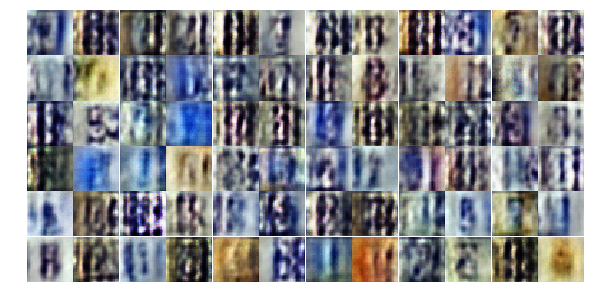

Epoch 3/25... Discriminator Loss: 0.5638... Generator Loss: 1.6767
Epoch 3/25... Discriminator Loss: 0.5945... Generator Loss: 1.6292
Epoch 3/25... Discriminator Loss: 0.4482... Generator Loss: 1.7768
Epoch 3/25... Discriminator Loss: 0.3253... Generator Loss: 2.4071
Epoch 3/25... Discriminator Loss: 0.3648... Generator Loss: 2.2843
Epoch 3/25... Discriminator Loss: 0.3342... Generator Loss: 2.1091
Epoch 3/25... Discriminator Loss: 0.2778... Generator Loss: 2.4458
Epoch 3/25... Discriminator Loss: 0.2925... Generator Loss: 2.1861
Epoch 3/25... Discriminator Loss: 0.5809... Generator Loss: 1.5870
Epoch 3/25... Discriminator Loss: 0.4929... Generator Loss: 1.3732


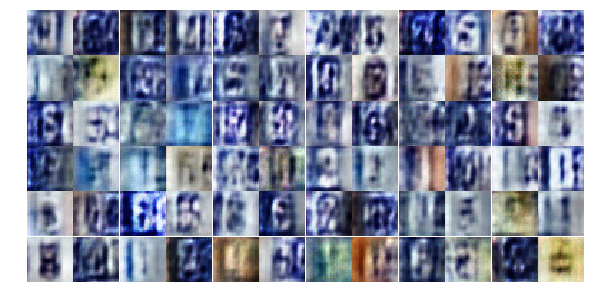

Epoch 3/25... Discriminator Loss: 0.5371... Generator Loss: 1.3779
Epoch 4/25... Discriminator Loss: 1.4811... Generator Loss: 2.5102
Epoch 4/25... Discriminator Loss: 0.9045... Generator Loss: 0.9039
Epoch 4/25... Discriminator Loss: 0.8103... Generator Loss: 0.8885
Epoch 4/25... Discriminator Loss: 0.5002... Generator Loss: 1.3435
Epoch 4/25... Discriminator Loss: 0.7009... Generator Loss: 1.0284
Epoch 4/25... Discriminator Loss: 0.4663... Generator Loss: 1.7937
Epoch 4/25... Discriminator Loss: 0.7487... Generator Loss: 1.0092
Epoch 4/25... Discriminator Loss: 0.5095... Generator Loss: 2.4475
Epoch 4/25... Discriminator Loss: 0.8214... Generator Loss: 1.0231


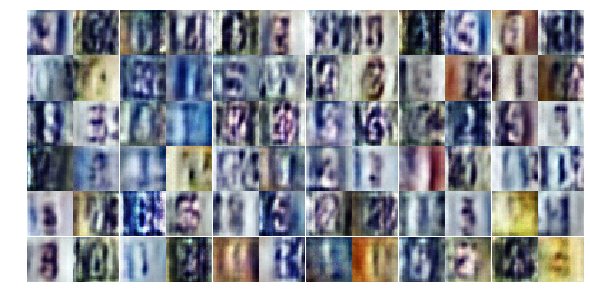

Epoch 4/25... Discriminator Loss: 0.4815... Generator Loss: 2.3939
Epoch 4/25... Discriminator Loss: 0.6623... Generator Loss: 1.0096
Epoch 4/25... Discriminator Loss: 0.5058... Generator Loss: 2.0148
Epoch 4/25... Discriminator Loss: 0.5094... Generator Loss: 1.3366
Epoch 4/25... Discriminator Loss: 1.0740... Generator Loss: 2.9607
Epoch 4/25... Discriminator Loss: 0.6313... Generator Loss: 1.0868
Epoch 4/25... Discriminator Loss: 0.5071... Generator Loss: 1.7608
Epoch 4/25... Discriminator Loss: 0.6823... Generator Loss: 1.1007
Epoch 4/25... Discriminator Loss: 1.6027... Generator Loss: 3.1542
Epoch 4/25... Discriminator Loss: 0.4804... Generator Loss: 2.7859


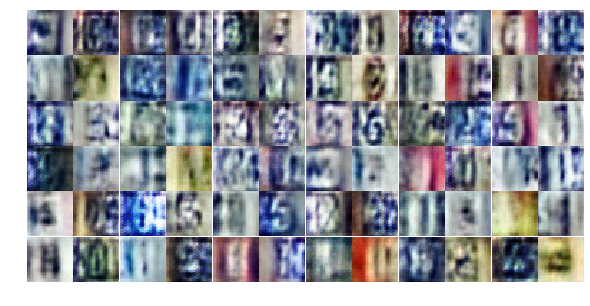

Epoch 4/25... Discriminator Loss: 0.4547... Generator Loss: 2.0626
Epoch 4/25... Discriminator Loss: 0.5265... Generator Loss: 3.3552
Epoch 4/25... Discriminator Loss: 0.6599... Generator Loss: 1.5563
Epoch 4/25... Discriminator Loss: 0.6423... Generator Loss: 1.3838
Epoch 4/25... Discriminator Loss: 0.2579... Generator Loss: 2.0573
Epoch 4/25... Discriminator Loss: 1.0000... Generator Loss: 3.6388
Epoch 4/25... Discriminator Loss: 0.3904... Generator Loss: 1.7542
Epoch 4/25... Discriminator Loss: 0.5115... Generator Loss: 1.7912
Epoch 4/25... Discriminator Loss: 0.4395... Generator Loss: 1.5318
Epoch 4/25... Discriminator Loss: 0.6377... Generator Loss: 1.9151


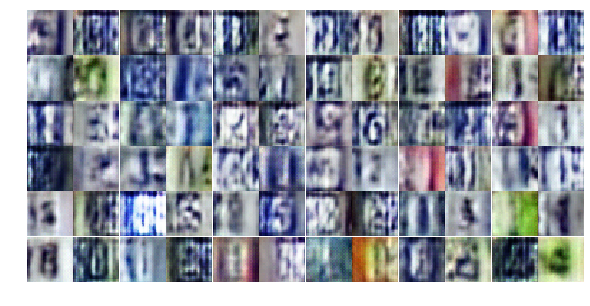

Epoch 4/25... Discriminator Loss: 0.4002... Generator Loss: 2.1499
Epoch 4/25... Discriminator Loss: 0.6022... Generator Loss: 1.1673
Epoch 4/25... Discriminator Loss: 0.5181... Generator Loss: 1.4246
Epoch 4/25... Discriminator Loss: 0.4496... Generator Loss: 1.5598
Epoch 4/25... Discriminator Loss: 0.2594... Generator Loss: 2.5237
Epoch 4/25... Discriminator Loss: 0.3168... Generator Loss: 2.0284
Epoch 4/25... Discriminator Loss: 0.2837... Generator Loss: 2.6788
Epoch 4/25... Discriminator Loss: 1.1521... Generator Loss: 3.7775
Epoch 4/25... Discriminator Loss: 0.6181... Generator Loss: 1.1375
Epoch 4/25... Discriminator Loss: 0.5059... Generator Loss: 1.3233


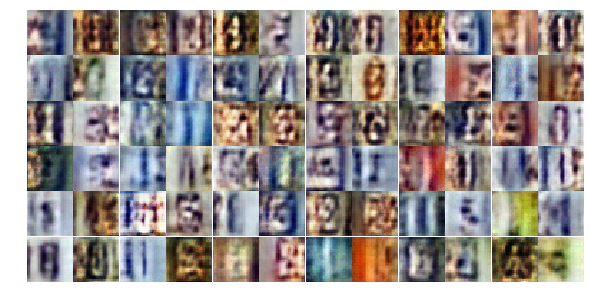

Epoch 4/25... Discriminator Loss: 0.7160... Generator Loss: 0.9163
Epoch 4/25... Discriminator Loss: 0.2806... Generator Loss: 2.3839
Epoch 4/25... Discriminator Loss: 0.5953... Generator Loss: 1.2388
Epoch 4/25... Discriminator Loss: 0.4037... Generator Loss: 1.5173
Epoch 4/25... Discriminator Loss: 0.6866... Generator Loss: 1.1083
Epoch 4/25... Discriminator Loss: 0.5776... Generator Loss: 1.4761
Epoch 4/25... Discriminator Loss: 1.0460... Generator Loss: 0.6806
Epoch 4/25... Discriminator Loss: 1.0790... Generator Loss: 0.6899
Epoch 4/25... Discriminator Loss: 0.7583... Generator Loss: 0.9557
Epoch 4/25... Discriminator Loss: 0.4848... Generator Loss: 1.6540


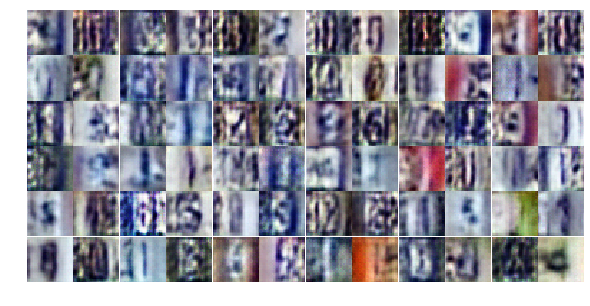

Epoch 4/25... Discriminator Loss: 0.4135... Generator Loss: 2.3560
Epoch 4/25... Discriminator Loss: 0.2721... Generator Loss: 2.1704
Epoch 4/25... Discriminator Loss: 0.4441... Generator Loss: 1.5847
Epoch 4/25... Discriminator Loss: 1.2377... Generator Loss: 2.3314
Epoch 4/25... Discriminator Loss: 0.6430... Generator Loss: 1.2013
Epoch 4/25... Discriminator Loss: 0.5384... Generator Loss: 1.2826
Epoch 4/25... Discriminator Loss: 0.3096... Generator Loss: 2.0117
Epoch 4/25... Discriminator Loss: 0.4444... Generator Loss: 1.5022
Epoch 4/25... Discriminator Loss: 0.4727... Generator Loss: 1.3627
Epoch 5/25... Discriminator Loss: 0.4070... Generator Loss: 1.6105


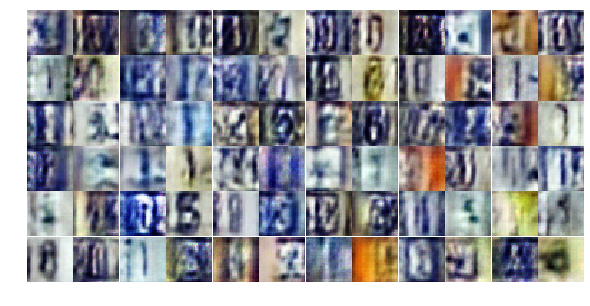

Epoch 5/25... Discriminator Loss: 0.3063... Generator Loss: 2.0188
Epoch 5/25... Discriminator Loss: 0.4800... Generator Loss: 1.9903
Epoch 5/25... Discriminator Loss: 0.6266... Generator Loss: 1.2072
Epoch 5/25... Discriminator Loss: 0.5889... Generator Loss: 1.1486
Epoch 5/25... Discriminator Loss: 0.5270... Generator Loss: 1.2942
Epoch 5/25... Discriminator Loss: 1.0876... Generator Loss: 0.5314
Epoch 5/25... Discriminator Loss: 0.5767... Generator Loss: 1.1673
Epoch 5/25... Discriminator Loss: 0.4621... Generator Loss: 1.6685
Epoch 5/25... Discriminator Loss: 0.8517... Generator Loss: 0.7442
Epoch 5/25... Discriminator Loss: 0.6155... Generator Loss: 1.1917


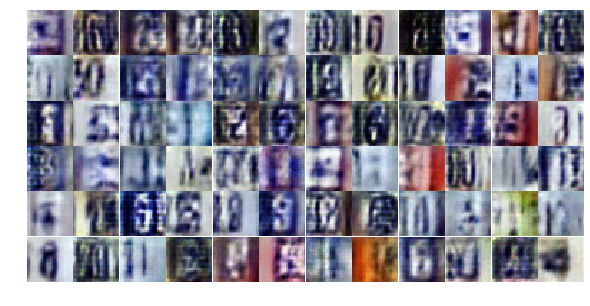

Epoch 5/25... Discriminator Loss: 0.5802... Generator Loss: 1.1701
Epoch 5/25... Discriminator Loss: 0.4023... Generator Loss: 1.5174
Epoch 5/25... Discriminator Loss: 0.6329... Generator Loss: 3.1397
Epoch 5/25... Discriminator Loss: 1.5281... Generator Loss: 0.3625
Epoch 5/25... Discriminator Loss: 0.5993... Generator Loss: 1.9514
Epoch 5/25... Discriminator Loss: 0.9165... Generator Loss: 0.8241
Epoch 5/25... Discriminator Loss: 0.4694... Generator Loss: 1.4656
Epoch 5/25... Discriminator Loss: 0.4064... Generator Loss: 1.9495
Epoch 5/25... Discriminator Loss: 0.5967... Generator Loss: 2.9873
Epoch 5/25... Discriminator Loss: 0.4124... Generator Loss: 1.7624


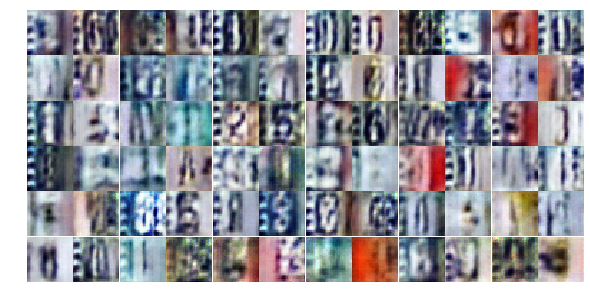

Epoch 5/25... Discriminator Loss: 0.4957... Generator Loss: 1.2938
Epoch 5/25... Discriminator Loss: 0.5670... Generator Loss: 1.2454
Epoch 5/25... Discriminator Loss: 0.6558... Generator Loss: 1.0204
Epoch 5/25... Discriminator Loss: 0.4140... Generator Loss: 1.5825
Epoch 5/25... Discriminator Loss: 0.6193... Generator Loss: 0.9915
Epoch 5/25... Discriminator Loss: 0.7970... Generator Loss: 3.2324
Epoch 5/25... Discriminator Loss: 0.6556... Generator Loss: 0.9961
Epoch 5/25... Discriminator Loss: 0.4190... Generator Loss: 1.6952
Epoch 5/25... Discriminator Loss: 0.5238... Generator Loss: 1.3841
Epoch 5/25... Discriminator Loss: 0.3397... Generator Loss: 1.7955


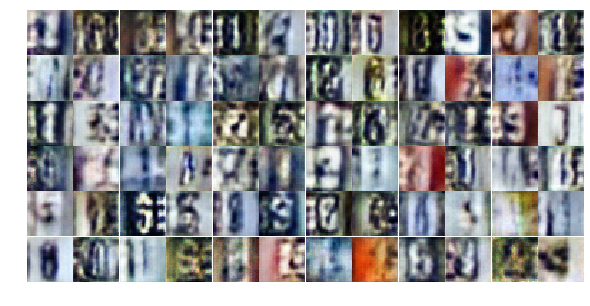

Epoch 5/25... Discriminator Loss: 0.7775... Generator Loss: 1.1787
Epoch 5/25... Discriminator Loss: 0.8894... Generator Loss: 0.9637
Epoch 5/25... Discriminator Loss: 0.4696... Generator Loss: 1.8359
Epoch 5/25... Discriminator Loss: 0.4409... Generator Loss: 1.7661
Epoch 5/25... Discriminator Loss: 0.7511... Generator Loss: 1.4543
Epoch 5/25... Discriminator Loss: 0.2597... Generator Loss: 2.6583
Epoch 5/25... Discriminator Loss: 0.4465... Generator Loss: 1.8129
Epoch 5/25... Discriminator Loss: 0.7591... Generator Loss: 0.9007
Epoch 5/25... Discriminator Loss: 0.8414... Generator Loss: 0.7890
Epoch 5/25... Discriminator Loss: 0.3428... Generator Loss: 1.9247


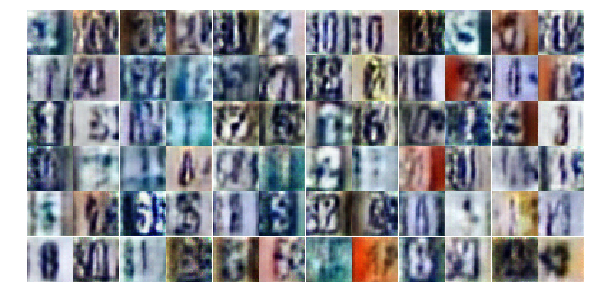

Epoch 5/25... Discriminator Loss: 0.5409... Generator Loss: 2.4300
Epoch 5/25... Discriminator Loss: 0.6970... Generator Loss: 1.0295
Epoch 5/25... Discriminator Loss: 0.8165... Generator Loss: 0.7954
Epoch 5/25... Discriminator Loss: 0.4907... Generator Loss: 2.2078
Epoch 5/25... Discriminator Loss: 1.0528... Generator Loss: 3.2654
Epoch 5/25... Discriminator Loss: 0.7260... Generator Loss: 1.1665
Epoch 5/25... Discriminator Loss: 0.4777... Generator Loss: 1.3789
Epoch 5/25... Discriminator Loss: 0.6851... Generator Loss: 0.9743
Epoch 5/25... Discriminator Loss: 0.6495... Generator Loss: 1.0374
Epoch 5/25... Discriminator Loss: 1.3092... Generator Loss: 3.9096


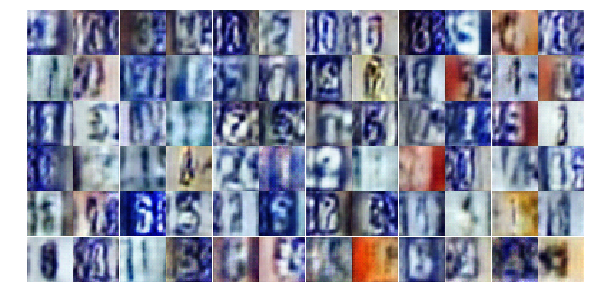

Epoch 5/25... Discriminator Loss: 1.9783... Generator Loss: 2.5835
Epoch 5/25... Discriminator Loss: 0.8078... Generator Loss: 0.9042
Epoch 5/25... Discriminator Loss: 0.6863... Generator Loss: 1.0682
Epoch 5/25... Discriminator Loss: 0.4723... Generator Loss: 1.5549
Epoch 5/25... Discriminator Loss: 1.0124... Generator Loss: 0.5822
Epoch 5/25... Discriminator Loss: 0.9313... Generator Loss: 0.6841
Epoch 6/25... Discriminator Loss: 0.7717... Generator Loss: 0.8452
Epoch 6/25... Discriminator Loss: 0.8624... Generator Loss: 2.8548
Epoch 6/25... Discriminator Loss: 0.4348... Generator Loss: 1.5172
Epoch 6/25... Discriminator Loss: 0.5442... Generator Loss: 1.8658


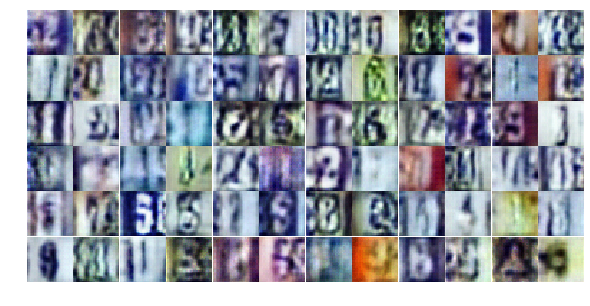

Epoch 6/25... Discriminator Loss: 1.0413... Generator Loss: 0.6446
Epoch 6/25... Discriminator Loss: 0.6284... Generator Loss: 1.0975
Epoch 6/25... Discriminator Loss: 0.3772... Generator Loss: 2.0932
Epoch 6/25... Discriminator Loss: 2.0555... Generator Loss: 0.1863
Epoch 6/25... Discriminator Loss: 0.8275... Generator Loss: 0.9268
Epoch 6/25... Discriminator Loss: 0.5777... Generator Loss: 1.2452
Epoch 6/25... Discriminator Loss: 0.6969... Generator Loss: 2.6330
Epoch 6/25... Discriminator Loss: 0.9678... Generator Loss: 0.6337
Epoch 6/25... Discriminator Loss: 0.7229... Generator Loss: 0.9794
Epoch 6/25... Discriminator Loss: 0.7021... Generator Loss: 0.8922


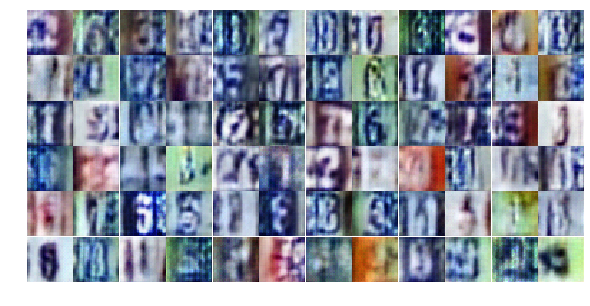

Epoch 6/25... Discriminator Loss: 0.5438... Generator Loss: 1.1931
Epoch 6/25... Discriminator Loss: 1.3561... Generator Loss: 0.5784
Epoch 6/25... Discriminator Loss: 1.1417... Generator Loss: 0.5125
Epoch 6/25... Discriminator Loss: 0.5842... Generator Loss: 1.2392
Epoch 6/25... Discriminator Loss: 0.4040... Generator Loss: 1.9421
Epoch 6/25... Discriminator Loss: 0.6436... Generator Loss: 1.0987
Epoch 6/25... Discriminator Loss: 0.4948... Generator Loss: 1.6109
Epoch 6/25... Discriminator Loss: 0.6130... Generator Loss: 1.0959
Epoch 6/25... Discriminator Loss: 0.4881... Generator Loss: 2.2252
Epoch 6/25... Discriminator Loss: 0.6369... Generator Loss: 1.2073


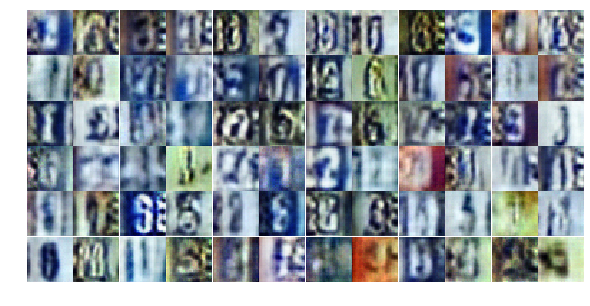

Epoch 6/25... Discriminator Loss: 0.7586... Generator Loss: 0.8197
Epoch 6/25... Discriminator Loss: 0.8517... Generator Loss: 0.7866
Epoch 6/25... Discriminator Loss: 1.1052... Generator Loss: 1.0519
Epoch 6/25... Discriminator Loss: 0.8554... Generator Loss: 0.7114
Epoch 6/25... Discriminator Loss: 0.6361... Generator Loss: 1.2420
Epoch 6/25... Discriminator Loss: 0.9832... Generator Loss: 0.7308
Epoch 6/25... Discriminator Loss: 0.6202... Generator Loss: 1.1404
Epoch 6/25... Discriminator Loss: 0.3451... Generator Loss: 1.6507
Epoch 6/25... Discriminator Loss: 0.4600... Generator Loss: 2.0920
Epoch 6/25... Discriminator Loss: 0.4578... Generator Loss: 1.7502


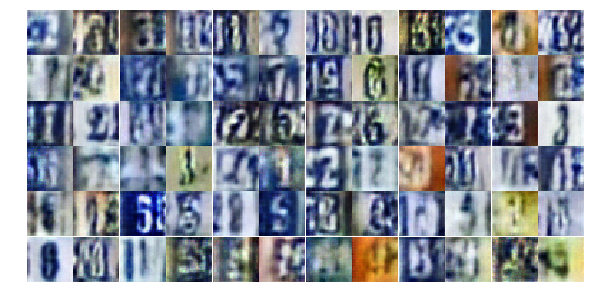

Epoch 6/25... Discriminator Loss: 0.7239... Generator Loss: 0.9718
Epoch 6/25... Discriminator Loss: 0.6303... Generator Loss: 1.6247
Epoch 6/25... Discriminator Loss: 0.6552... Generator Loss: 1.1319
Epoch 6/25... Discriminator Loss: 1.0659... Generator Loss: 0.5616
Epoch 6/25... Discriminator Loss: 0.5242... Generator Loss: 1.3710
Epoch 6/25... Discriminator Loss: 0.5748... Generator Loss: 1.2824
Epoch 6/25... Discriminator Loss: 0.3672... Generator Loss: 1.7248
Epoch 6/25... Discriminator Loss: 0.4391... Generator Loss: 1.7241
Epoch 6/25... Discriminator Loss: 0.8128... Generator Loss: 0.8487
Epoch 6/25... Discriminator Loss: 0.5238... Generator Loss: 1.1676


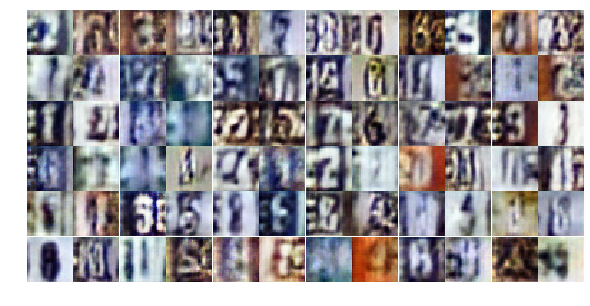

Epoch 6/25... Discriminator Loss: 1.0264... Generator Loss: 1.7445
Epoch 6/25... Discriminator Loss: 0.9310... Generator Loss: 0.8139
Epoch 6/25... Discriminator Loss: 1.3351... Generator Loss: 0.4660
Epoch 6/25... Discriminator Loss: 0.4991... Generator Loss: 1.4981
Epoch 6/25... Discriminator Loss: 0.4932... Generator Loss: 2.6303
Epoch 6/25... Discriminator Loss: 0.4634... Generator Loss: 1.3018
Epoch 6/25... Discriminator Loss: 0.7992... Generator Loss: 0.8338
Epoch 6/25... Discriminator Loss: 1.4664... Generator Loss: 0.3585
Epoch 6/25... Discriminator Loss: 0.7743... Generator Loss: 0.9051
Epoch 6/25... Discriminator Loss: 1.9846... Generator Loss: 0.2564


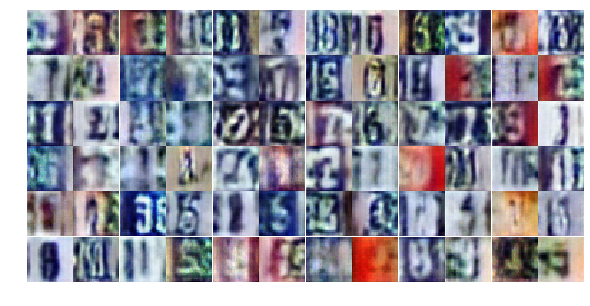

Epoch 6/25... Discriminator Loss: 0.6170... Generator Loss: 1.9317
Epoch 6/25... Discriminator Loss: 0.5514... Generator Loss: 1.2146
Epoch 6/25... Discriminator Loss: 0.4702... Generator Loss: 1.7455
Epoch 7/25... Discriminator Loss: 0.5380... Generator Loss: 1.4464
Epoch 7/25... Discriminator Loss: 0.5796... Generator Loss: 1.5721
Epoch 7/25... Discriminator Loss: 0.3539... Generator Loss: 2.3276
Epoch 7/25... Discriminator Loss: 0.5110... Generator Loss: 1.2208
Epoch 7/25... Discriminator Loss: 0.7100... Generator Loss: 1.0228
Epoch 7/25... Discriminator Loss: 0.4572... Generator Loss: 1.4359
Epoch 7/25... Discriminator Loss: 0.5315... Generator Loss: 1.2623


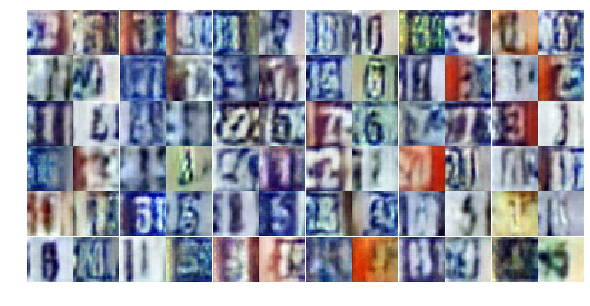

Epoch 7/25... Discriminator Loss: 0.3865... Generator Loss: 1.6208
Epoch 7/25... Discriminator Loss: 0.6246... Generator Loss: 1.0980
Epoch 7/25... Discriminator Loss: 1.2912... Generator Loss: 0.4364
Epoch 7/25... Discriminator Loss: 0.4458... Generator Loss: 1.7308
Epoch 7/25... Discriminator Loss: 0.5462... Generator Loss: 1.3909
Epoch 7/25... Discriminator Loss: 0.4563... Generator Loss: 1.3018
Epoch 7/25... Discriminator Loss: 0.6855... Generator Loss: 2.5782
Epoch 7/25... Discriminator Loss: 1.0800... Generator Loss: 3.8853
Epoch 7/25... Discriminator Loss: 0.6829... Generator Loss: 2.6812
Epoch 7/25... Discriminator Loss: 0.7321... Generator Loss: 1.9686


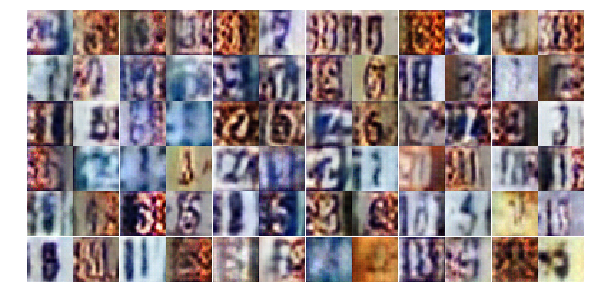

Epoch 7/25... Discriminator Loss: 1.3666... Generator Loss: 0.4059
Epoch 7/25... Discriminator Loss: 0.5994... Generator Loss: 1.7908
Epoch 7/25... Discriminator Loss: 0.7133... Generator Loss: 0.9693
Epoch 7/25... Discriminator Loss: 0.5070... Generator Loss: 1.7082
Epoch 7/25... Discriminator Loss: 0.5089... Generator Loss: 1.2648
Epoch 7/25... Discriminator Loss: 0.5274... Generator Loss: 1.3278
Epoch 7/25... Discriminator Loss: 0.8307... Generator Loss: 0.8698
Epoch 7/25... Discriminator Loss: 1.1646... Generator Loss: 0.5218
Epoch 7/25... Discriminator Loss: 0.4825... Generator Loss: 1.4789
Epoch 7/25... Discriminator Loss: 0.3970... Generator Loss: 1.8912


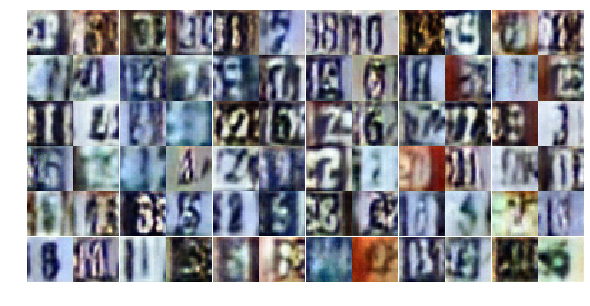

Epoch 7/25... Discriminator Loss: 0.6612... Generator Loss: 1.0599
Epoch 7/25... Discriminator Loss: 1.2784... Generator Loss: 0.4567
Epoch 7/25... Discriminator Loss: 0.7206... Generator Loss: 1.0850
Epoch 7/25... Discriminator Loss: 0.5316... Generator Loss: 1.3315
Epoch 7/25... Discriminator Loss: 0.5229... Generator Loss: 1.4863
Epoch 7/25... Discriminator Loss: 0.7826... Generator Loss: 0.9063
Epoch 7/25... Discriminator Loss: 0.3923... Generator Loss: 1.7010
Epoch 7/25... Discriminator Loss: 0.4922... Generator Loss: 1.6331
Epoch 7/25... Discriminator Loss: 0.7586... Generator Loss: 0.8667
Epoch 7/25... Discriminator Loss: 0.5158... Generator Loss: 2.8969


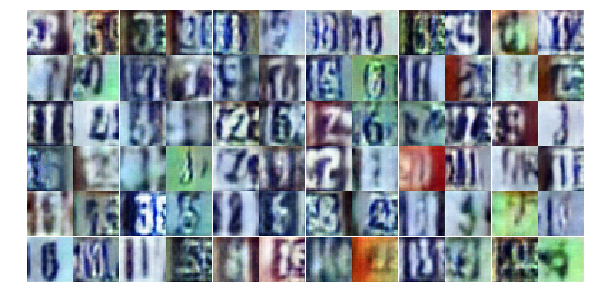

Epoch 7/25... Discriminator Loss: 0.8195... Generator Loss: 0.7974
Epoch 7/25... Discriminator Loss: 0.5723... Generator Loss: 2.1448
Epoch 7/25... Discriminator Loss: 0.4304... Generator Loss: 1.6897
Epoch 7/25... Discriminator Loss: 0.6423... Generator Loss: 1.0980
Epoch 7/25... Discriminator Loss: 0.6310... Generator Loss: 1.0197
Epoch 7/25... Discriminator Loss: 0.2799... Generator Loss: 1.9751
Epoch 7/25... Discriminator Loss: 0.4773... Generator Loss: 2.7993
Epoch 7/25... Discriminator Loss: 0.6705... Generator Loss: 1.1291
Epoch 7/25... Discriminator Loss: 0.3661... Generator Loss: 2.5909
Epoch 7/25... Discriminator Loss: 0.8651... Generator Loss: 1.8478


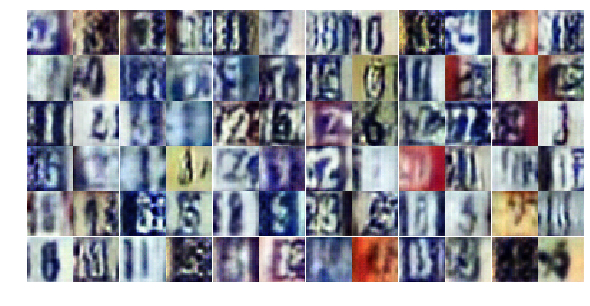

Epoch 7/25... Discriminator Loss: 0.5545... Generator Loss: 1.5223
Epoch 7/25... Discriminator Loss: 0.8019... Generator Loss: 0.8724
Epoch 7/25... Discriminator Loss: 0.6758... Generator Loss: 1.1464
Epoch 7/25... Discriminator Loss: 0.4961... Generator Loss: 1.2192
Epoch 7/25... Discriminator Loss: 0.6273... Generator Loss: 1.0705
Epoch 7/25... Discriminator Loss: 0.8711... Generator Loss: 0.7911
Epoch 7/25... Discriminator Loss: 1.5537... Generator Loss: 0.3434
Epoch 7/25... Discriminator Loss: 0.5076... Generator Loss: 1.4797
Epoch 7/25... Discriminator Loss: 0.9237... Generator Loss: 0.7223
Epoch 7/25... Discriminator Loss: 0.3767... Generator Loss: 1.5661


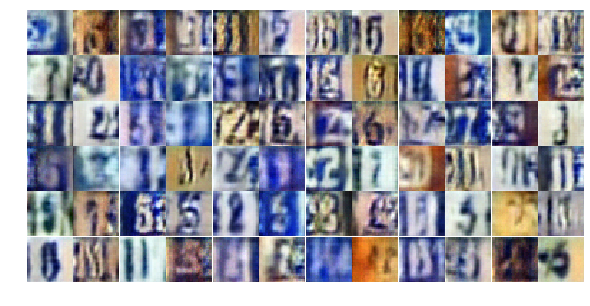

Epoch 7/25... Discriminator Loss: 0.3496... Generator Loss: 1.6354
Epoch 8/25... Discriminator Loss: 0.5456... Generator Loss: 1.2426
Epoch 8/25... Discriminator Loss: 0.9798... Generator Loss: 0.6010
Epoch 8/25... Discriminator Loss: 0.6408... Generator Loss: 1.1051
Epoch 8/25... Discriminator Loss: 0.4403... Generator Loss: 1.5161
Epoch 8/25... Discriminator Loss: 0.5865... Generator Loss: 1.2530
Epoch 8/25... Discriminator Loss: 1.4369... Generator Loss: 0.4790
Epoch 8/25... Discriminator Loss: 0.4114... Generator Loss: 2.0498
Epoch 8/25... Discriminator Loss: 1.1737... Generator Loss: 0.4711
Epoch 8/25... Discriminator Loss: 0.5131... Generator Loss: 1.2878


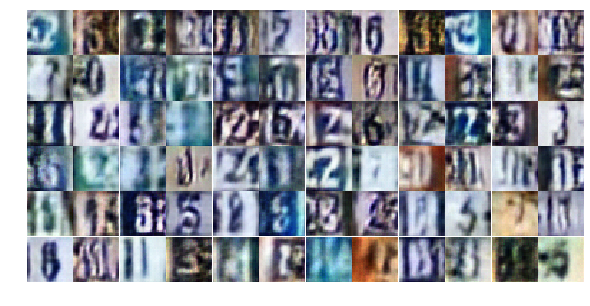

Epoch 8/25... Discriminator Loss: 0.5371... Generator Loss: 1.2609
Epoch 8/25... Discriminator Loss: 0.4092... Generator Loss: 1.7566
Epoch 8/25... Discriminator Loss: 1.4184... Generator Loss: 0.3834
Epoch 8/25... Discriminator Loss: 1.2430... Generator Loss: 3.2224
Epoch 8/25... Discriminator Loss: 0.9465... Generator Loss: 0.8426
Epoch 8/25... Discriminator Loss: 0.6812... Generator Loss: 1.9550
Epoch 8/25... Discriminator Loss: 0.4594... Generator Loss: 1.6343
Epoch 8/25... Discriminator Loss: 0.5355... Generator Loss: 1.3468
Epoch 8/25... Discriminator Loss: 0.6430... Generator Loss: 1.1257
Epoch 8/25... Discriminator Loss: 1.3033... Generator Loss: 0.4781


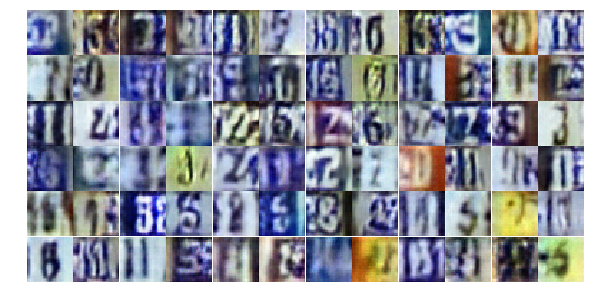

Epoch 8/25... Discriminator Loss: 0.3646... Generator Loss: 1.9946
Epoch 8/25... Discriminator Loss: 0.4683... Generator Loss: 1.3853
Epoch 8/25... Discriminator Loss: 0.7380... Generator Loss: 0.9308
Epoch 8/25... Discriminator Loss: 0.8199... Generator Loss: 1.0487
Epoch 8/25... Discriminator Loss: 0.3920... Generator Loss: 1.6511
Epoch 8/25... Discriminator Loss: 0.5051... Generator Loss: 1.5279
Epoch 8/25... Discriminator Loss: 0.6635... Generator Loss: 1.3921
Epoch 8/25... Discriminator Loss: 0.5027... Generator Loss: 1.2394
Epoch 8/25... Discriminator Loss: 0.9399... Generator Loss: 2.5641
Epoch 8/25... Discriminator Loss: 0.7679... Generator Loss: 1.7726


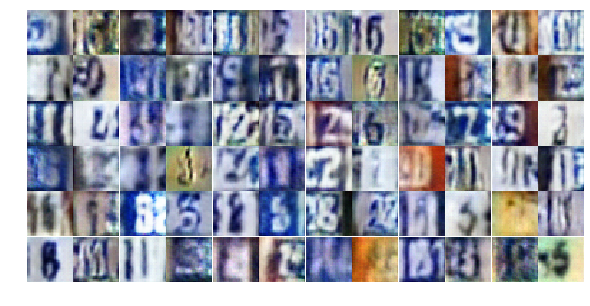

Epoch 8/25... Discriminator Loss: 0.7676... Generator Loss: 2.0128
Epoch 8/25... Discriminator Loss: 0.9060... Generator Loss: 0.7590
Epoch 8/25... Discriminator Loss: 0.6197... Generator Loss: 1.3672
Epoch 8/25... Discriminator Loss: 0.6936... Generator Loss: 0.9855
Epoch 8/25... Discriminator Loss: 0.5930... Generator Loss: 1.1743
Epoch 8/25... Discriminator Loss: 0.4135... Generator Loss: 1.5542
Epoch 8/25... Discriminator Loss: 0.5947... Generator Loss: 1.7872
Epoch 8/25... Discriminator Loss: 0.6057... Generator Loss: 1.1304
Epoch 8/25... Discriminator Loss: 0.6551... Generator Loss: 1.1240
Epoch 8/25... Discriminator Loss: 0.5152... Generator Loss: 1.3162


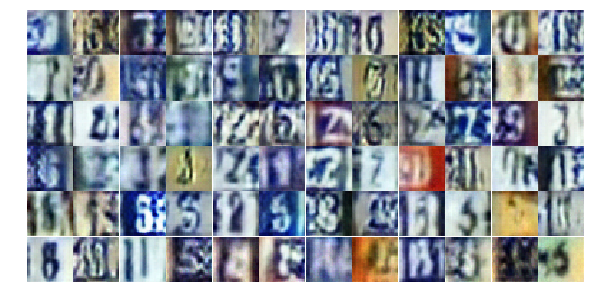

Epoch 8/25... Discriminator Loss: 0.4875... Generator Loss: 1.7681
Epoch 8/25... Discriminator Loss: 0.9148... Generator Loss: 0.6673
Epoch 8/25... Discriminator Loss: 0.5676... Generator Loss: 1.1297
Epoch 8/25... Discriminator Loss: 0.5566... Generator Loss: 1.1965
Epoch 8/25... Discriminator Loss: 0.7012... Generator Loss: 0.9918
Epoch 8/25... Discriminator Loss: 0.4423... Generator Loss: 1.4732
Epoch 8/25... Discriminator Loss: 1.2287... Generator Loss: 0.6145
Epoch 8/25... Discriminator Loss: 0.6707... Generator Loss: 1.9450
Epoch 8/25... Discriminator Loss: 0.9114... Generator Loss: 0.7544
Epoch 8/25... Discriminator Loss: 0.7230... Generator Loss: 1.0513


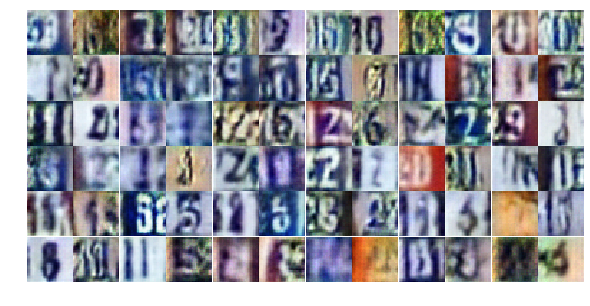

Epoch 8/25... Discriminator Loss: 0.7138... Generator Loss: 0.9227
Epoch 8/25... Discriminator Loss: 0.5486... Generator Loss: 1.2137
Epoch 8/25... Discriminator Loss: 0.3622... Generator Loss: 2.0889
Epoch 8/25... Discriminator Loss: 0.8713... Generator Loss: 0.7702
Epoch 8/25... Discriminator Loss: 0.5166... Generator Loss: 1.6347
Epoch 8/25... Discriminator Loss: 0.9384... Generator Loss: 0.6681
Epoch 8/25... Discriminator Loss: 0.6835... Generator Loss: 0.9924
Epoch 8/25... Discriminator Loss: 0.7623... Generator Loss: 3.1287
Epoch 9/25... Discriminator Loss: 0.8409... Generator Loss: 0.8726
Epoch 9/25... Discriminator Loss: 0.7128... Generator Loss: 0.9567


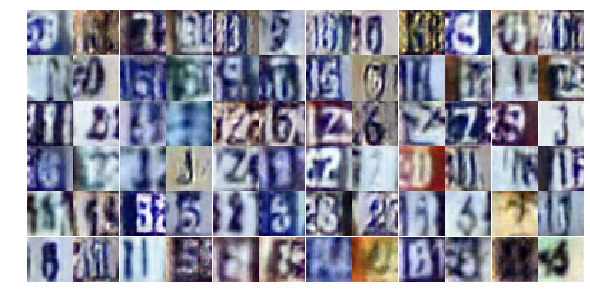

Epoch 9/25... Discriminator Loss: 0.9357... Generator Loss: 0.7136
Epoch 9/25... Discriminator Loss: 0.5980... Generator Loss: 2.1683
Epoch 9/25... Discriminator Loss: 1.2253... Generator Loss: 0.5322
Epoch 9/25... Discriminator Loss: 0.4773... Generator Loss: 1.4812
Epoch 9/25... Discriminator Loss: 1.1021... Generator Loss: 0.5358
Epoch 9/25... Discriminator Loss: 0.9501... Generator Loss: 2.9809
Epoch 9/25... Discriminator Loss: 0.9896... Generator Loss: 0.7163
Epoch 9/25... Discriminator Loss: 0.5290... Generator Loss: 1.2937
Epoch 9/25... Discriminator Loss: 0.8079... Generator Loss: 0.8015
Epoch 9/25... Discriminator Loss: 0.4841... Generator Loss: 1.6164


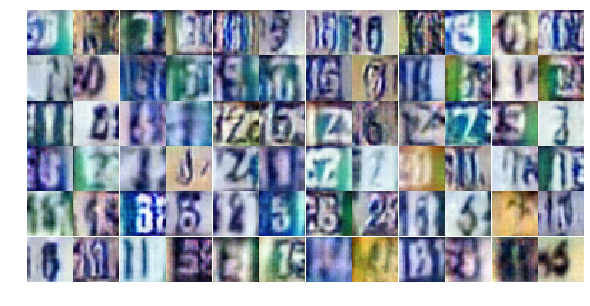

Epoch 9/25... Discriminator Loss: 1.0615... Generator Loss: 0.5749
Epoch 9/25... Discriminator Loss: 1.4439... Generator Loss: 0.4674
Epoch 9/25... Discriminator Loss: 0.6550... Generator Loss: 1.3531
Epoch 9/25... Discriminator Loss: 0.7893... Generator Loss: 0.8931
Epoch 9/25... Discriminator Loss: 0.4915... Generator Loss: 1.4332
Epoch 9/25... Discriminator Loss: 0.9018... Generator Loss: 0.7371
Epoch 9/25... Discriminator Loss: 0.8085... Generator Loss: 0.8536
Epoch 9/25... Discriminator Loss: 0.3685... Generator Loss: 1.7245
Epoch 9/25... Discriminator Loss: 0.9424... Generator Loss: 0.7588
Epoch 9/25... Discriminator Loss: 1.1070... Generator Loss: 0.5360


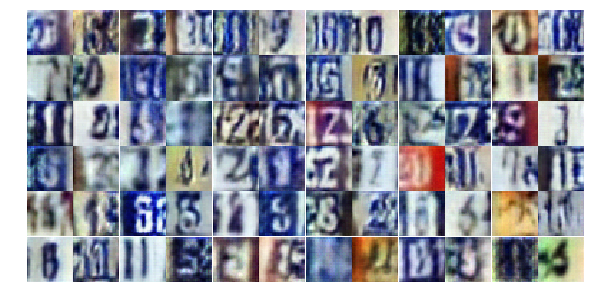

Epoch 9/25... Discriminator Loss: 0.6533... Generator Loss: 1.0375
Epoch 9/25... Discriminator Loss: 0.7533... Generator Loss: 0.8639
Epoch 9/25... Discriminator Loss: 0.6530... Generator Loss: 1.0224
Epoch 9/25... Discriminator Loss: 0.4242... Generator Loss: 1.5122
Epoch 9/25... Discriminator Loss: 0.4082... Generator Loss: 1.5545
Epoch 9/25... Discriminator Loss: 0.6580... Generator Loss: 2.0013
Epoch 9/25... Discriminator Loss: 0.6283... Generator Loss: 1.2896
Epoch 9/25... Discriminator Loss: 0.4955... Generator Loss: 2.4247
Epoch 9/25... Discriminator Loss: 0.5068... Generator Loss: 1.3962
Epoch 9/25... Discriminator Loss: 0.4870... Generator Loss: 1.3343


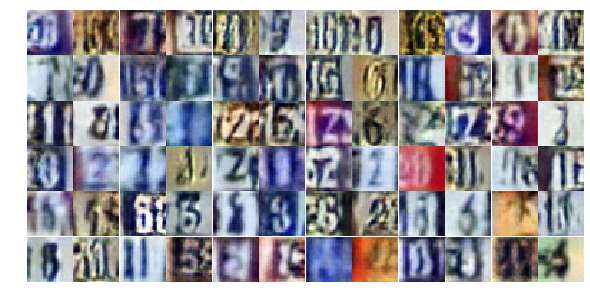

Epoch 9/25... Discriminator Loss: 0.5551... Generator Loss: 1.2206
Epoch 9/25... Discriminator Loss: 0.6043... Generator Loss: 1.1699
Epoch 9/25... Discriminator Loss: 1.0199... Generator Loss: 0.6564
Epoch 9/25... Discriminator Loss: 0.3915... Generator Loss: 1.8646
Epoch 9/25... Discriminator Loss: 0.6846... Generator Loss: 0.9905
Epoch 9/25... Discriminator Loss: 0.5697... Generator Loss: 1.8310
Epoch 9/25... Discriminator Loss: 0.5641... Generator Loss: 1.4625
Epoch 9/25... Discriminator Loss: 0.4275... Generator Loss: 1.3640
Epoch 9/25... Discriminator Loss: 0.8307... Generator Loss: 0.7259
Epoch 9/25... Discriminator Loss: 0.5019... Generator Loss: 1.3087


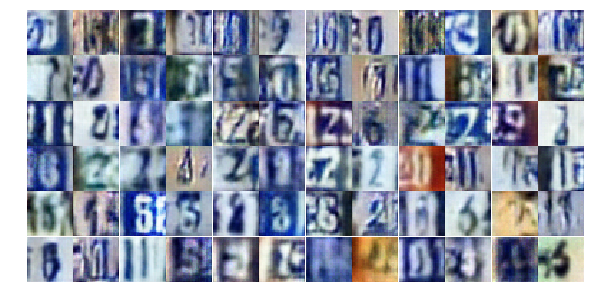

Epoch 9/25... Discriminator Loss: 0.3377... Generator Loss: 2.0346
Epoch 9/25... Discriminator Loss: 0.4479... Generator Loss: 1.5656
Epoch 9/25... Discriminator Loss: 1.8255... Generator Loss: 0.2785
Epoch 9/25... Discriminator Loss: 0.9348... Generator Loss: 1.3352
Epoch 9/25... Discriminator Loss: 0.4567... Generator Loss: 1.7366
Epoch 9/25... Discriminator Loss: 0.6679... Generator Loss: 1.0877
Epoch 9/25... Discriminator Loss: 0.8648... Generator Loss: 0.8147
Epoch 9/25... Discriminator Loss: 0.5524... Generator Loss: 1.3638
Epoch 9/25... Discriminator Loss: 0.4955... Generator Loss: 1.5300
Epoch 9/25... Discriminator Loss: 0.6234... Generator Loss: 2.1492


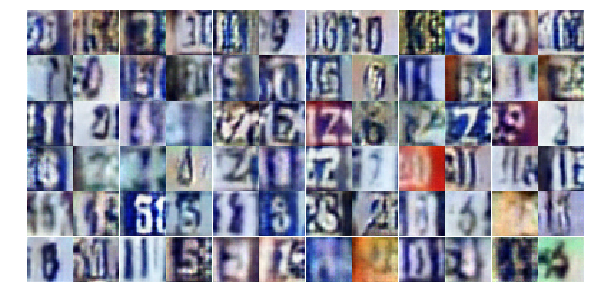

Epoch 9/25... Discriminator Loss: 0.6505... Generator Loss: 1.1089
Epoch 9/25... Discriminator Loss: 0.6303... Generator Loss: 2.3046
Epoch 9/25... Discriminator Loss: 0.5535... Generator Loss: 1.3250
Epoch 9/25... Discriminator Loss: 0.9163... Generator Loss: 0.7012
Epoch 9/25... Discriminator Loss: 0.8019... Generator Loss: 1.8546
Epoch 10/25... Discriminator Loss: 0.5103... Generator Loss: 1.5200
Epoch 10/25... Discriminator Loss: 0.4951... Generator Loss: 1.3739
Epoch 10/25... Discriminator Loss: 0.5991... Generator Loss: 1.1615
Epoch 10/25... Discriminator Loss: 0.9262... Generator Loss: 0.7605
Epoch 10/25... Discriminator Loss: 1.0688... Generator Loss: 0.5702


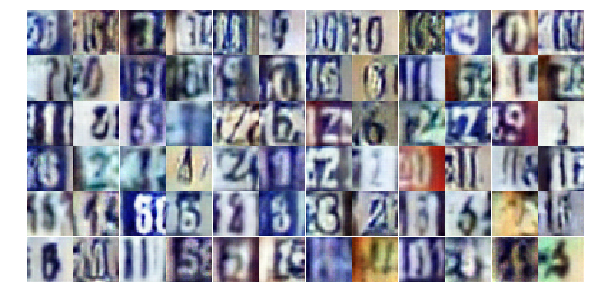

Epoch 10/25... Discriminator Loss: 0.9016... Generator Loss: 0.7000
Epoch 10/25... Discriminator Loss: 0.6282... Generator Loss: 1.1020
Epoch 10/25... Discriminator Loss: 0.7267... Generator Loss: 1.5350
Epoch 10/25... Discriminator Loss: 0.7492... Generator Loss: 2.0541
Epoch 10/25... Discriminator Loss: 0.6119... Generator Loss: 1.2575
Epoch 10/25... Discriminator Loss: 0.5657... Generator Loss: 1.2854
Epoch 10/25... Discriminator Loss: 0.5635... Generator Loss: 1.1738
Epoch 10/25... Discriminator Loss: 0.9803... Generator Loss: 0.5814
Epoch 10/25... Discriminator Loss: 1.5402... Generator Loss: 0.3917
Epoch 10/25... Discriminator Loss: 0.9709... Generator Loss: 0.6876


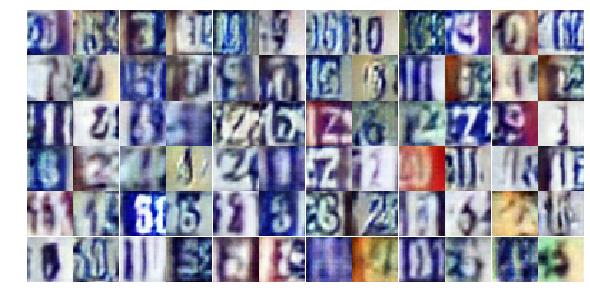

Epoch 10/25... Discriminator Loss: 0.7047... Generator Loss: 1.2343
Epoch 10/25... Discriminator Loss: 0.8892... Generator Loss: 0.7719
Epoch 10/25... Discriminator Loss: 0.6649... Generator Loss: 1.0709
Epoch 10/25... Discriminator Loss: 1.1939... Generator Loss: 0.5240
Epoch 10/25... Discriminator Loss: 0.5836... Generator Loss: 1.2695
Epoch 10/25... Discriminator Loss: 0.6448... Generator Loss: 1.0845
Epoch 10/25... Discriminator Loss: 0.7550... Generator Loss: 0.9204
Epoch 10/25... Discriminator Loss: 0.4144... Generator Loss: 1.4754
Epoch 10/25... Discriminator Loss: 0.6922... Generator Loss: 1.0453
Epoch 10/25... Discriminator Loss: 0.4198... Generator Loss: 3.3669


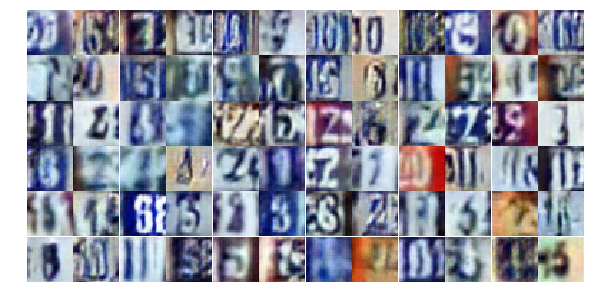

Epoch 10/25... Discriminator Loss: 0.8386... Generator Loss: 0.8152
Epoch 10/25... Discriminator Loss: 0.7226... Generator Loss: 0.8894
Epoch 10/25... Discriminator Loss: 0.3661... Generator Loss: 2.4176
Epoch 10/25... Discriminator Loss: 0.5220... Generator Loss: 2.6953
Epoch 10/25... Discriminator Loss: 0.7345... Generator Loss: 0.9832
Epoch 10/25... Discriminator Loss: 0.6005... Generator Loss: 1.3000
Epoch 10/25... Discriminator Loss: 0.2295... Generator Loss: 2.1682
Epoch 10/25... Discriminator Loss: 0.8009... Generator Loss: 0.8390
Epoch 10/25... Discriminator Loss: 0.6686... Generator Loss: 1.0213
Epoch 10/25... Discriminator Loss: 0.5447... Generator Loss: 1.2276


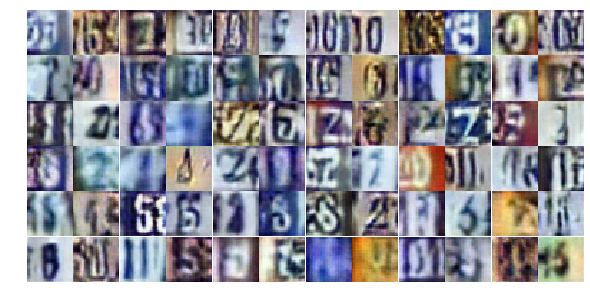

Epoch 10/25... Discriminator Loss: 0.4536... Generator Loss: 2.1974
Epoch 10/25... Discriminator Loss: 1.2299... Generator Loss: 0.5023
Epoch 10/25... Discriminator Loss: 0.6174... Generator Loss: 1.4025
Epoch 10/25... Discriminator Loss: 0.5474... Generator Loss: 1.3141
Epoch 10/25... Discriminator Loss: 1.0458... Generator Loss: 0.5989
Epoch 10/25... Discriminator Loss: 1.2189... Generator Loss: 0.4601
Epoch 10/25... Discriminator Loss: 0.7793... Generator Loss: 0.8297
Epoch 10/25... Discriminator Loss: 1.0750... Generator Loss: 0.6442
Epoch 10/25... Discriminator Loss: 0.6508... Generator Loss: 1.1078
Epoch 10/25... Discriminator Loss: 0.4668... Generator Loss: 1.5156


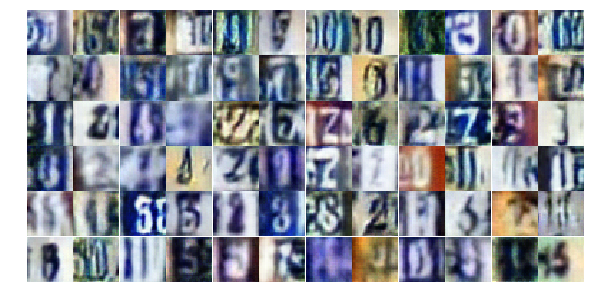

Epoch 10/25... Discriminator Loss: 1.2355... Generator Loss: 0.5316
Epoch 10/25... Discriminator Loss: 0.7948... Generator Loss: 0.9156
Epoch 10/25... Discriminator Loss: 0.8147... Generator Loss: 0.9273
Epoch 10/25... Discriminator Loss: 1.1064... Generator Loss: 0.5588
Epoch 10/25... Discriminator Loss: 0.4244... Generator Loss: 1.6151
Epoch 10/25... Discriminator Loss: 0.7715... Generator Loss: 1.3098
Epoch 10/25... Discriminator Loss: 0.5839... Generator Loss: 1.1729
Epoch 10/25... Discriminator Loss: 0.3967... Generator Loss: 1.5861
Epoch 10/25... Discriminator Loss: 0.5837... Generator Loss: 2.1760
Epoch 10/25... Discriminator Loss: 0.3669... Generator Loss: 1.8241


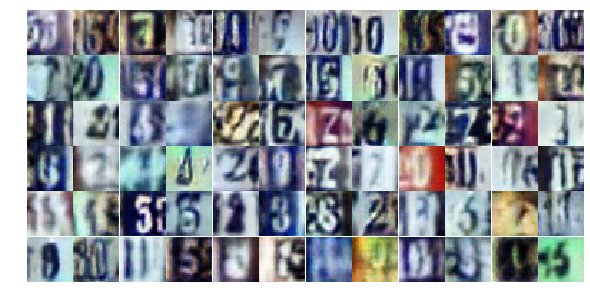

Epoch 10/25... Discriminator Loss: 1.1475... Generator Loss: 0.5065
Epoch 10/25... Discriminator Loss: 0.5268... Generator Loss: 1.3559
Epoch 10/25... Discriminator Loss: 0.7123... Generator Loss: 0.8755
Epoch 11/25... Discriminator Loss: 0.8019... Generator Loss: 1.0422
Epoch 11/25... Discriminator Loss: 0.6248... Generator Loss: 1.1416
Epoch 11/25... Discriminator Loss: 1.0488... Generator Loss: 0.6258
Epoch 11/25... Discriminator Loss: 0.5230... Generator Loss: 1.2781
Epoch 11/25... Discriminator Loss: 0.7779... Generator Loss: 1.0013
Epoch 11/25... Discriminator Loss: 0.6974... Generator Loss: 1.6429
Epoch 11/25... Discriminator Loss: 0.5566... Generator Loss: 1.4992


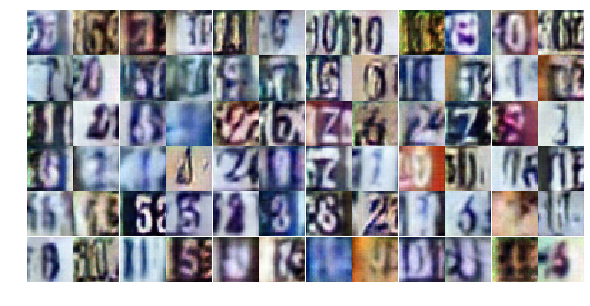

Epoch 11/25... Discriminator Loss: 0.3521... Generator Loss: 1.6698
Epoch 11/25... Discriminator Loss: 0.7472... Generator Loss: 1.1476
Epoch 11/25... Discriminator Loss: 0.4382... Generator Loss: 1.5379
Epoch 11/25... Discriminator Loss: 0.5076... Generator Loss: 1.4193
Epoch 11/25... Discriminator Loss: 1.2636... Generator Loss: 0.4456
Epoch 11/25... Discriminator Loss: 0.4412... Generator Loss: 2.0272
Epoch 11/25... Discriminator Loss: 0.8466... Generator Loss: 0.9801
Epoch 11/25... Discriminator Loss: 0.4210... Generator Loss: 1.9436
Epoch 11/25... Discriminator Loss: 0.9683... Generator Loss: 0.6648
Epoch 11/25... Discriminator Loss: 1.5285... Generator Loss: 0.3128


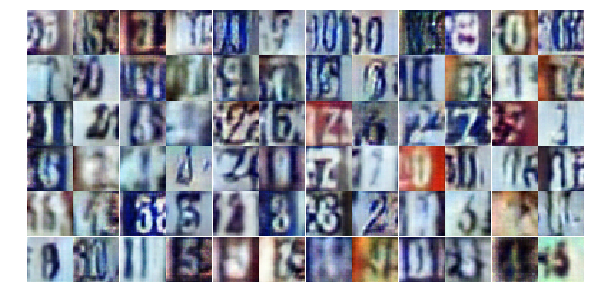

Epoch 11/25... Discriminator Loss: 1.0377... Generator Loss: 0.6316
Epoch 11/25... Discriminator Loss: 0.4823... Generator Loss: 1.4165
Epoch 11/25... Discriminator Loss: 0.6851... Generator Loss: 0.9382
Epoch 11/25... Discriminator Loss: 0.7735... Generator Loss: 0.8589
Epoch 11/25... Discriminator Loss: 0.4392... Generator Loss: 1.9110
Epoch 11/25... Discriminator Loss: 0.5652... Generator Loss: 1.2548
Epoch 11/25... Discriminator Loss: 0.6438... Generator Loss: 1.1462
Epoch 11/25... Discriminator Loss: 0.9373... Generator Loss: 0.7961
Epoch 11/25... Discriminator Loss: 0.4361... Generator Loss: 1.8065
Epoch 11/25... Discriminator Loss: 0.9410... Generator Loss: 0.7293


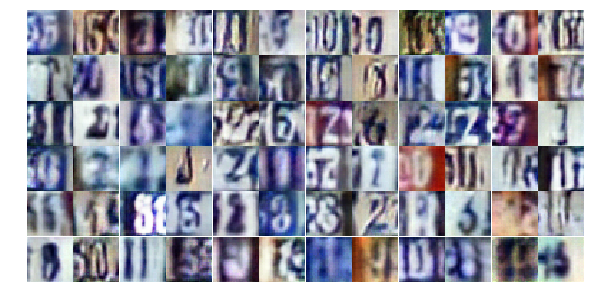

Epoch 11/25... Discriminator Loss: 1.0185... Generator Loss: 0.6690
Epoch 11/25... Discriminator Loss: 0.5845... Generator Loss: 1.1936
Epoch 11/25... Discriminator Loss: 0.7256... Generator Loss: 1.1177
Epoch 11/25... Discriminator Loss: 0.5023... Generator Loss: 1.2121
Epoch 11/25... Discriminator Loss: 0.8060... Generator Loss: 0.8406
Epoch 11/25... Discriminator Loss: 0.9001... Generator Loss: 0.8261
Epoch 11/25... Discriminator Loss: 0.7018... Generator Loss: 1.1502
Epoch 11/25... Discriminator Loss: 1.1753... Generator Loss: 0.4728
Epoch 11/25... Discriminator Loss: 0.4335... Generator Loss: 1.4609
Epoch 11/25... Discriminator Loss: 1.0864... Generator Loss: 0.5700


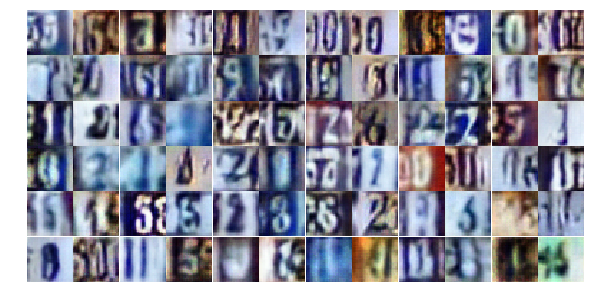

Epoch 11/25... Discriminator Loss: 0.3969... Generator Loss: 1.5819
Epoch 11/25... Discriminator Loss: 0.4046... Generator Loss: 1.6048
Epoch 11/25... Discriminator Loss: 0.7893... Generator Loss: 1.0572
Epoch 11/25... Discriminator Loss: 1.4972... Generator Loss: 0.3770
Epoch 11/25... Discriminator Loss: 1.2788... Generator Loss: 0.4311
Epoch 11/25... Discriminator Loss: 0.8709... Generator Loss: 0.7515
Epoch 11/25... Discriminator Loss: 0.4744... Generator Loss: 1.5496
Epoch 11/25... Discriminator Loss: 0.7699... Generator Loss: 2.0472
Epoch 11/25... Discriminator Loss: 1.1969... Generator Loss: 0.5429
Epoch 11/25... Discriminator Loss: 0.5306... Generator Loss: 1.6285


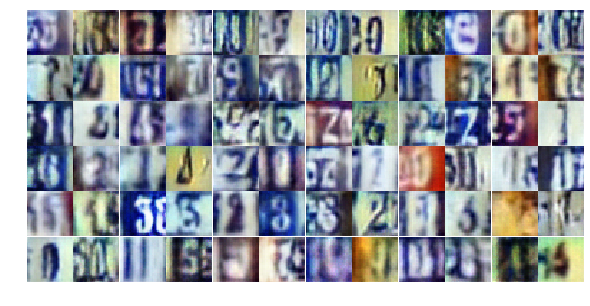

Epoch 11/25... Discriminator Loss: 0.8752... Generator Loss: 0.8408
Epoch 11/25... Discriminator Loss: 0.5227... Generator Loss: 1.3153
Epoch 11/25... Discriminator Loss: 0.6898... Generator Loss: 1.1571
Epoch 11/25... Discriminator Loss: 0.5517... Generator Loss: 1.1838
Epoch 11/25... Discriminator Loss: 1.2580... Generator Loss: 0.4783
Epoch 11/25... Discriminator Loss: 0.6989... Generator Loss: 1.0785
Epoch 11/25... Discriminator Loss: 0.8138... Generator Loss: 0.9141
Epoch 11/25... Discriminator Loss: 0.5111... Generator Loss: 1.9082
Epoch 11/25... Discriminator Loss: 0.6915... Generator Loss: 0.9837
Epoch 11/25... Discriminator Loss: 0.8686... Generator Loss: 0.8382


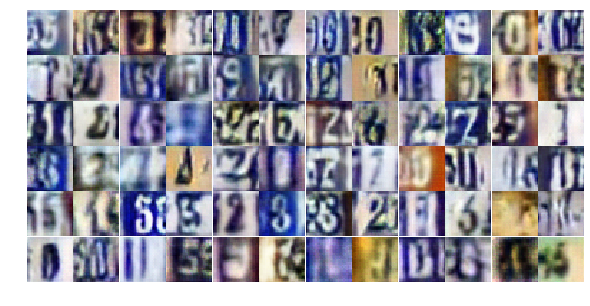

Epoch 12/25... Discriminator Loss: 0.6354... Generator Loss: 1.4993
Epoch 12/25... Discriminator Loss: 0.4919... Generator Loss: 1.6638
Epoch 12/25... Discriminator Loss: 1.2194... Generator Loss: 0.5226
Epoch 12/25... Discriminator Loss: 0.4718... Generator Loss: 1.5718
Epoch 12/25... Discriminator Loss: 0.4882... Generator Loss: 1.4263
Epoch 12/25... Discriminator Loss: 0.4340... Generator Loss: 1.3963
Epoch 12/25... Discriminator Loss: 0.6843... Generator Loss: 2.7835
Epoch 12/25... Discriminator Loss: 0.9192... Generator Loss: 0.8657
Epoch 12/25... Discriminator Loss: 0.6853... Generator Loss: 1.0512
Epoch 12/25... Discriminator Loss: 1.0075... Generator Loss: 0.8306


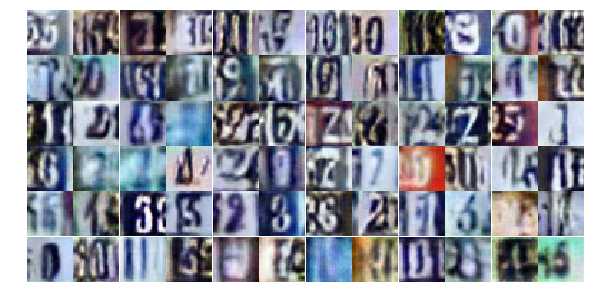

Epoch 12/25... Discriminator Loss: 0.5430... Generator Loss: 1.1602
Epoch 12/25... Discriminator Loss: 0.5541... Generator Loss: 1.2115
Epoch 12/25... Discriminator Loss: 0.4439... Generator Loss: 1.4663
Epoch 12/25... Discriminator Loss: 0.5130... Generator Loss: 1.3528
Epoch 12/25... Discriminator Loss: 0.3654... Generator Loss: 2.0145
Epoch 12/25... Discriminator Loss: 2.2012... Generator Loss: 0.1882
Epoch 12/25... Discriminator Loss: 1.8481... Generator Loss: 0.2418
Epoch 12/25... Discriminator Loss: 0.3698... Generator Loss: 1.9304
Epoch 12/25... Discriminator Loss: 0.7402... Generator Loss: 0.9058
Epoch 12/25... Discriminator Loss: 0.7899... Generator Loss: 0.9049


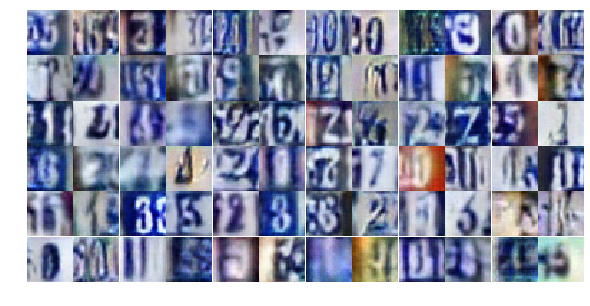

Epoch 12/25... Discriminator Loss: 0.2809... Generator Loss: 2.1389
Epoch 12/25... Discriminator Loss: 0.5052... Generator Loss: 1.3720
Epoch 12/25... Discriminator Loss: 0.5142... Generator Loss: 1.2827
Epoch 12/25... Discriminator Loss: 0.3236... Generator Loss: 1.9517
Epoch 12/25... Discriminator Loss: 0.3284... Generator Loss: 2.1812
Epoch 12/25... Discriminator Loss: 0.4304... Generator Loss: 1.7338
Epoch 12/25... Discriminator Loss: 0.9312... Generator Loss: 0.7119
Epoch 12/25... Discriminator Loss: 0.3570... Generator Loss: 1.7215
Epoch 12/25... Discriminator Loss: 0.5197... Generator Loss: 1.4318
Epoch 12/25... Discriminator Loss: 0.7658... Generator Loss: 0.8893


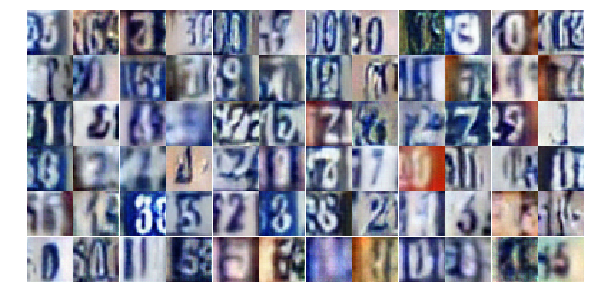

Epoch 12/25... Discriminator Loss: 0.8141... Generator Loss: 0.8247
Epoch 12/25... Discriminator Loss: 0.8054... Generator Loss: 0.8911
Epoch 12/25... Discriminator Loss: 0.7856... Generator Loss: 0.8502
Epoch 12/25... Discriminator Loss: 1.6741... Generator Loss: 0.2891
Epoch 12/25... Discriminator Loss: 0.6156... Generator Loss: 1.5509
Epoch 12/25... Discriminator Loss: 0.8484... Generator Loss: 0.8862
Epoch 12/25... Discriminator Loss: 1.3384... Generator Loss: 0.4114
Epoch 12/25... Discriminator Loss: 0.6451... Generator Loss: 1.3686
Epoch 12/25... Discriminator Loss: 0.5826... Generator Loss: 1.7116
Epoch 12/25... Discriminator Loss: 0.3187... Generator Loss: 1.7581


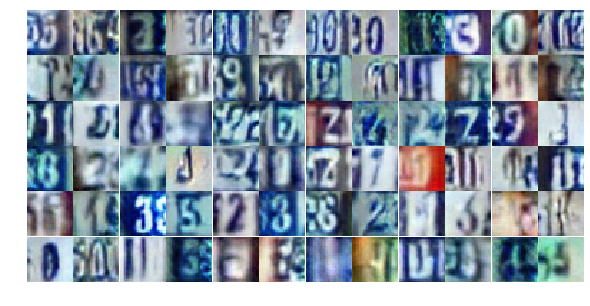

Epoch 12/25... Discriminator Loss: 0.6135... Generator Loss: 1.0560
Epoch 12/25... Discriminator Loss: 0.4026... Generator Loss: 1.8602
Epoch 12/25... Discriminator Loss: 0.4601... Generator Loss: 1.3281
Epoch 12/25... Discriminator Loss: 0.8167... Generator Loss: 1.0726
Epoch 12/25... Discriminator Loss: 0.8854... Generator Loss: 0.7626
Epoch 12/25... Discriminator Loss: 1.6371... Generator Loss: 0.3612
Epoch 12/25... Discriminator Loss: 0.9432... Generator Loss: 1.0089
Epoch 12/25... Discriminator Loss: 0.8397... Generator Loss: 0.8933
Epoch 12/25... Discriminator Loss: 0.4789... Generator Loss: 1.6871
Epoch 12/25... Discriminator Loss: 0.7621... Generator Loss: 0.8931


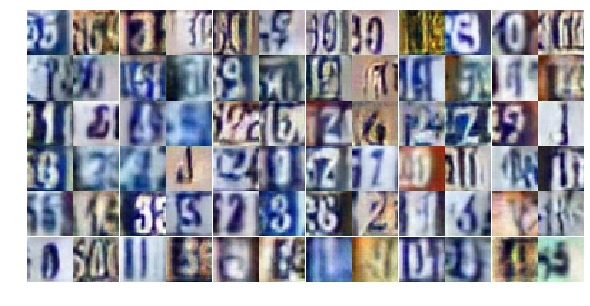

Epoch 12/25... Discriminator Loss: 0.7298... Generator Loss: 1.1279
Epoch 12/25... Discriminator Loss: 0.6500... Generator Loss: 1.1159
Epoch 12/25... Discriminator Loss: 0.5586... Generator Loss: 1.2194
Epoch 12/25... Discriminator Loss: 1.8299... Generator Loss: 0.2297
Epoch 12/25... Discriminator Loss: 0.5470... Generator Loss: 1.2662
Epoch 12/25... Discriminator Loss: 0.7497... Generator Loss: 2.2253
Epoch 12/25... Discriminator Loss: 0.9437... Generator Loss: 0.7507
Epoch 13/25... Discriminator Loss: 0.6035... Generator Loss: 1.1236
Epoch 13/25... Discriminator Loss: 0.3735... Generator Loss: 1.7047
Epoch 13/25... Discriminator Loss: 1.0258... Generator Loss: 0.6026


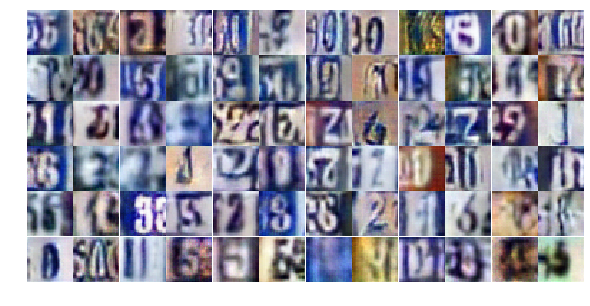

Epoch 13/25... Discriminator Loss: 0.7907... Generator Loss: 0.8773
Epoch 13/25... Discriminator Loss: 0.4724... Generator Loss: 2.1127
Epoch 13/25... Discriminator Loss: 0.9167... Generator Loss: 0.8277
Epoch 13/25... Discriminator Loss: 1.2364... Generator Loss: 0.4843
Epoch 13/25... Discriminator Loss: 0.5120... Generator Loss: 1.3242
Epoch 13/25... Discriminator Loss: 0.5456... Generator Loss: 1.2892
Epoch 13/25... Discriminator Loss: 0.4224... Generator Loss: 1.5186
Epoch 13/25... Discriminator Loss: 1.1386... Generator Loss: 0.5614
Epoch 13/25... Discriminator Loss: 0.6114... Generator Loss: 1.0965
Epoch 13/25... Discriminator Loss: 0.4383... Generator Loss: 2.2195


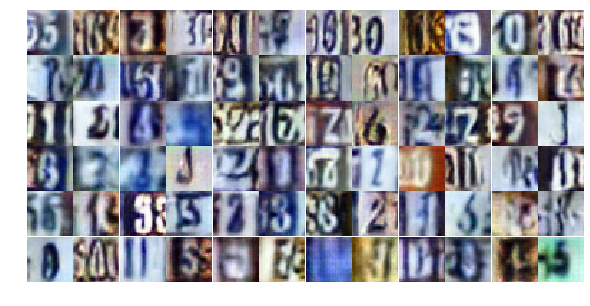

Epoch 13/25... Discriminator Loss: 3.2372... Generator Loss: 5.5749
Epoch 13/25... Discriminator Loss: 0.8435... Generator Loss: 0.9697
Epoch 13/25... Discriminator Loss: 0.9862... Generator Loss: 0.7944
Epoch 13/25... Discriminator Loss: 0.5680... Generator Loss: 1.3578
Epoch 13/25... Discriminator Loss: 0.8298... Generator Loss: 0.8901
Epoch 13/25... Discriminator Loss: 0.7910... Generator Loss: 1.0721
Epoch 13/25... Discriminator Loss: 0.7742... Generator Loss: 0.9309
Epoch 13/25... Discriminator Loss: 1.0772... Generator Loss: 0.5909
Epoch 13/25... Discriminator Loss: 0.7816... Generator Loss: 0.8716
Epoch 13/25... Discriminator Loss: 1.1053... Generator Loss: 0.5532


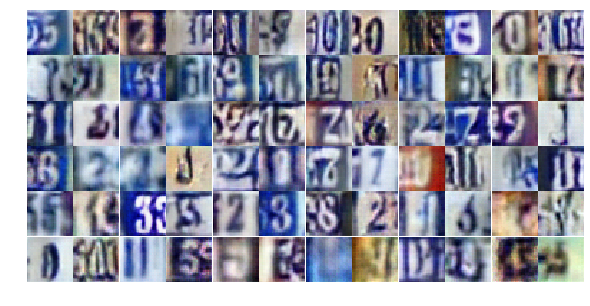

Epoch 13/25... Discriminator Loss: 0.7587... Generator Loss: 0.8859
Epoch 13/25... Discriminator Loss: 0.9230... Generator Loss: 0.8241
Epoch 13/25... Discriminator Loss: 0.5778... Generator Loss: 2.2047
Epoch 13/25... Discriminator Loss: 0.9469... Generator Loss: 0.7089
Epoch 13/25... Discriminator Loss: 0.5726... Generator Loss: 1.2165
Epoch 13/25... Discriminator Loss: 0.8221... Generator Loss: 0.8303
Epoch 13/25... Discriminator Loss: 0.8182... Generator Loss: 0.9651
Epoch 13/25... Discriminator Loss: 0.6838... Generator Loss: 1.1662
Epoch 13/25... Discriminator Loss: 0.5614... Generator Loss: 1.3510
Epoch 13/25... Discriminator Loss: 0.6493... Generator Loss: 1.2791


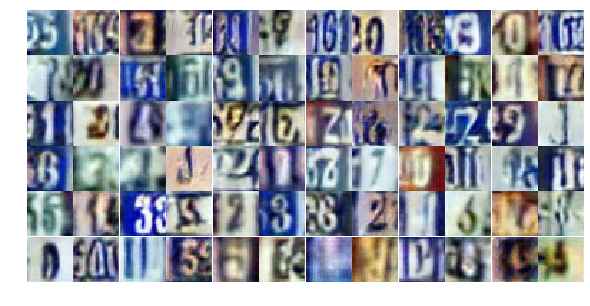

Epoch 13/25... Discriminator Loss: 1.1632... Generator Loss: 0.4862
Epoch 13/25... Discriminator Loss: 0.7294... Generator Loss: 1.3393
Epoch 13/25... Discriminator Loss: 0.8329... Generator Loss: 0.8615
Epoch 13/25... Discriminator Loss: 0.9853... Generator Loss: 0.6507
Epoch 13/25... Discriminator Loss: 0.9630... Generator Loss: 0.8021
Epoch 13/25... Discriminator Loss: 0.5245... Generator Loss: 1.4048
Epoch 13/25... Discriminator Loss: 0.4672... Generator Loss: 1.6750
Epoch 13/25... Discriminator Loss: 0.9641... Generator Loss: 0.8249
Epoch 13/25... Discriminator Loss: 0.7192... Generator Loss: 0.9432
Epoch 13/25... Discriminator Loss: 0.8428... Generator Loss: 0.7782


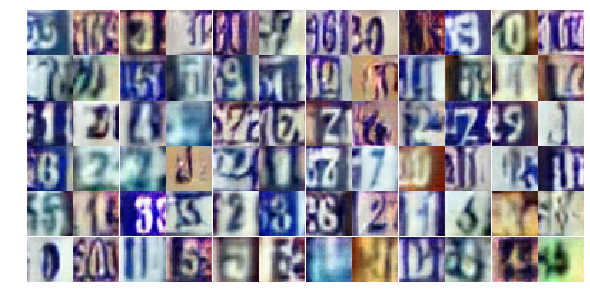

Epoch 13/25... Discriminator Loss: 0.6004... Generator Loss: 1.1620
Epoch 13/25... Discriminator Loss: 0.6185... Generator Loss: 1.1937
Epoch 13/25... Discriminator Loss: 0.7449... Generator Loss: 0.8696
Epoch 13/25... Discriminator Loss: 0.4723... Generator Loss: 2.0185
Epoch 13/25... Discriminator Loss: 1.3789... Generator Loss: 0.4354
Epoch 13/25... Discriminator Loss: 0.6722... Generator Loss: 1.0091
Epoch 13/25... Discriminator Loss: 0.6854... Generator Loss: 1.0444
Epoch 13/25... Discriminator Loss: 0.7237... Generator Loss: 1.0398
Epoch 13/25... Discriminator Loss: 0.7977... Generator Loss: 0.8342
Epoch 13/25... Discriminator Loss: 0.9819... Generator Loss: 0.7319


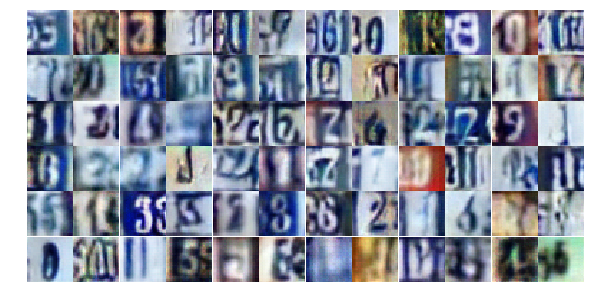

Epoch 13/25... Discriminator Loss: 0.3325... Generator Loss: 2.4384
Epoch 13/25... Discriminator Loss: 1.3421... Generator Loss: 0.4189
Epoch 13/25... Discriminator Loss: 0.7471... Generator Loss: 1.0054
Epoch 13/25... Discriminator Loss: 0.6300... Generator Loss: 1.2101
Epoch 14/25... Discriminator Loss: 0.8621... Generator Loss: 0.8744
Epoch 14/25... Discriminator Loss: 0.6158... Generator Loss: 1.2141
Epoch 14/25... Discriminator Loss: 0.9262... Generator Loss: 0.7855
Epoch 14/25... Discriminator Loss: 0.5129... Generator Loss: 2.4671
Epoch 14/25... Discriminator Loss: 0.5497... Generator Loss: 1.3709
Epoch 14/25... Discriminator Loss: 0.6898... Generator Loss: 0.9274


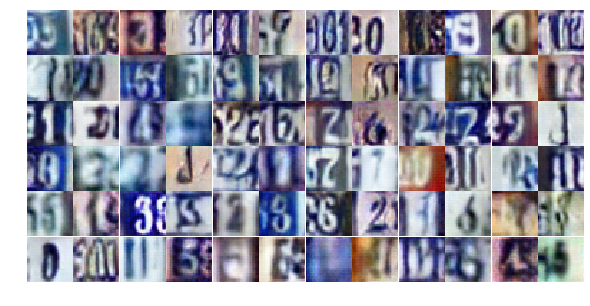

Epoch 14/25... Discriminator Loss: 2.1608... Generator Loss: 4.7405
Epoch 14/25... Discriminator Loss: 0.6828... Generator Loss: 0.9960
Epoch 14/25... Discriminator Loss: 0.5180... Generator Loss: 1.3915
Epoch 14/25... Discriminator Loss: 0.6980... Generator Loss: 1.1353
Epoch 14/25... Discriminator Loss: 1.3283... Generator Loss: 0.4300
Epoch 14/25... Discriminator Loss: 0.3818... Generator Loss: 1.5978
Epoch 14/25... Discriminator Loss: 0.4335... Generator Loss: 1.5473
Epoch 14/25... Discriminator Loss: 1.5426... Generator Loss: 0.3486
Epoch 14/25... Discriminator Loss: 1.4897... Generator Loss: 0.3647
Epoch 14/25... Discriminator Loss: 1.0929... Generator Loss: 0.5881


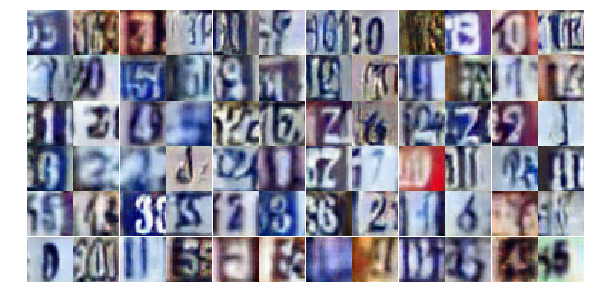

Epoch 14/25... Discriminator Loss: 0.5357... Generator Loss: 1.1495
Epoch 14/25... Discriminator Loss: 0.9814... Generator Loss: 3.5074
Epoch 14/25... Discriminator Loss: 0.9652... Generator Loss: 0.8110
Epoch 14/25... Discriminator Loss: 0.6242... Generator Loss: 1.3148
Epoch 14/25... Discriminator Loss: 1.2621... Generator Loss: 0.4861
Epoch 14/25... Discriminator Loss: 0.8312... Generator Loss: 0.9165
Epoch 14/25... Discriminator Loss: 0.6864... Generator Loss: 1.0356
Epoch 14/25... Discriminator Loss: 0.8064... Generator Loss: 0.7913
Epoch 14/25... Discriminator Loss: 0.5841... Generator Loss: 1.2895
Epoch 14/25... Discriminator Loss: 0.5284... Generator Loss: 1.4753


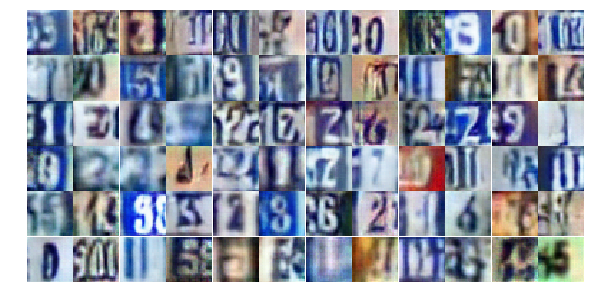

Epoch 14/25... Discriminator Loss: 1.2191... Generator Loss: 0.5278
Epoch 14/25... Discriminator Loss: 0.4848... Generator Loss: 1.2680
Epoch 14/25... Discriminator Loss: 0.6559... Generator Loss: 2.3240
Epoch 14/25... Discriminator Loss: 0.5225... Generator Loss: 1.8235
Epoch 14/25... Discriminator Loss: 0.7052... Generator Loss: 1.1212
Epoch 14/25... Discriminator Loss: 0.7148... Generator Loss: 0.9853
Epoch 14/25... Discriminator Loss: 0.5680... Generator Loss: 1.3836
Epoch 14/25... Discriminator Loss: 0.4755... Generator Loss: 1.9820
Epoch 14/25... Discriminator Loss: 0.4724... Generator Loss: 1.4134
Epoch 14/25... Discriminator Loss: 0.8338... Generator Loss: 0.8484


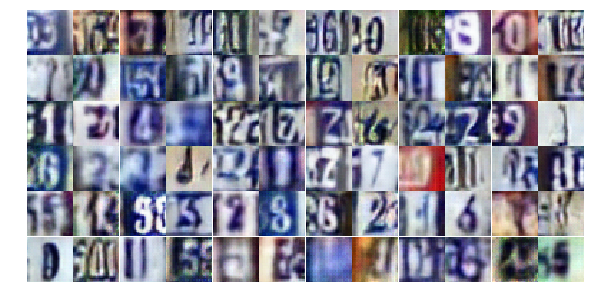

Epoch 14/25... Discriminator Loss: 1.5948... Generator Loss: 0.3376
Epoch 14/25... Discriminator Loss: 0.8980... Generator Loss: 0.7084
Epoch 14/25... Discriminator Loss: 1.3288... Generator Loss: 0.4050
Epoch 14/25... Discriminator Loss: 0.7546... Generator Loss: 0.8863
Epoch 14/25... Discriminator Loss: 0.6830... Generator Loss: 0.9333
Epoch 14/25... Discriminator Loss: 0.7386... Generator Loss: 0.9418
Epoch 14/25... Discriminator Loss: 0.6768... Generator Loss: 1.0953
Epoch 14/25... Discriminator Loss: 0.6110... Generator Loss: 1.3195
Epoch 14/25... Discriminator Loss: 1.0643... Generator Loss: 0.6313
Epoch 14/25... Discriminator Loss: 1.2096... Generator Loss: 0.4674


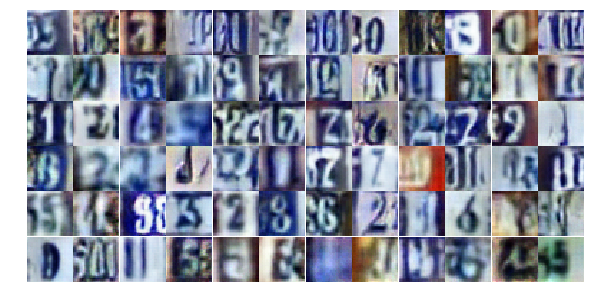

Epoch 14/25... Discriminator Loss: 0.7906... Generator Loss: 1.6060
Epoch 14/25... Discriminator Loss: 1.3391... Generator Loss: 0.4113
Epoch 14/25... Discriminator Loss: 0.5436... Generator Loss: 1.2836
Epoch 14/25... Discriminator Loss: 0.7573... Generator Loss: 0.9354
Epoch 14/25... Discriminator Loss: 0.8988... Generator Loss: 0.7703
Epoch 14/25... Discriminator Loss: 0.7908... Generator Loss: 0.8521
Epoch 14/25... Discriminator Loss: 0.7985... Generator Loss: 1.2958
Epoch 14/25... Discriminator Loss: 0.6987... Generator Loss: 0.9696
Epoch 14/25... Discriminator Loss: 0.6091... Generator Loss: 1.4338
Epoch 14/25... Discriminator Loss: 1.5539... Generator Loss: 0.3533


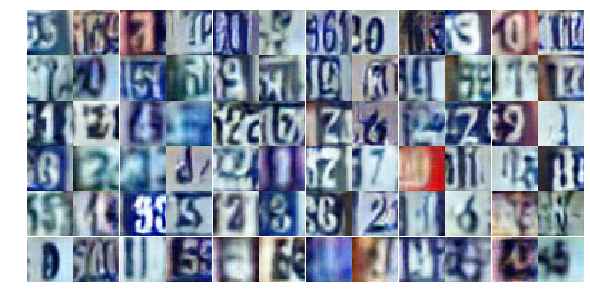

Epoch 14/25... Discriminator Loss: 0.6705... Generator Loss: 1.8855
Epoch 14/25... Discriminator Loss: 1.2456... Generator Loss: 0.5068
Epoch 15/25... Discriminator Loss: 0.9002... Generator Loss: 0.8321
Epoch 15/25... Discriminator Loss: 0.5221... Generator Loss: 1.4558
Epoch 15/25... Discriminator Loss: 0.6040... Generator Loss: 1.1318
Epoch 15/25... Discriminator Loss: 0.7314... Generator Loss: 1.0158
Epoch 15/25... Discriminator Loss: 1.0089... Generator Loss: 0.6373
Epoch 15/25... Discriminator Loss: 0.6362... Generator Loss: 1.0525
Epoch 15/25... Discriminator Loss: 1.6203... Generator Loss: 0.3494
Epoch 15/25... Discriminator Loss: 0.8440... Generator Loss: 1.0387


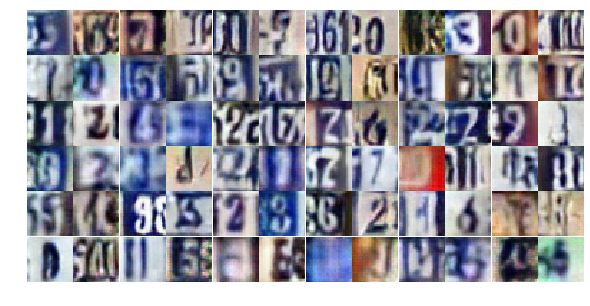

Epoch 15/25... Discriminator Loss: 0.7668... Generator Loss: 0.9491
Epoch 15/25... Discriminator Loss: 0.7286... Generator Loss: 1.4079
Epoch 15/25... Discriminator Loss: 0.8283... Generator Loss: 0.8292
Epoch 15/25... Discriminator Loss: 0.7000... Generator Loss: 1.0530
Epoch 15/25... Discriminator Loss: 0.8478... Generator Loss: 0.9308
Epoch 15/25... Discriminator Loss: 0.5272... Generator Loss: 1.4626
Epoch 15/25... Discriminator Loss: 1.1031... Generator Loss: 0.6601
Epoch 15/25... Discriminator Loss: 0.9964... Generator Loss: 0.6395
Epoch 15/25... Discriminator Loss: 1.0929... Generator Loss: 3.1957
Epoch 15/25... Discriminator Loss: 1.0211... Generator Loss: 0.6672


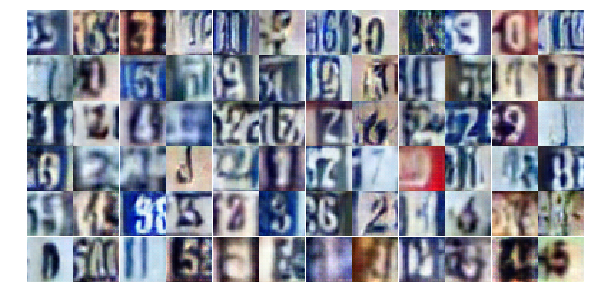

Epoch 15/25... Discriminator Loss: 0.6723... Generator Loss: 1.2150
Epoch 15/25... Discriminator Loss: 0.5747... Generator Loss: 1.2783
Epoch 15/25... Discriminator Loss: 0.6269... Generator Loss: 1.4583
Epoch 15/25... Discriminator Loss: 0.5573... Generator Loss: 1.2250
Epoch 15/25... Discriminator Loss: 0.9047... Generator Loss: 0.8134
Epoch 15/25... Discriminator Loss: 0.6585... Generator Loss: 1.1827
Epoch 15/25... Discriminator Loss: 0.8072... Generator Loss: 0.9964
Epoch 15/25... Discriminator Loss: 0.8468... Generator Loss: 0.8002
Epoch 15/25... Discriminator Loss: 0.4758... Generator Loss: 1.3482
Epoch 15/25... Discriminator Loss: 1.4029... Generator Loss: 0.4229


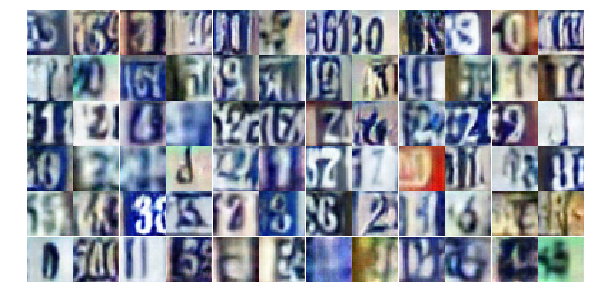

Epoch 15/25... Discriminator Loss: 0.8775... Generator Loss: 0.8083
Epoch 15/25... Discriminator Loss: 0.8880... Generator Loss: 0.9119
Epoch 15/25... Discriminator Loss: 0.7215... Generator Loss: 0.8703
Epoch 15/25... Discriminator Loss: 0.8917... Generator Loss: 1.9382
Epoch 15/25... Discriminator Loss: 0.6215... Generator Loss: 1.5592
Epoch 15/25... Discriminator Loss: 0.6673... Generator Loss: 2.2673
Epoch 15/25... Discriminator Loss: 1.0290... Generator Loss: 1.7380
Epoch 15/25... Discriminator Loss: 0.8807... Generator Loss: 0.8384
Epoch 15/25... Discriminator Loss: 0.6101... Generator Loss: 1.6868
Epoch 15/25... Discriminator Loss: 0.7381... Generator Loss: 0.9752


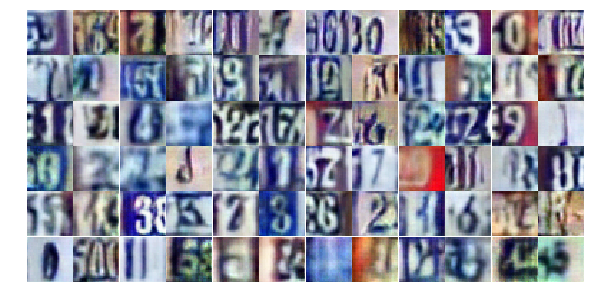

Epoch 15/25... Discriminator Loss: 0.6802... Generator Loss: 1.0022
Epoch 15/25... Discriminator Loss: 1.2710... Generator Loss: 0.4480
Epoch 15/25... Discriminator Loss: 0.5583... Generator Loss: 1.9546
Epoch 15/25... Discriminator Loss: 0.4552... Generator Loss: 1.4475
Epoch 15/25... Discriminator Loss: 0.4589... Generator Loss: 1.3961
Epoch 15/25... Discriminator Loss: 1.9524... Generator Loss: 0.2504
Epoch 15/25... Discriminator Loss: 0.5632... Generator Loss: 1.2751
Epoch 15/25... Discriminator Loss: 0.8366... Generator Loss: 0.8490
Epoch 15/25... Discriminator Loss: 0.7658... Generator Loss: 0.8988
Epoch 15/25... Discriminator Loss: 0.9433... Generator Loss: 1.9975


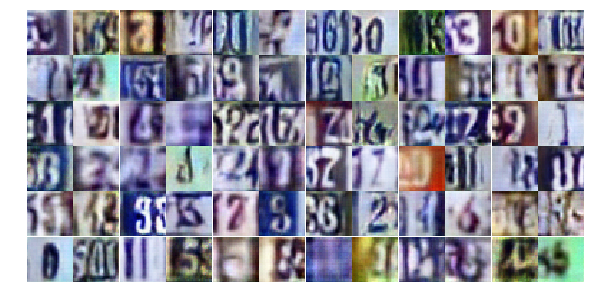

Epoch 15/25... Discriminator Loss: 1.7741... Generator Loss: 0.2522
Epoch 15/25... Discriminator Loss: 1.1169... Generator Loss: 0.5747
Epoch 15/25... Discriminator Loss: 0.5819... Generator Loss: 1.1103
Epoch 15/25... Discriminator Loss: 0.6667... Generator Loss: 1.6046
Epoch 15/25... Discriminator Loss: 0.4849... Generator Loss: 1.4296
Epoch 15/25... Discriminator Loss: 1.0684... Generator Loss: 0.6095
Epoch 15/25... Discriminator Loss: 0.9481... Generator Loss: 0.6976
Epoch 15/25... Discriminator Loss: 0.5120... Generator Loss: 1.6096
Epoch 15/25... Discriminator Loss: 1.5281... Generator Loss: 0.3867
Epoch 16/25... Discriminator Loss: 1.4809... Generator Loss: 0.4405


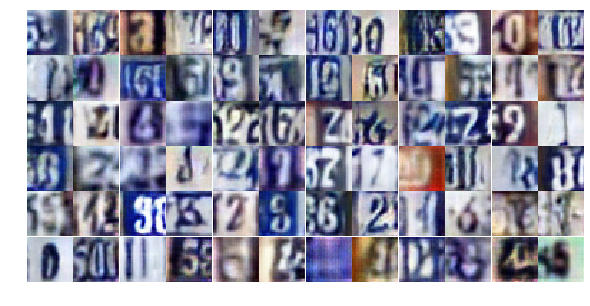

Epoch 16/25... Discriminator Loss: 0.6605... Generator Loss: 1.0902
Epoch 16/25... Discriminator Loss: 0.8855... Generator Loss: 0.7735
Epoch 16/25... Discriminator Loss: 0.9333... Generator Loss: 0.7519
Epoch 16/25... Discriminator Loss: 0.5289... Generator Loss: 1.7204
Epoch 16/25... Discriminator Loss: 0.4590... Generator Loss: 1.8905
Epoch 16/25... Discriminator Loss: 1.0512... Generator Loss: 0.6026
Epoch 16/25... Discriminator Loss: 1.5564... Generator Loss: 0.3260
Epoch 16/25... Discriminator Loss: 0.8598... Generator Loss: 0.9056
Epoch 16/25... Discriminator Loss: 1.5627... Generator Loss: 0.3555
Epoch 16/25... Discriminator Loss: 0.5812... Generator Loss: 1.9028


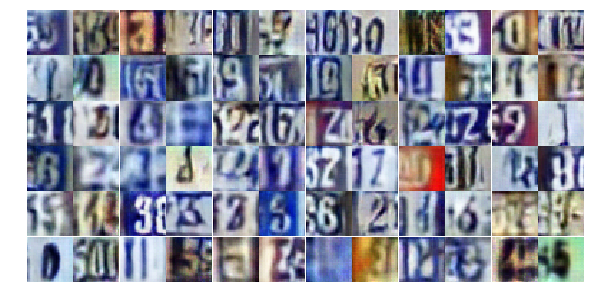

Epoch 16/25... Discriminator Loss: 1.1202... Generator Loss: 0.5859
Epoch 16/25... Discriminator Loss: 0.7705... Generator Loss: 0.8713
Epoch 16/25... Discriminator Loss: 0.7514... Generator Loss: 0.9732
Epoch 16/25... Discriminator Loss: 1.4092... Generator Loss: 0.4133
Epoch 16/25... Discriminator Loss: 0.5949... Generator Loss: 1.1993
Epoch 16/25... Discriminator Loss: 0.7643... Generator Loss: 0.9328
Epoch 16/25... Discriminator Loss: 1.2259... Generator Loss: 0.4751
Epoch 16/25... Discriminator Loss: 0.4250... Generator Loss: 1.8550
Epoch 16/25... Discriminator Loss: 0.5437... Generator Loss: 1.2574
Epoch 16/25... Discriminator Loss: 0.5295... Generator Loss: 1.4396


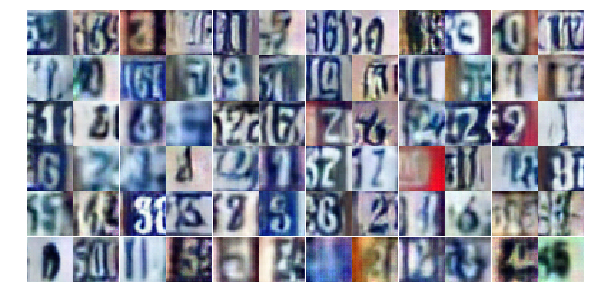

Epoch 16/25... Discriminator Loss: 0.6270... Generator Loss: 1.1224
Epoch 16/25... Discriminator Loss: 0.8330... Generator Loss: 0.8594
Epoch 16/25... Discriminator Loss: 0.6065... Generator Loss: 1.4298
Epoch 16/25... Discriminator Loss: 1.2005... Generator Loss: 0.4886
Epoch 16/25... Discriminator Loss: 0.9487... Generator Loss: 0.6907
Epoch 16/25... Discriminator Loss: 1.0384... Generator Loss: 0.6501
Epoch 16/25... Discriminator Loss: 0.6803... Generator Loss: 0.9632
Epoch 16/25... Discriminator Loss: 0.5964... Generator Loss: 1.0646
Epoch 16/25... Discriminator Loss: 0.8701... Generator Loss: 0.8655
Epoch 16/25... Discriminator Loss: 0.5482... Generator Loss: 1.2658


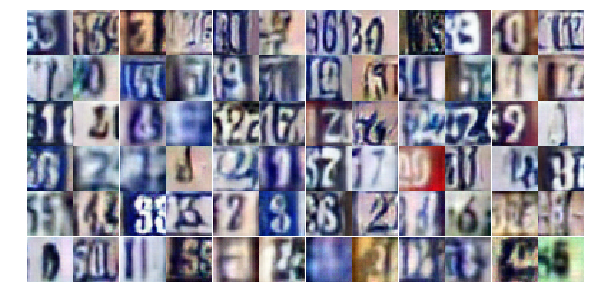

Epoch 16/25... Discriminator Loss: 0.6883... Generator Loss: 0.9567
Epoch 16/25... Discriminator Loss: 0.5709... Generator Loss: 1.1676
Epoch 16/25... Discriminator Loss: 0.6207... Generator Loss: 1.1973
Epoch 16/25... Discriminator Loss: 0.7624... Generator Loss: 1.5137
Epoch 16/25... Discriminator Loss: 1.3197... Generator Loss: 2.5169
Epoch 16/25... Discriminator Loss: 0.8896... Generator Loss: 0.7636
Epoch 16/25... Discriminator Loss: 1.0858... Generator Loss: 0.5755
Epoch 16/25... Discriminator Loss: 0.8969... Generator Loss: 0.7909
Epoch 16/25... Discriminator Loss: 1.1808... Generator Loss: 0.4863
Epoch 16/25... Discriminator Loss: 0.5934... Generator Loss: 1.7580


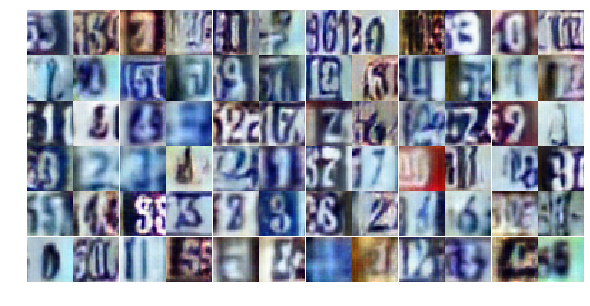

Epoch 16/25... Discriminator Loss: 0.5622... Generator Loss: 1.3159
Epoch 16/25... Discriminator Loss: 0.6090... Generator Loss: 1.2288
Epoch 16/25... Discriminator Loss: 1.0670... Generator Loss: 0.5885
Epoch 16/25... Discriminator Loss: 1.2518... Generator Loss: 0.4893
Epoch 16/25... Discriminator Loss: 0.8003... Generator Loss: 0.8028
Epoch 16/25... Discriminator Loss: 1.2377... Generator Loss: 0.4943
Epoch 16/25... Discriminator Loss: 0.5709... Generator Loss: 1.4201
Epoch 16/25... Discriminator Loss: 1.0755... Generator Loss: 0.5556
Epoch 16/25... Discriminator Loss: 0.7164... Generator Loss: 1.0364
Epoch 16/25... Discriminator Loss: 1.0482... Generator Loss: 0.6140


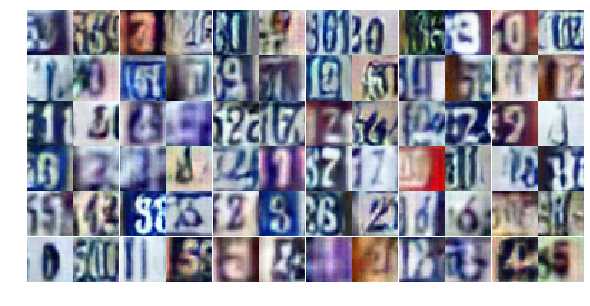

Epoch 16/25... Discriminator Loss: 1.3039... Generator Loss: 0.4224
Epoch 16/25... Discriminator Loss: 0.8061... Generator Loss: 1.8763
Epoch 16/25... Discriminator Loss: 1.8739... Generator Loss: 0.2859
Epoch 16/25... Discriminator Loss: 0.6480... Generator Loss: 2.3023
Epoch 16/25... Discriminator Loss: 0.6442... Generator Loss: 1.3153
Epoch 16/25... Discriminator Loss: 0.8757... Generator Loss: 0.7621
Epoch 17/25... Discriminator Loss: 0.8430... Generator Loss: 0.8809
Epoch 17/25... Discriminator Loss: 0.9350... Generator Loss: 0.6980
Epoch 17/25... Discriminator Loss: 0.7676... Generator Loss: 0.9529
Epoch 17/25... Discriminator Loss: 0.9462... Generator Loss: 0.7250


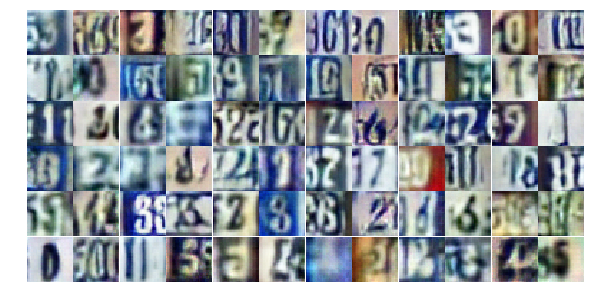

Epoch 17/25... Discriminator Loss: 0.6433... Generator Loss: 1.1325
Epoch 17/25... Discriminator Loss: 0.5994... Generator Loss: 1.0723
Epoch 17/25... Discriminator Loss: 0.8506... Generator Loss: 0.7773
Epoch 17/25... Discriminator Loss: 1.0928... Generator Loss: 0.6712
Epoch 17/25... Discriminator Loss: 1.1980... Generator Loss: 0.5669
Epoch 17/25... Discriminator Loss: 1.3213... Generator Loss: 0.4508
Epoch 17/25... Discriminator Loss: 0.7053... Generator Loss: 1.0447
Epoch 17/25... Discriminator Loss: 0.7942... Generator Loss: 0.8340
Epoch 17/25... Discriminator Loss: 0.6961... Generator Loss: 1.0001
Epoch 17/25... Discriminator Loss: 0.7132... Generator Loss: 0.9955


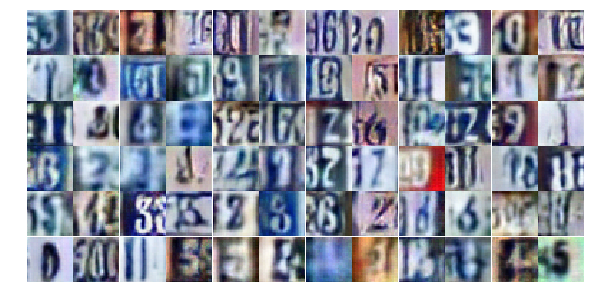

Epoch 17/25... Discriminator Loss: 0.7931... Generator Loss: 1.0698
Epoch 17/25... Discriminator Loss: 0.8605... Generator Loss: 0.9080
Epoch 17/25... Discriminator Loss: 0.7723... Generator Loss: 0.9061
Epoch 17/25... Discriminator Loss: 1.8521... Generator Loss: 2.6431
Epoch 17/25... Discriminator Loss: 0.6896... Generator Loss: 1.2181
Epoch 17/25... Discriminator Loss: 1.1749... Generator Loss: 0.5206
Epoch 17/25... Discriminator Loss: 0.5669... Generator Loss: 1.2798
Epoch 17/25... Discriminator Loss: 0.6564... Generator Loss: 1.1353
Epoch 17/25... Discriminator Loss: 0.8949... Generator Loss: 0.7620
Epoch 17/25... Discriminator Loss: 0.7495... Generator Loss: 0.8726


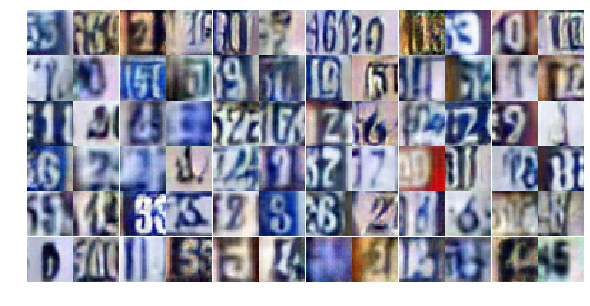

Epoch 17/25... Discriminator Loss: 1.6030... Generator Loss: 0.2998
Epoch 17/25... Discriminator Loss: 0.4820... Generator Loss: 1.5363
Epoch 17/25... Discriminator Loss: 0.4745... Generator Loss: 1.5443
Epoch 17/25... Discriminator Loss: 1.1337... Generator Loss: 0.5212
Epoch 17/25... Discriminator Loss: 1.6511... Generator Loss: 0.3069
Epoch 17/25... Discriminator Loss: 0.6276... Generator Loss: 1.0898
Epoch 17/25... Discriminator Loss: 1.0122... Generator Loss: 0.6461
Epoch 17/25... Discriminator Loss: 0.8549... Generator Loss: 0.7690
Epoch 17/25... Discriminator Loss: 0.7638... Generator Loss: 0.9550
Epoch 17/25... Discriminator Loss: 0.3901... Generator Loss: 1.6353


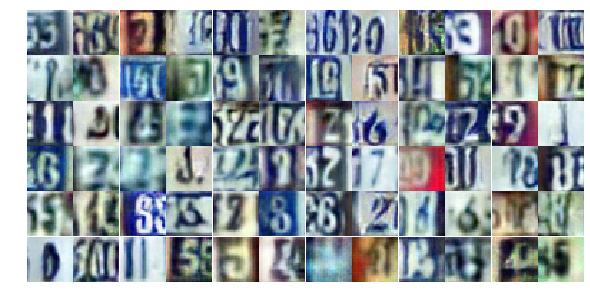

Epoch 17/25... Discriminator Loss: 0.5960... Generator Loss: 1.3865
Epoch 17/25... Discriminator Loss: 0.9045... Generator Loss: 0.7432
Epoch 17/25... Discriminator Loss: 0.6429... Generator Loss: 1.8176
Epoch 17/25... Discriminator Loss: 0.7452... Generator Loss: 1.0707
Epoch 17/25... Discriminator Loss: 0.7410... Generator Loss: 1.0281
Epoch 17/25... Discriminator Loss: 0.9079... Generator Loss: 0.7397
Epoch 17/25... Discriminator Loss: 1.0656... Generator Loss: 0.6828
Epoch 17/25... Discriminator Loss: 0.4482... Generator Loss: 1.5654
Epoch 17/25... Discriminator Loss: 0.3796... Generator Loss: 1.5612
Epoch 17/25... Discriminator Loss: 1.0731... Generator Loss: 0.5975


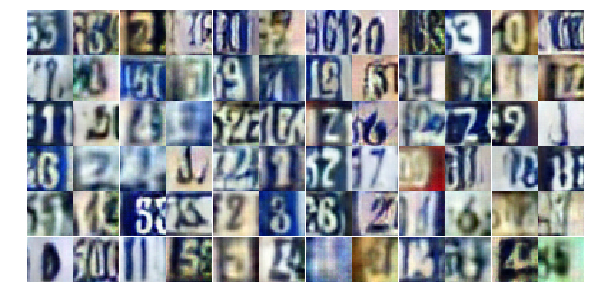

Epoch 17/25... Discriminator Loss: 1.8592... Generator Loss: 2.9305
Epoch 17/25... Discriminator Loss: 0.5268... Generator Loss: 2.2604
Epoch 17/25... Discriminator Loss: 0.6886... Generator Loss: 1.9866
Epoch 17/25... Discriminator Loss: 0.4471... Generator Loss: 1.4359
Epoch 17/25... Discriminator Loss: 0.7301... Generator Loss: 0.9197
Epoch 17/25... Discriminator Loss: 0.9991... Generator Loss: 0.6498
Epoch 17/25... Discriminator Loss: 1.3006... Generator Loss: 0.4361
Epoch 17/25... Discriminator Loss: 0.7264... Generator Loss: 1.0108
Epoch 17/25... Discriminator Loss: 0.5207... Generator Loss: 1.3012
Epoch 17/25... Discriminator Loss: 1.6850... Generator Loss: 0.3000


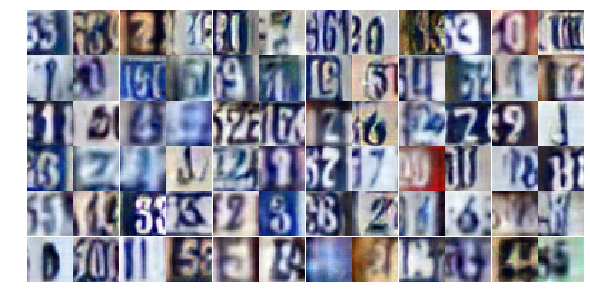

Epoch 17/25... Discriminator Loss: 0.7833... Generator Loss: 0.9304
Epoch 17/25... Discriminator Loss: 1.2300... Generator Loss: 2.1350
Epoch 17/25... Discriminator Loss: 0.5236... Generator Loss: 1.2787
Epoch 17/25... Discriminator Loss: 0.5760... Generator Loss: 2.0779
Epoch 18/25... Discriminator Loss: 0.8303... Generator Loss: 1.0147
Epoch 18/25... Discriminator Loss: 1.1585... Generator Loss: 0.5257
Epoch 18/25... Discriminator Loss: 0.8654... Generator Loss: 0.8610
Epoch 18/25... Discriminator Loss: 0.6542... Generator Loss: 0.9599
Epoch 18/25... Discriminator Loss: 1.2097... Generator Loss: 0.5142
Epoch 18/25... Discriminator Loss: 0.8160... Generator Loss: 0.9383


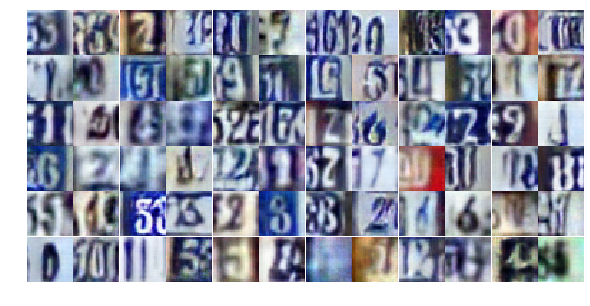

Epoch 18/25... Discriminator Loss: 0.4665... Generator Loss: 1.5199
Epoch 18/25... Discriminator Loss: 1.0516... Generator Loss: 0.5916
Epoch 18/25... Discriminator Loss: 0.8565... Generator Loss: 0.8092
Epoch 18/25... Discriminator Loss: 0.5231... Generator Loss: 1.4555
Epoch 18/25... Discriminator Loss: 0.6918... Generator Loss: 0.9772
Epoch 18/25... Discriminator Loss: 1.0439... Generator Loss: 0.6210
Epoch 18/25... Discriminator Loss: 0.6142... Generator Loss: 1.1594
Epoch 18/25... Discriminator Loss: 0.8300... Generator Loss: 0.8728
Epoch 18/25... Discriminator Loss: 0.6442... Generator Loss: 1.4652
Epoch 18/25... Discriminator Loss: 0.4614... Generator Loss: 1.4317


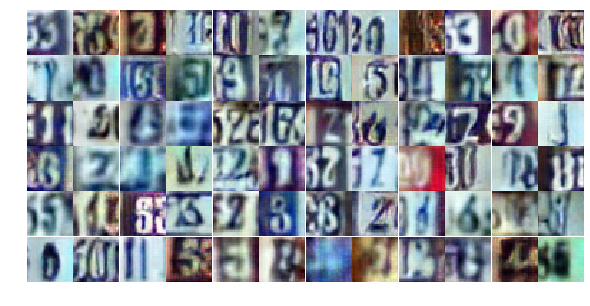

Epoch 18/25... Discriminator Loss: 1.3843... Generator Loss: 0.5021
Epoch 18/25... Discriminator Loss: 0.7204... Generator Loss: 1.9955
Epoch 18/25... Discriminator Loss: 1.1741... Generator Loss: 0.5768
Epoch 18/25... Discriminator Loss: 0.5160... Generator Loss: 1.2638
Epoch 18/25... Discriminator Loss: 1.1413... Generator Loss: 0.5497
Epoch 18/25... Discriminator Loss: 1.1084... Generator Loss: 0.5607
Epoch 18/25... Discriminator Loss: 0.8597... Generator Loss: 1.1859
Epoch 18/25... Discriminator Loss: 0.8590... Generator Loss: 0.8296
Epoch 18/25... Discriminator Loss: 0.6056... Generator Loss: 1.1574
Epoch 18/25... Discriminator Loss: 0.5971... Generator Loss: 1.0718


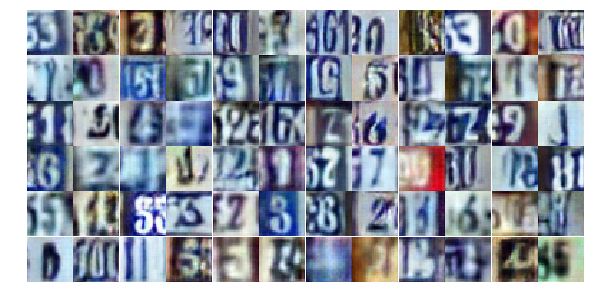

Epoch 18/25... Discriminator Loss: 0.5335... Generator Loss: 1.2148
Epoch 18/25... Discriminator Loss: 0.8041... Generator Loss: 0.9386
Epoch 18/25... Discriminator Loss: 0.6376... Generator Loss: 1.1351
Epoch 18/25... Discriminator Loss: 0.8360... Generator Loss: 0.8175
Epoch 18/25... Discriminator Loss: 1.3255... Generator Loss: 0.4358
Epoch 18/25... Discriminator Loss: 0.5842... Generator Loss: 1.4014
Epoch 18/25... Discriminator Loss: 0.6573... Generator Loss: 1.1077
Epoch 18/25... Discriminator Loss: 0.4536... Generator Loss: 1.8408
Epoch 18/25... Discriminator Loss: 0.6366... Generator Loss: 1.4172
Epoch 18/25... Discriminator Loss: 1.3805... Generator Loss: 0.5963


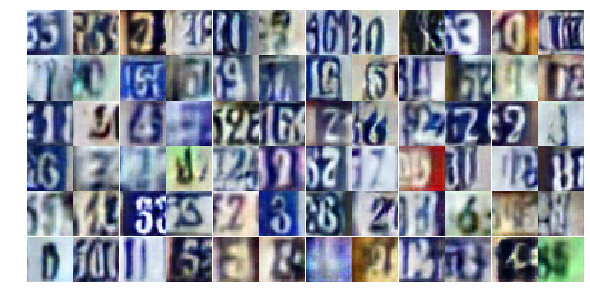

Epoch 18/25... Discriminator Loss: 0.8468... Generator Loss: 0.8773
Epoch 18/25... Discriminator Loss: 0.6053... Generator Loss: 1.2310
Epoch 18/25... Discriminator Loss: 0.6913... Generator Loss: 0.9244
Epoch 18/25... Discriminator Loss: 0.6346... Generator Loss: 1.1304
Epoch 18/25... Discriminator Loss: 0.8979... Generator Loss: 0.8920
Epoch 18/25... Discriminator Loss: 0.5245... Generator Loss: 1.1998
Epoch 18/25... Discriminator Loss: 0.8324... Generator Loss: 0.8219
Epoch 18/25... Discriminator Loss: 0.8966... Generator Loss: 2.2290
Epoch 18/25... Discriminator Loss: 0.8869... Generator Loss: 0.8413
Epoch 18/25... Discriminator Loss: 0.3821... Generator Loss: 1.7701


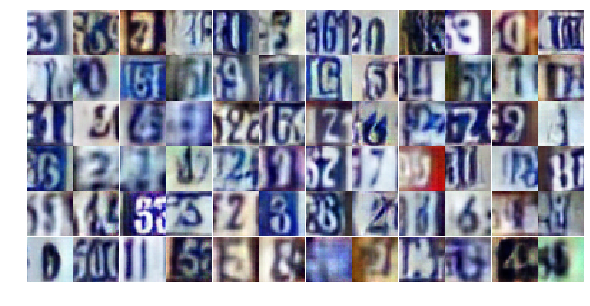

Epoch 18/25... Discriminator Loss: 0.5406... Generator Loss: 1.3031
Epoch 18/25... Discriminator Loss: 1.1453... Generator Loss: 0.5410
Epoch 18/25... Discriminator Loss: 0.9374... Generator Loss: 0.7940
Epoch 18/25... Discriminator Loss: 0.9248... Generator Loss: 0.8299
Epoch 18/25... Discriminator Loss: 0.5133... Generator Loss: 1.2730
Epoch 18/25... Discriminator Loss: 0.5129... Generator Loss: 1.3210
Epoch 18/25... Discriminator Loss: 0.5917... Generator Loss: 1.2309
Epoch 18/25... Discriminator Loss: 0.4398... Generator Loss: 1.4780
Epoch 18/25... Discriminator Loss: 1.1704... Generator Loss: 0.5210
Epoch 18/25... Discriminator Loss: 0.4916... Generator Loss: 1.2983


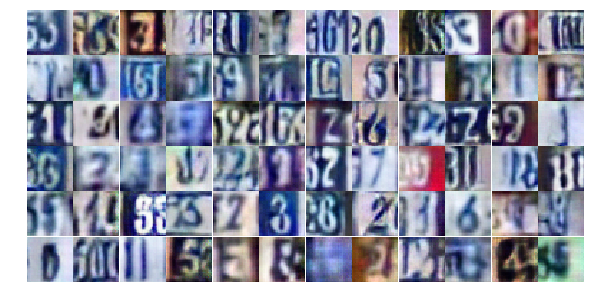

Epoch 18/25... Discriminator Loss: 1.1903... Generator Loss: 2.6030
Epoch 19/25... Discriminator Loss: 1.1081... Generator Loss: 2.0484
Epoch 19/25... Discriminator Loss: 1.3105... Generator Loss: 0.5106
Epoch 19/25... Discriminator Loss: 1.0117... Generator Loss: 0.6484
Epoch 19/25... Discriminator Loss: 0.7707... Generator Loss: 0.9088
Epoch 19/25... Discriminator Loss: 0.9015... Generator Loss: 0.8114
Epoch 19/25... Discriminator Loss: 0.5686... Generator Loss: 1.2636
Epoch 19/25... Discriminator Loss: 0.8486... Generator Loss: 1.3339
Epoch 19/25... Discriminator Loss: 0.6673... Generator Loss: 1.6007
Epoch 19/25... Discriminator Loss: 0.8885... Generator Loss: 0.8116


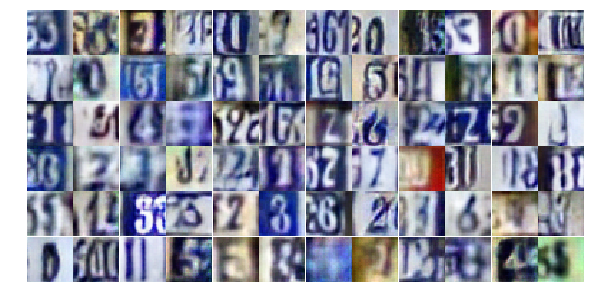

Epoch 19/25... Discriminator Loss: 0.7266... Generator Loss: 0.9602
Epoch 19/25... Discriminator Loss: 1.0471... Generator Loss: 0.6650
Epoch 19/25... Discriminator Loss: 0.6914... Generator Loss: 1.4330
Epoch 19/25... Discriminator Loss: 1.1444... Generator Loss: 0.5607
Epoch 19/25... Discriminator Loss: 1.3700... Generator Loss: 0.3806
Epoch 19/25... Discriminator Loss: 0.7672... Generator Loss: 0.9244
Epoch 19/25... Discriminator Loss: 1.1707... Generator Loss: 0.5482
Epoch 19/25... Discriminator Loss: 0.6850... Generator Loss: 1.0407
Epoch 19/25... Discriminator Loss: 0.6631... Generator Loss: 2.2917
Epoch 19/25... Discriminator Loss: 0.8922... Generator Loss: 0.7540


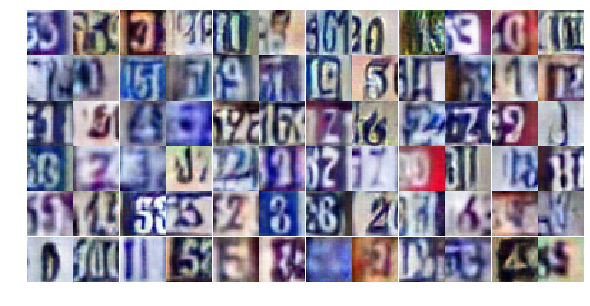

Epoch 19/25... Discriminator Loss: 0.7150... Generator Loss: 0.9625
Epoch 19/25... Discriminator Loss: 1.7186... Generator Loss: 0.3227
Epoch 19/25... Discriminator Loss: 1.3004... Generator Loss: 0.5309
Epoch 19/25... Discriminator Loss: 0.8068... Generator Loss: 1.3629
Epoch 19/25... Discriminator Loss: 1.1313... Generator Loss: 0.5845
Epoch 19/25... Discriminator Loss: 0.8478... Generator Loss: 1.0464
Epoch 19/25... Discriminator Loss: 0.7309... Generator Loss: 1.0210
Epoch 19/25... Discriminator Loss: 0.5572... Generator Loss: 1.1804
Epoch 19/25... Discriminator Loss: 0.9677... Generator Loss: 0.6614
Epoch 19/25... Discriminator Loss: 1.0172... Generator Loss: 0.6759


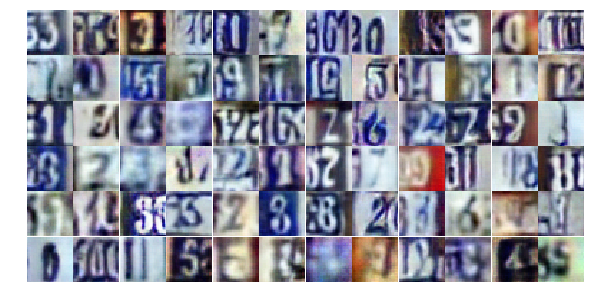

Epoch 19/25... Discriminator Loss: 0.7435... Generator Loss: 1.9582
Epoch 19/25... Discriminator Loss: 0.4710... Generator Loss: 1.3704
Epoch 19/25... Discriminator Loss: 1.0607... Generator Loss: 0.5644
Epoch 19/25... Discriminator Loss: 0.6450... Generator Loss: 1.1974
Epoch 19/25... Discriminator Loss: 0.6508... Generator Loss: 1.0646
Epoch 19/25... Discriminator Loss: 0.7083... Generator Loss: 2.0276
Epoch 19/25... Discriminator Loss: 0.7282... Generator Loss: 1.5727
Epoch 19/25... Discriminator Loss: 0.6933... Generator Loss: 1.0245
Epoch 19/25... Discriminator Loss: 0.7830... Generator Loss: 1.3540
Epoch 19/25... Discriminator Loss: 0.4691... Generator Loss: 2.1724


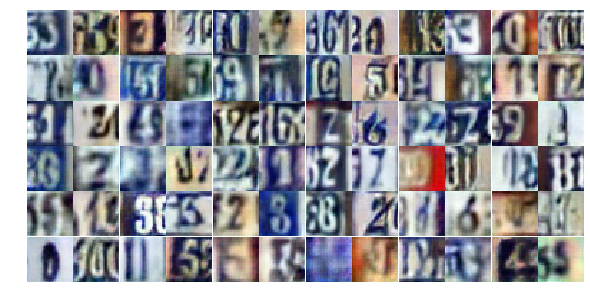

Epoch 19/25... Discriminator Loss: 0.6465... Generator Loss: 1.0513
Epoch 19/25... Discriminator Loss: 0.6267... Generator Loss: 1.2092
Epoch 19/25... Discriminator Loss: 0.8137... Generator Loss: 0.7908
Epoch 19/25... Discriminator Loss: 0.6219... Generator Loss: 1.0632
Epoch 19/25... Discriminator Loss: 0.8230... Generator Loss: 0.8600
Epoch 19/25... Discriminator Loss: 2.4909... Generator Loss: 5.5249
Epoch 19/25... Discriminator Loss: 0.7053... Generator Loss: 2.0982
Epoch 19/25... Discriminator Loss: 0.5018... Generator Loss: 1.5370
Epoch 19/25... Discriminator Loss: 0.6124... Generator Loss: 1.2394
Epoch 19/25... Discriminator Loss: 0.8709... Generator Loss: 0.8224


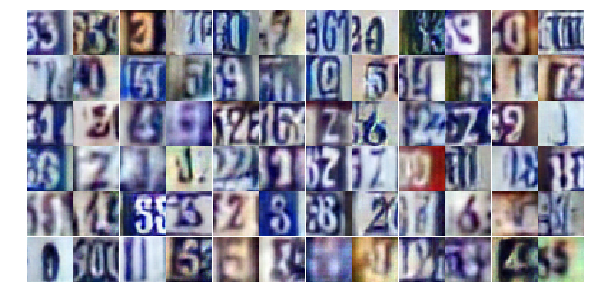

Epoch 19/25... Discriminator Loss: 0.7626... Generator Loss: 0.9971
Epoch 19/25... Discriminator Loss: 0.7396... Generator Loss: 1.1380
Epoch 19/25... Discriminator Loss: 0.6086... Generator Loss: 2.1484
Epoch 19/25... Discriminator Loss: 0.9051... Generator Loss: 0.7522
Epoch 19/25... Discriminator Loss: 0.9458... Generator Loss: 0.6534
Epoch 19/25... Discriminator Loss: 0.7328... Generator Loss: 1.0758
Epoch 19/25... Discriminator Loss: 1.5097... Generator Loss: 0.3828
Epoch 19/25... Discriminator Loss: 0.5862... Generator Loss: 1.1883
Epoch 20/25... Discriminator Loss: 0.6206... Generator Loss: 1.1710
Epoch 20/25... Discriminator Loss: 0.7661... Generator Loss: 0.8709


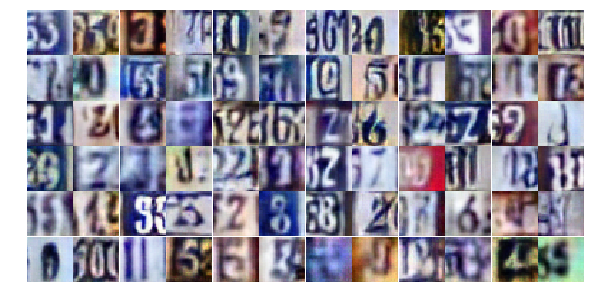

Epoch 20/25... Discriminator Loss: 0.6676... Generator Loss: 1.0414
Epoch 20/25... Discriminator Loss: 1.1851... Generator Loss: 0.5473
Epoch 20/25... Discriminator Loss: 1.3664... Generator Loss: 0.4117
Epoch 20/25... Discriminator Loss: 1.0268... Generator Loss: 0.6528
Epoch 20/25... Discriminator Loss: 0.7377... Generator Loss: 1.3164
Epoch 20/25... Discriminator Loss: 0.6167... Generator Loss: 1.1401
Epoch 20/25... Discriminator Loss: 0.9305... Generator Loss: 0.7379
Epoch 20/25... Discriminator Loss: 0.7037... Generator Loss: 1.1281
Epoch 20/25... Discriminator Loss: 1.1907... Generator Loss: 0.5451
Epoch 20/25... Discriminator Loss: 0.6702... Generator Loss: 1.0091


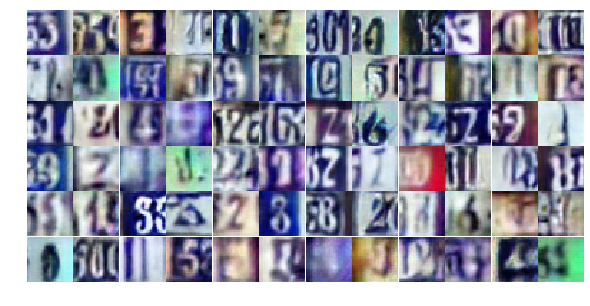

Epoch 20/25... Discriminator Loss: 1.3586... Generator Loss: 0.5551
Epoch 20/25... Discriminator Loss: 0.7117... Generator Loss: 1.1997
Epoch 20/25... Discriminator Loss: 0.5867... Generator Loss: 1.3377
Epoch 20/25... Discriminator Loss: 1.2427... Generator Loss: 0.5820
Epoch 20/25... Discriminator Loss: 1.7380... Generator Loss: 0.2662
Epoch 20/25... Discriminator Loss: 1.2512... Generator Loss: 0.4697
Epoch 20/25... Discriminator Loss: 1.3253... Generator Loss: 0.4941
Epoch 20/25... Discriminator Loss: 0.4944... Generator Loss: 2.0454
Epoch 20/25... Discriminator Loss: 0.5464... Generator Loss: 1.2907
Epoch 20/25... Discriminator Loss: 1.0610... Generator Loss: 0.6158


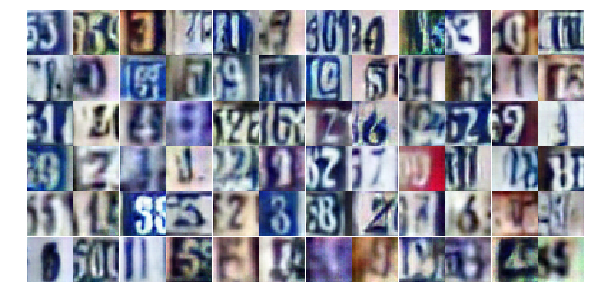

Epoch 20/25... Discriminator Loss: 0.6787... Generator Loss: 1.0944
Epoch 20/25... Discriminator Loss: 0.9700... Generator Loss: 0.7801
Epoch 20/25... Discriminator Loss: 0.4214... Generator Loss: 1.7263
Epoch 20/25... Discriminator Loss: 1.4068... Generator Loss: 0.4374
Epoch 20/25... Discriminator Loss: 1.1011... Generator Loss: 0.5811
Epoch 20/25... Discriminator Loss: 0.4057... Generator Loss: 1.9987
Epoch 20/25... Discriminator Loss: 0.4803... Generator Loss: 1.5474
Epoch 20/25... Discriminator Loss: 1.5450... Generator Loss: 0.3727
Epoch 20/25... Discriminator Loss: 1.0156... Generator Loss: 0.6866
Epoch 20/25... Discriminator Loss: 0.4560... Generator Loss: 1.3755


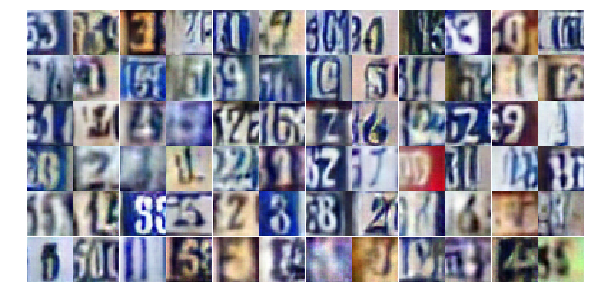

Epoch 20/25... Discriminator Loss: 0.7413... Generator Loss: 1.2705
Epoch 20/25... Discriminator Loss: 0.7215... Generator Loss: 0.9764
Epoch 20/25... Discriminator Loss: 1.2159... Generator Loss: 0.4836
Epoch 20/25... Discriminator Loss: 0.6627... Generator Loss: 1.2783
Epoch 20/25... Discriminator Loss: 0.7282... Generator Loss: 1.1426
Epoch 20/25... Discriminator Loss: 0.7438... Generator Loss: 0.9795
Epoch 20/25... Discriminator Loss: 1.0698... Generator Loss: 0.7011
Epoch 20/25... Discriminator Loss: 0.7936... Generator Loss: 0.8810
Epoch 20/25... Discriminator Loss: 0.9866... Generator Loss: 0.6973
Epoch 20/25... Discriminator Loss: 1.0734... Generator Loss: 0.5997


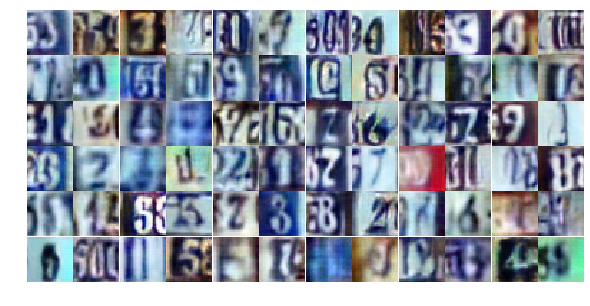

Epoch 20/25... Discriminator Loss: 0.7711... Generator Loss: 0.8915
Epoch 20/25... Discriminator Loss: 1.0240... Generator Loss: 0.6401
Epoch 20/25... Discriminator Loss: 2.1891... Generator Loss: 0.3291
Epoch 20/25... Discriminator Loss: 1.1992... Generator Loss: 0.7767
Epoch 20/25... Discriminator Loss: 0.7909... Generator Loss: 1.0775
Epoch 20/25... Discriminator Loss: 1.0570... Generator Loss: 0.7063
Epoch 20/25... Discriminator Loss: 1.1087... Generator Loss: 0.6071
Epoch 20/25... Discriminator Loss: 0.5414... Generator Loss: 1.3437
Epoch 20/25... Discriminator Loss: 0.7641... Generator Loss: 1.8555
Epoch 20/25... Discriminator Loss: 0.6112... Generator Loss: 1.1093


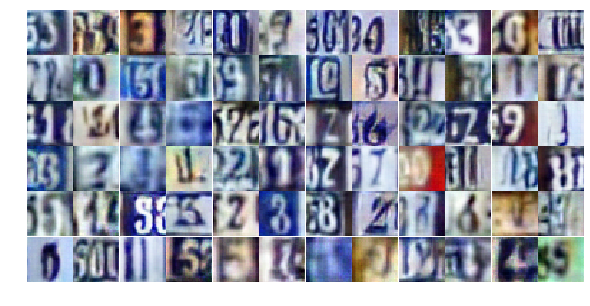

Epoch 20/25... Discriminator Loss: 0.6131... Generator Loss: 1.4318
Epoch 20/25... Discriminator Loss: 0.7970... Generator Loss: 0.8483
Epoch 20/25... Discriminator Loss: 0.5690... Generator Loss: 1.4144
Epoch 20/25... Discriminator Loss: 0.7155... Generator Loss: 1.3057
Epoch 20/25... Discriminator Loss: 0.5763... Generator Loss: 1.1330
Epoch 20/25... Discriminator Loss: 0.8320... Generator Loss: 0.7701
Epoch 21/25... Discriminator Loss: 0.9772... Generator Loss: 0.7929
Epoch 21/25... Discriminator Loss: 0.8188... Generator Loss: 0.9172
Epoch 21/25... Discriminator Loss: 1.4316... Generator Loss: 0.3953
Epoch 21/25... Discriminator Loss: 1.2941... Generator Loss: 0.5028


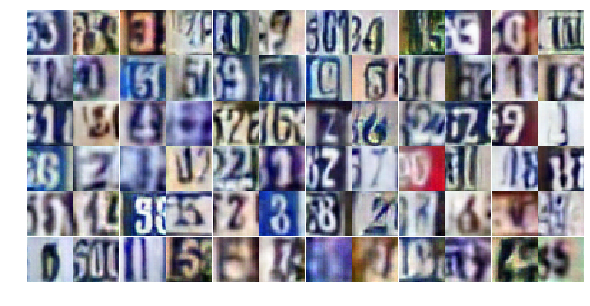

Epoch 21/25... Discriminator Loss: 0.8247... Generator Loss: 0.8037
Epoch 21/25... Discriminator Loss: 2.2147... Generator Loss: 0.2141
Epoch 21/25... Discriminator Loss: 0.5388... Generator Loss: 1.5105
Epoch 21/25... Discriminator Loss: 0.4938... Generator Loss: 1.2396
Epoch 21/25... Discriminator Loss: 0.7397... Generator Loss: 0.9503
Epoch 21/25... Discriminator Loss: 0.7419... Generator Loss: 0.9383
Epoch 21/25... Discriminator Loss: 0.7205... Generator Loss: 1.0071
Epoch 21/25... Discriminator Loss: 1.1686... Generator Loss: 0.5167
Epoch 21/25... Discriminator Loss: 0.6371... Generator Loss: 1.1146
Epoch 21/25... Discriminator Loss: 1.1021... Generator Loss: 0.5988


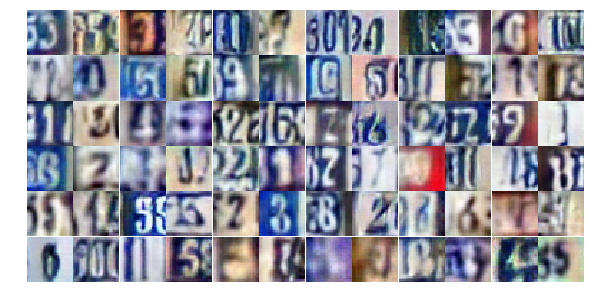

Epoch 21/25... Discriminator Loss: 0.3857... Generator Loss: 1.5041
Epoch 21/25... Discriminator Loss: 1.0191... Generator Loss: 0.6598
Epoch 21/25... Discriminator Loss: 1.9101... Generator Loss: 0.2784
Epoch 21/25... Discriminator Loss: 0.5975... Generator Loss: 1.9582
Epoch 21/25... Discriminator Loss: 0.5637... Generator Loss: 1.4621
Epoch 21/25... Discriminator Loss: 1.2878... Generator Loss: 0.5376
Epoch 21/25... Discriminator Loss: 1.1463... Generator Loss: 0.5016
Epoch 21/25... Discriminator Loss: 0.5646... Generator Loss: 1.5537
Epoch 21/25... Discriminator Loss: 0.5826... Generator Loss: 1.1276
Epoch 21/25... Discriminator Loss: 0.6710... Generator Loss: 1.0624


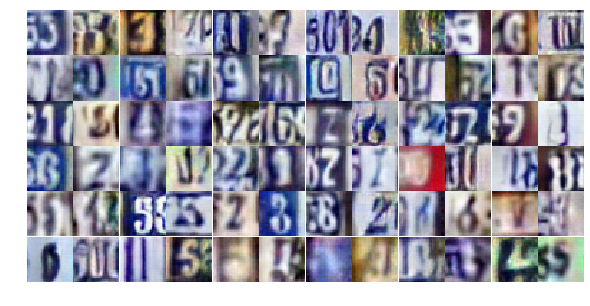

Epoch 21/25... Discriminator Loss: 1.1423... Generator Loss: 0.5639
Epoch 21/25... Discriminator Loss: 0.3872... Generator Loss: 1.7861
Epoch 21/25... Discriminator Loss: 1.1827... Generator Loss: 0.5760
Epoch 21/25... Discriminator Loss: 1.3451... Generator Loss: 0.5258
Epoch 21/25... Discriminator Loss: 1.0294... Generator Loss: 0.6564
Epoch 21/25... Discriminator Loss: 1.0332... Generator Loss: 0.7007
Epoch 21/25... Discriminator Loss: 0.5152... Generator Loss: 1.2750
Epoch 21/25... Discriminator Loss: 1.0887... Generator Loss: 0.5755
Epoch 21/25... Discriminator Loss: 1.0655... Generator Loss: 0.5738
Epoch 21/25... Discriminator Loss: 1.5703... Generator Loss: 0.3548


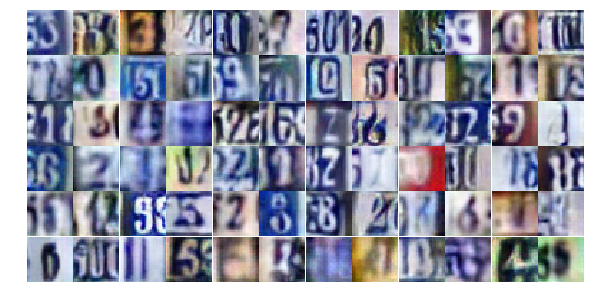

Epoch 21/25... Discriminator Loss: 1.0724... Generator Loss: 0.6033
Epoch 21/25... Discriminator Loss: 0.8705... Generator Loss: 0.8311
Epoch 21/25... Discriminator Loss: 0.8071... Generator Loss: 0.9968
Epoch 21/25... Discriminator Loss: 0.6182... Generator Loss: 1.0752
Epoch 21/25... Discriminator Loss: 0.6179... Generator Loss: 1.0209
Epoch 21/25... Discriminator Loss: 1.0381... Generator Loss: 0.6206
Epoch 21/25... Discriminator Loss: 0.8932... Generator Loss: 0.7737
Epoch 21/25... Discriminator Loss: 1.1789... Generator Loss: 0.6029
Epoch 21/25... Discriminator Loss: 0.8877... Generator Loss: 0.7665
Epoch 21/25... Discriminator Loss: 0.5625... Generator Loss: 1.3442


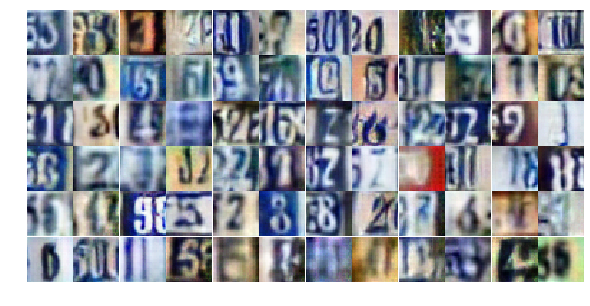

Epoch 21/25... Discriminator Loss: 1.4381... Generator Loss: 2.9377
Epoch 21/25... Discriminator Loss: 1.3048... Generator Loss: 0.4948
Epoch 21/25... Discriminator Loss: 0.7671... Generator Loss: 1.0045
Epoch 21/25... Discriminator Loss: 0.8427... Generator Loss: 0.8999
Epoch 21/25... Discriminator Loss: 0.4876... Generator Loss: 1.3029
Epoch 21/25... Discriminator Loss: 0.6952... Generator Loss: 1.4284
Epoch 21/25... Discriminator Loss: 0.6206... Generator Loss: 1.2456
Epoch 21/25... Discriminator Loss: 1.3115... Generator Loss: 0.6040
Epoch 21/25... Discriminator Loss: 0.9486... Generator Loss: 0.7051
Epoch 21/25... Discriminator Loss: 0.5694... Generator Loss: 1.3325


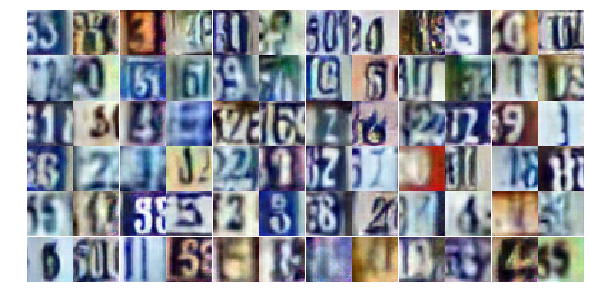

Epoch 21/25... Discriminator Loss: 0.5192... Generator Loss: 1.8478
Epoch 21/25... Discriminator Loss: 1.2872... Generator Loss: 0.4704
Epoch 21/25... Discriminator Loss: 1.0492... Generator Loss: 0.8365
Epoch 22/25... Discriminator Loss: 1.0401... Generator Loss: 2.7071
Epoch 22/25... Discriminator Loss: 1.0309... Generator Loss: 0.7221
Epoch 22/25... Discriminator Loss: 0.8592... Generator Loss: 0.8225
Epoch 22/25... Discriminator Loss: 0.5450... Generator Loss: 1.4318
Epoch 22/25... Discriminator Loss: 0.4712... Generator Loss: 1.3708
Epoch 22/25... Discriminator Loss: 1.0126... Generator Loss: 0.7238
Epoch 22/25... Discriminator Loss: 0.9045... Generator Loss: 0.8505


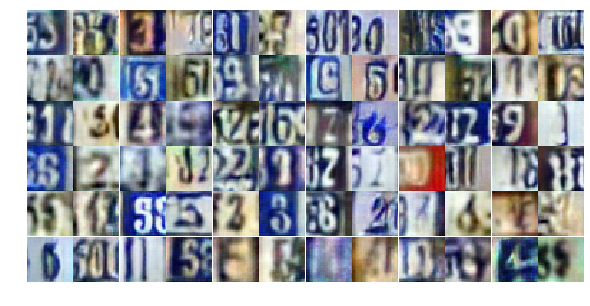

Epoch 22/25... Discriminator Loss: 0.7176... Generator Loss: 1.0375
Epoch 22/25... Discriminator Loss: 0.7046... Generator Loss: 1.7798
Epoch 22/25... Discriminator Loss: 1.4876... Generator Loss: 0.4887
Epoch 22/25... Discriminator Loss: 0.8727... Generator Loss: 0.7807
Epoch 22/25... Discriminator Loss: 0.7246... Generator Loss: 1.2280
Epoch 22/25... Discriminator Loss: 0.6095... Generator Loss: 1.7804
Epoch 22/25... Discriminator Loss: 0.7543... Generator Loss: 0.8933
Epoch 22/25... Discriminator Loss: 0.5217... Generator Loss: 1.2547
Epoch 22/25... Discriminator Loss: 0.8233... Generator Loss: 0.9264
Epoch 22/25... Discriminator Loss: 1.5588... Generator Loss: 0.3927


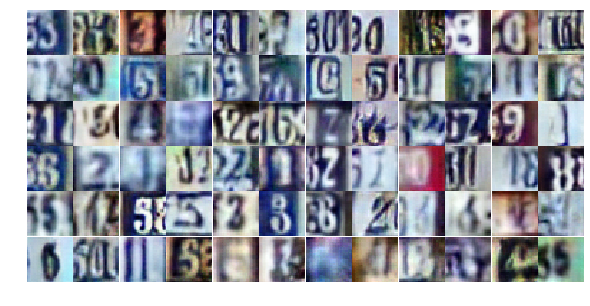

Epoch 22/25... Discriminator Loss: 0.5006... Generator Loss: 1.7939
Epoch 22/25... Discriminator Loss: 0.6592... Generator Loss: 1.0039
Epoch 22/25... Discriminator Loss: 0.9060... Generator Loss: 0.7371
Epoch 22/25... Discriminator Loss: 0.4452... Generator Loss: 1.3768
Epoch 22/25... Discriminator Loss: 0.4595... Generator Loss: 1.8000
Epoch 22/25... Discriminator Loss: 1.1815... Generator Loss: 0.5511
Epoch 22/25... Discriminator Loss: 0.4078... Generator Loss: 1.6482
Epoch 22/25... Discriminator Loss: 0.4600... Generator Loss: 1.4754
Epoch 22/25... Discriminator Loss: 0.5451... Generator Loss: 1.2562
Epoch 22/25... Discriminator Loss: 1.1902... Generator Loss: 0.4906


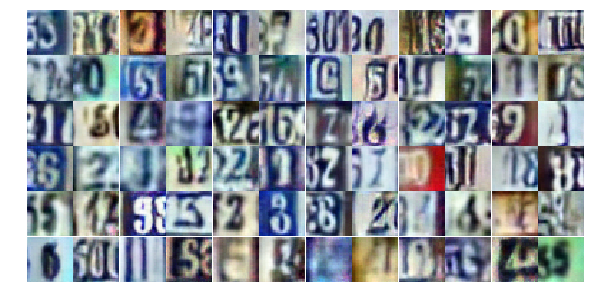

Epoch 22/25... Discriminator Loss: 0.5617... Generator Loss: 1.1732
Epoch 22/25... Discriminator Loss: 0.6331... Generator Loss: 1.1541
Epoch 22/25... Discriminator Loss: 0.6112... Generator Loss: 1.4540
Epoch 22/25... Discriminator Loss: 0.7449... Generator Loss: 0.8968
Epoch 22/25... Discriminator Loss: 0.8052... Generator Loss: 0.8515
Epoch 22/25... Discriminator Loss: 0.8933... Generator Loss: 0.8201
Epoch 22/25... Discriminator Loss: 1.7096... Generator Loss: 0.2971
Epoch 22/25... Discriminator Loss: 0.6572... Generator Loss: 1.3307
Epoch 22/25... Discriminator Loss: 1.0185... Generator Loss: 0.7402
Epoch 22/25... Discriminator Loss: 1.1421... Generator Loss: 0.5809


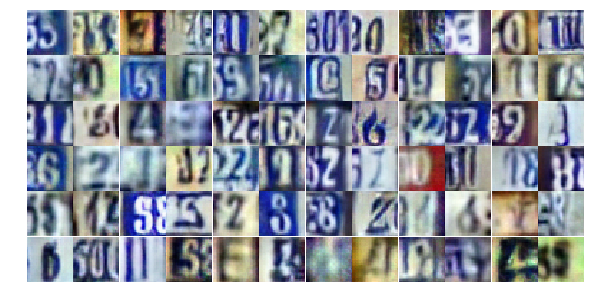

Epoch 22/25... Discriminator Loss: 0.8098... Generator Loss: 0.9445
Epoch 22/25... Discriminator Loss: 0.4149... Generator Loss: 1.6925
Epoch 22/25... Discriminator Loss: 0.3106... Generator Loss: 1.8585
Epoch 22/25... Discriminator Loss: 0.6763... Generator Loss: 0.9847
Epoch 22/25... Discriminator Loss: 0.4274... Generator Loss: 1.4230
Epoch 22/25... Discriminator Loss: 0.3356... Generator Loss: 1.7913
Epoch 22/25... Discriminator Loss: 1.0019... Generator Loss: 0.6783
Epoch 22/25... Discriminator Loss: 1.0364... Generator Loss: 0.6177
Epoch 22/25... Discriminator Loss: 1.3186... Generator Loss: 0.5492
Epoch 22/25... Discriminator Loss: 1.2264... Generator Loss: 0.7073


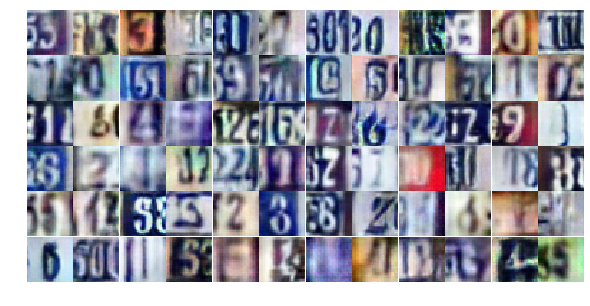

Epoch 22/25... Discriminator Loss: 0.8471... Generator Loss: 1.6523
Epoch 22/25... Discriminator Loss: 0.9538... Generator Loss: 0.7081
Epoch 22/25... Discriminator Loss: 0.8058... Generator Loss: 0.8583
Epoch 22/25... Discriminator Loss: 0.8719... Generator Loss: 0.9501
Epoch 22/25... Discriminator Loss: 1.1287... Generator Loss: 0.9018
Epoch 22/25... Discriminator Loss: 0.7158... Generator Loss: 1.6467
Epoch 22/25... Discriminator Loss: 1.4037... Generator Loss: 0.4338
Epoch 22/25... Discriminator Loss: 1.1160... Generator Loss: 0.5707
Epoch 22/25... Discriminator Loss: 1.3468... Generator Loss: 2.6841
Epoch 22/25... Discriminator Loss: 0.9944... Generator Loss: 0.7289


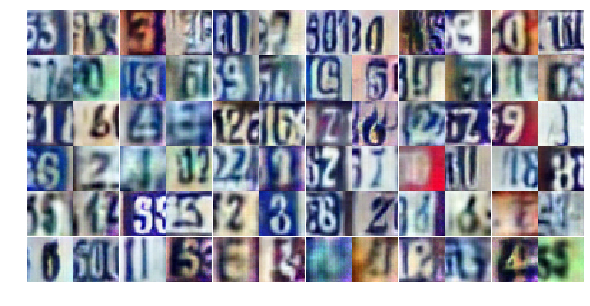

Epoch 23/25... Discriminator Loss: 0.5087... Generator Loss: 1.4335
Epoch 23/25... Discriminator Loss: 0.4242... Generator Loss: 1.5814
Epoch 23/25... Discriminator Loss: 0.9357... Generator Loss: 0.7081
Epoch 23/25... Discriminator Loss: 0.8677... Generator Loss: 0.7590
Epoch 23/25... Discriminator Loss: 0.9027... Generator Loss: 0.7178
Epoch 23/25... Discriminator Loss: 1.1134... Generator Loss: 0.5466
Epoch 23/25... Discriminator Loss: 1.2238... Generator Loss: 0.5348
Epoch 23/25... Discriminator Loss: 0.7234... Generator Loss: 0.9724
Epoch 23/25... Discriminator Loss: 0.9363... Generator Loss: 0.8006
Epoch 23/25... Discriminator Loss: 0.3950... Generator Loss: 1.7388


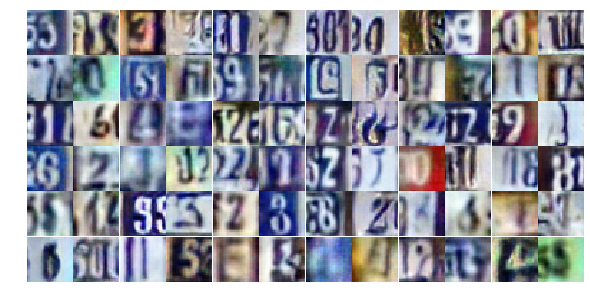

Epoch 23/25... Discriminator Loss: 0.7289... Generator Loss: 1.0183
Epoch 23/25... Discriminator Loss: 0.8504... Generator Loss: 0.7554
Epoch 23/25... Discriminator Loss: 0.6833... Generator Loss: 1.1829
Epoch 23/25... Discriminator Loss: 0.5350... Generator Loss: 1.2327
Epoch 23/25... Discriminator Loss: 0.5101... Generator Loss: 1.2923
Epoch 23/25... Discriminator Loss: 0.9385... Generator Loss: 0.7694
Epoch 23/25... Discriminator Loss: 0.7467... Generator Loss: 1.2725
Epoch 23/25... Discriminator Loss: 0.8456... Generator Loss: 0.8396
Epoch 23/25... Discriminator Loss: 0.6673... Generator Loss: 1.1701
Epoch 23/25... Discriminator Loss: 0.6750... Generator Loss: 1.0855


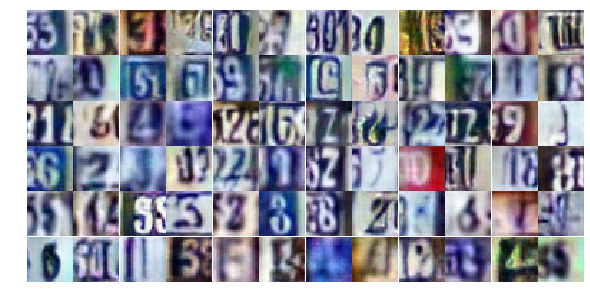

Epoch 23/25... Discriminator Loss: 1.2248... Generator Loss: 0.5616
Epoch 23/25... Discriminator Loss: 0.5757... Generator Loss: 1.5396
Epoch 23/25... Discriminator Loss: 0.8850... Generator Loss: 0.7551
Epoch 23/25... Discriminator Loss: 0.6609... Generator Loss: 1.0799
Epoch 23/25... Discriminator Loss: 0.7856... Generator Loss: 1.0219
Epoch 23/25... Discriminator Loss: 0.7123... Generator Loss: 2.1219
Epoch 23/25... Discriminator Loss: 0.7076... Generator Loss: 0.9634
Epoch 23/25... Discriminator Loss: 0.8725... Generator Loss: 0.8579
Epoch 23/25... Discriminator Loss: 0.7767... Generator Loss: 0.8700
Epoch 23/25... Discriminator Loss: 0.8032... Generator Loss: 1.3284


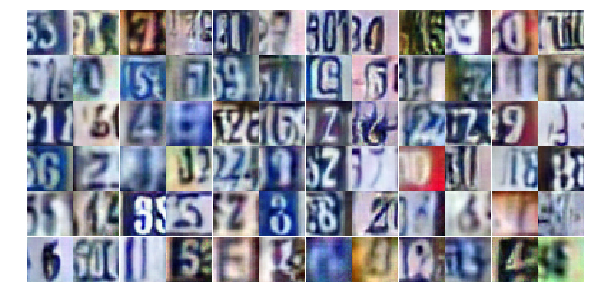

Epoch 23/25... Discriminator Loss: 0.5288... Generator Loss: 1.8359
Epoch 23/25... Discriminator Loss: 1.1578... Generator Loss: 0.6221
Epoch 23/25... Discriminator Loss: 0.7489... Generator Loss: 0.9377
Epoch 23/25... Discriminator Loss: 1.2328... Generator Loss: 0.5521
Epoch 23/25... Discriminator Loss: 0.8679... Generator Loss: 2.0744
Epoch 23/25... Discriminator Loss: 1.3773... Generator Loss: 0.4116
Epoch 23/25... Discriminator Loss: 1.2583... Generator Loss: 0.4799
Epoch 23/25... Discriminator Loss: 0.9504... Generator Loss: 0.7684
Epoch 23/25... Discriminator Loss: 0.3905... Generator Loss: 1.7287
Epoch 23/25... Discriminator Loss: 0.4638... Generator Loss: 1.4054


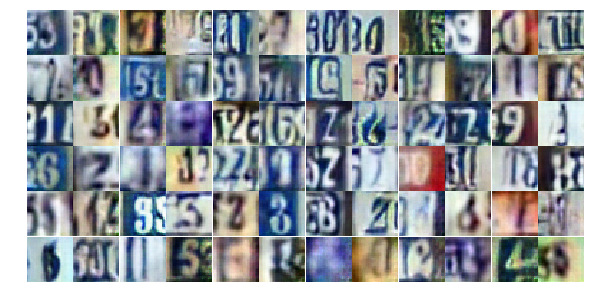

Epoch 23/25... Discriminator Loss: 0.8586... Generator Loss: 0.9411
Epoch 23/25... Discriminator Loss: 0.7493... Generator Loss: 0.9782
Epoch 23/25... Discriminator Loss: 1.2320... Generator Loss: 0.5400
Epoch 23/25... Discriminator Loss: 1.3049... Generator Loss: 0.4979
Epoch 23/25... Discriminator Loss: 1.7199... Generator Loss: 0.3923
Epoch 23/25... Discriminator Loss: 1.1665... Generator Loss: 0.5445
Epoch 23/25... Discriminator Loss: 0.5127... Generator Loss: 2.6762
Epoch 23/25... Discriminator Loss: 1.2991... Generator Loss: 0.4875
Epoch 23/25... Discriminator Loss: 0.7688... Generator Loss: 0.9685
Epoch 23/25... Discriminator Loss: 1.1253... Generator Loss: 0.7865


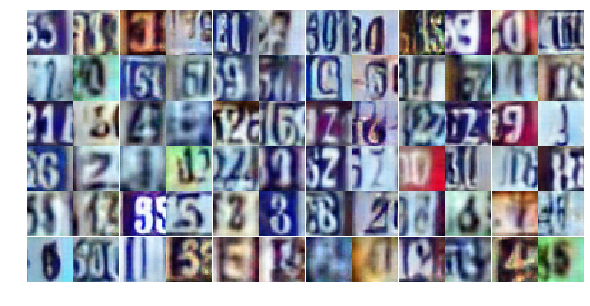

Epoch 23/25... Discriminator Loss: 0.5859... Generator Loss: 1.2003
Epoch 23/25... Discriminator Loss: 1.6557... Generator Loss: 0.3231
Epoch 23/25... Discriminator Loss: 0.8750... Generator Loss: 0.9741
Epoch 23/25... Discriminator Loss: 0.2904... Generator Loss: 2.1584
Epoch 23/25... Discriminator Loss: 1.1126... Generator Loss: 0.6172
Epoch 23/25... Discriminator Loss: 0.5504... Generator Loss: 1.6646
Epoch 23/25... Discriminator Loss: 0.8592... Generator Loss: 0.7739
Epoch 24/25... Discriminator Loss: 0.5975... Generator Loss: 1.2081
Epoch 24/25... Discriminator Loss: 0.6684... Generator Loss: 0.9952
Epoch 24/25... Discriminator Loss: 1.4858... Generator Loss: 0.4121


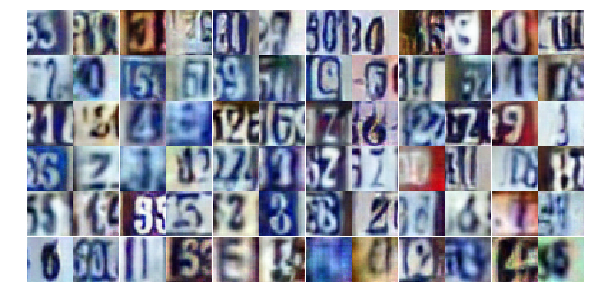

Epoch 24/25... Discriminator Loss: 0.5790... Generator Loss: 1.6769
Epoch 24/25... Discriminator Loss: 0.8325... Generator Loss: 0.8196
Epoch 24/25... Discriminator Loss: 0.7387... Generator Loss: 0.8635
Epoch 24/25... Discriminator Loss: 0.7405... Generator Loss: 1.3907
Epoch 24/25... Discriminator Loss: 0.9259... Generator Loss: 0.6863
Epoch 24/25... Discriminator Loss: 0.9831... Generator Loss: 0.6888
Epoch 24/25... Discriminator Loss: 0.5438... Generator Loss: 1.2674
Epoch 24/25... Discriminator Loss: 1.3328... Generator Loss: 0.5173
Epoch 24/25... Discriminator Loss: 0.7573... Generator Loss: 0.9627
Epoch 24/25... Discriminator Loss: 0.4246... Generator Loss: 1.5300


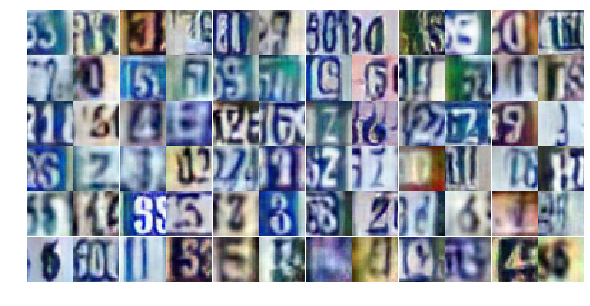

Epoch 24/25... Discriminator Loss: 0.9011... Generator Loss: 0.7579
Epoch 24/25... Discriminator Loss: 1.2162... Generator Loss: 0.5342
Epoch 24/25... Discriminator Loss: 1.7925... Generator Loss: 0.2662
Epoch 24/25... Discriminator Loss: 1.2717... Generator Loss: 0.4450
Epoch 24/25... Discriminator Loss: 2.0368... Generator Loss: 4.0815
Epoch 24/25... Discriminator Loss: 2.6438... Generator Loss: 0.2761
Epoch 24/25... Discriminator Loss: 1.3219... Generator Loss: 0.9048
Epoch 24/25... Discriminator Loss: 1.7407... Generator Loss: 0.6134
Epoch 24/25... Discriminator Loss: 1.8704... Generator Loss: 0.7236
Epoch 24/25... Discriminator Loss: 1.5797... Generator Loss: 0.8269


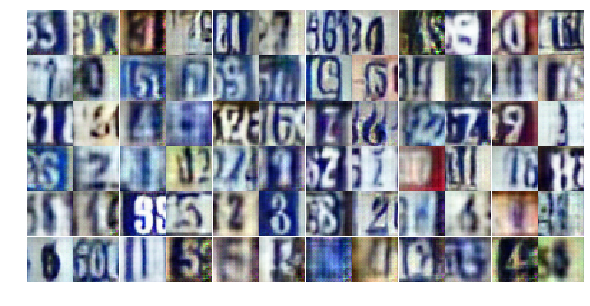

Epoch 24/25... Discriminator Loss: 1.4909... Generator Loss: 0.7659
Epoch 24/25... Discriminator Loss: 1.4573... Generator Loss: 0.8673
Epoch 24/25... Discriminator Loss: 1.3817... Generator Loss: 0.8065
Epoch 24/25... Discriminator Loss: 1.3239... Generator Loss: 0.7844
Epoch 24/25... Discriminator Loss: 1.3981... Generator Loss: 0.8051
Epoch 24/25... Discriminator Loss: 1.3646... Generator Loss: 0.9301
Epoch 24/25... Discriminator Loss: 1.4718... Generator Loss: 0.8290
Epoch 24/25... Discriminator Loss: 1.3985... Generator Loss: 0.7639
Epoch 24/25... Discriminator Loss: 1.3216... Generator Loss: 0.8013
Epoch 24/25... Discriminator Loss: 1.3374... Generator Loss: 0.8156


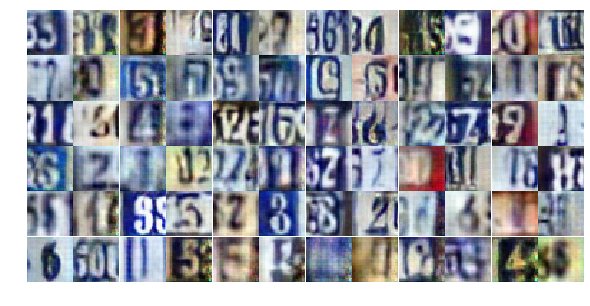

Epoch 24/25... Discriminator Loss: 1.4192... Generator Loss: 0.7257
Epoch 24/25... Discriminator Loss: 1.4176... Generator Loss: 0.7215
Epoch 24/25... Discriminator Loss: 1.3724... Generator Loss: 0.7404
Epoch 24/25... Discriminator Loss: 1.2902... Generator Loss: 0.8353
Epoch 24/25... Discriminator Loss: 1.3261... Generator Loss: 0.7487
Epoch 24/25... Discriminator Loss: 1.2957... Generator Loss: 0.8281
Epoch 24/25... Discriminator Loss: 1.3778... Generator Loss: 0.7589
Epoch 24/25... Discriminator Loss: 1.3699... Generator Loss: 0.7880
Epoch 24/25... Discriminator Loss: 1.2521... Generator Loss: 0.7546
Epoch 24/25... Discriminator Loss: 1.3086... Generator Loss: 0.6939


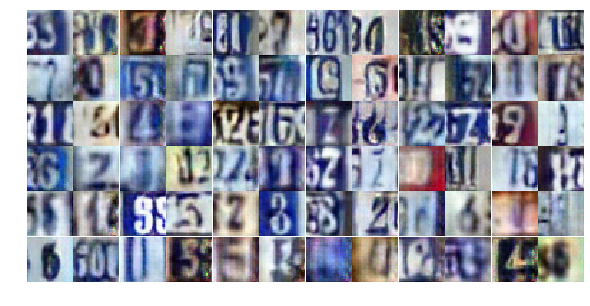

Epoch 24/25... Discriminator Loss: 1.4119... Generator Loss: 0.6985
Epoch 24/25... Discriminator Loss: 1.3157... Generator Loss: 0.7370
Epoch 24/25... Discriminator Loss: 1.3654... Generator Loss: 0.6901
Epoch 24/25... Discriminator Loss: 1.4171... Generator Loss: 0.6604
Epoch 24/25... Discriminator Loss: 1.4181... Generator Loss: 0.6554
Epoch 24/25... Discriminator Loss: 1.3657... Generator Loss: 0.7649
Epoch 24/25... Discriminator Loss: 1.3631... Generator Loss: 0.7036
Epoch 24/25... Discriminator Loss: 1.3790... Generator Loss: 0.7185
Epoch 24/25... Discriminator Loss: 1.4244... Generator Loss: 0.8662
Epoch 24/25... Discriminator Loss: 1.3565... Generator Loss: 0.7890


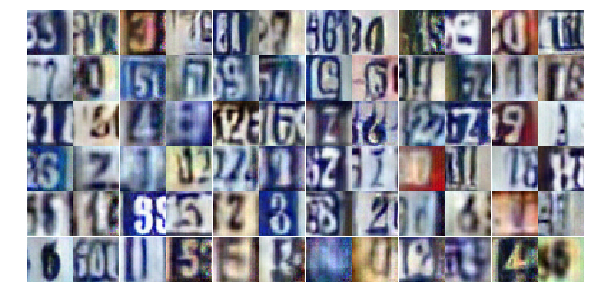

Epoch 24/25... Discriminator Loss: 1.3562... Generator Loss: 0.7448
Epoch 24/25... Discriminator Loss: 1.4036... Generator Loss: 0.6980
Epoch 24/25... Discriminator Loss: 1.3347... Generator Loss: 0.7238
Epoch 24/25... Discriminator Loss: 1.3638... Generator Loss: 0.8219
Epoch 24/25... Discriminator Loss: 1.3645... Generator Loss: 0.8293
Epoch 25/25... Discriminator Loss: 1.4375... Generator Loss: 0.7717
Epoch 25/25... Discriminator Loss: 1.2242... Generator Loss: 0.7993
Epoch 25/25... Discriminator Loss: 1.4874... Generator Loss: 0.7690
Epoch 25/25... Discriminator Loss: 1.3605... Generator Loss: 0.8280
Epoch 25/25... Discriminator Loss: 1.1692... Generator Loss: 0.8971


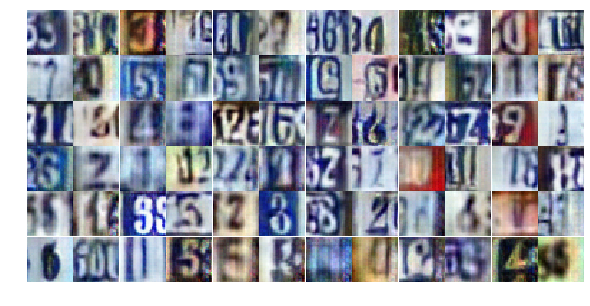

Epoch 25/25... Discriminator Loss: 1.2890... Generator Loss: 0.9043
Epoch 25/25... Discriminator Loss: 1.4011... Generator Loss: 0.7655
Epoch 25/25... Discriminator Loss: 1.3617... Generator Loss: 0.7359
Epoch 25/25... Discriminator Loss: 1.2956... Generator Loss: 0.7529
Epoch 25/25... Discriminator Loss: 1.3825... Generator Loss: 0.7172
Epoch 25/25... Discriminator Loss: 1.5107... Generator Loss: 0.7714
Epoch 25/25... Discriminator Loss: 1.4519... Generator Loss: 0.6900
Epoch 25/25... Discriminator Loss: 1.3367... Generator Loss: 0.8118
Epoch 25/25... Discriminator Loss: 1.2610... Generator Loss: 0.8073
Epoch 25/25... Discriminator Loss: 1.4238... Generator Loss: 0.7097


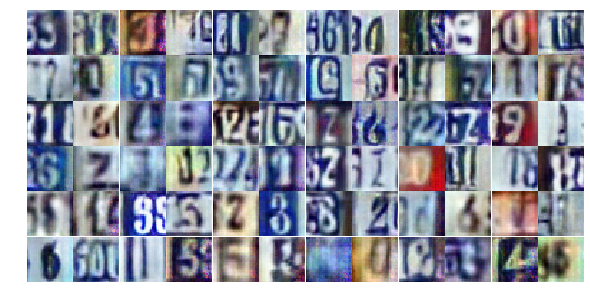

Epoch 25/25... Discriminator Loss: 1.3563... Generator Loss: 0.7320
Epoch 25/25... Discriminator Loss: 1.3909... Generator Loss: 0.6757
Epoch 25/25... Discriminator Loss: 1.3353... Generator Loss: 0.7130
Epoch 25/25... Discriminator Loss: 1.3930... Generator Loss: 0.7675
Epoch 25/25... Discriminator Loss: 1.2970... Generator Loss: 0.7023
Epoch 25/25... Discriminator Loss: 1.3242... Generator Loss: 0.7713
Epoch 25/25... Discriminator Loss: 1.2974... Generator Loss: 0.8837
Epoch 25/25... Discriminator Loss: 1.5624... Generator Loss: 0.6661
Epoch 25/25... Discriminator Loss: 1.2932... Generator Loss: 0.8128
Epoch 25/25... Discriminator Loss: 1.3283... Generator Loss: 0.8284


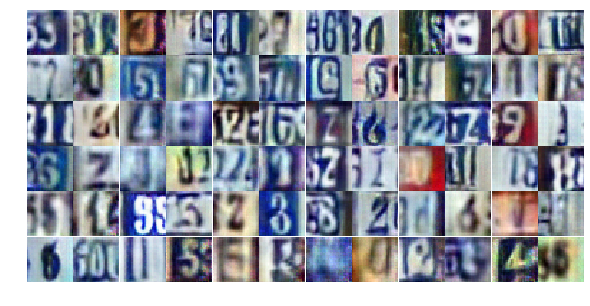

Epoch 25/25... Discriminator Loss: 1.3968... Generator Loss: 0.7714
Epoch 25/25... Discriminator Loss: 1.2844... Generator Loss: 0.7195
Epoch 25/25... Discriminator Loss: 1.3254... Generator Loss: 0.7412
Epoch 25/25... Discriminator Loss: 1.3551... Generator Loss: 0.7651
Epoch 25/25... Discriminator Loss: 1.3410... Generator Loss: 0.7310
Epoch 25/25... Discriminator Loss: 1.3120... Generator Loss: 0.7723
Epoch 25/25... Discriminator Loss: 1.3294... Generator Loss: 0.7855
Epoch 25/25... Discriminator Loss: 1.3209... Generator Loss: 0.8175
Epoch 25/25... Discriminator Loss: 1.3400... Generator Loss: 0.7950
Epoch 25/25... Discriminator Loss: 1.3644... Generator Loss: 0.6929


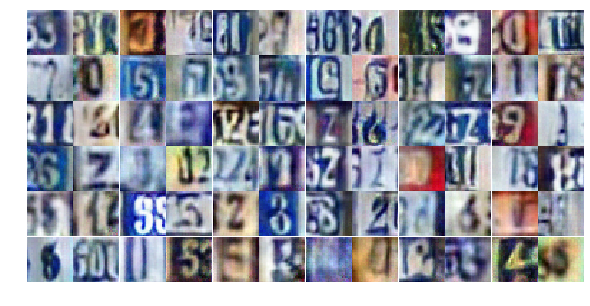

Epoch 25/25... Discriminator Loss: 1.3502... Generator Loss: 0.7213
Epoch 25/25... Discriminator Loss: 1.4496... Generator Loss: 0.6468
Epoch 25/25... Discriminator Loss: 1.4095... Generator Loss: 0.7844
Epoch 25/25... Discriminator Loss: 1.2315... Generator Loss: 0.7427
Epoch 25/25... Discriminator Loss: 1.3111... Generator Loss: 0.8308
Epoch 25/25... Discriminator Loss: 1.3875... Generator Loss: 0.7166
Epoch 25/25... Discriminator Loss: 1.0646... Generator Loss: 0.9224
Epoch 25/25... Discriminator Loss: 0.9536... Generator Loss: 1.1680
Epoch 25/25... Discriminator Loss: 1.4847... Generator Loss: 0.6892
Epoch 25/25... Discriminator Loss: 1.2797... Generator Loss: 0.7159


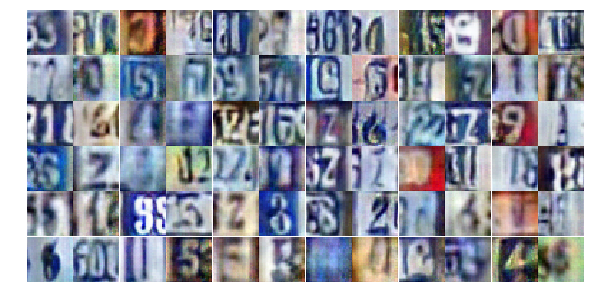

Epoch 25/25... Discriminator Loss: 1.5083... Generator Loss: 0.5635
Epoch 25/25... Discriminator Loss: 1.1700... Generator Loss: 0.8247
Epoch 25/25... Discriminator Loss: 1.4026... Generator Loss: 0.6746
Epoch 25/25... Discriminator Loss: 1.3207... Generator Loss: 0.8623
Epoch 25/25... Discriminator Loss: 1.2517... Generator Loss: 0.8989
Epoch 25/25... Discriminator Loss: 1.3437... Generator Loss: 0.8013
Epoch 25/25... Discriminator Loss: 1.2893... Generator Loss: 0.7823
Epoch 25/25... Discriminator Loss: 1.3199... Generator Loss: 0.7534
Epoch 25/25... Discriminator Loss: 1.3259... Generator Loss: 0.7969
Epoch 25/25... Discriminator Loss: 1.3892... Generator Loss: 0.7208


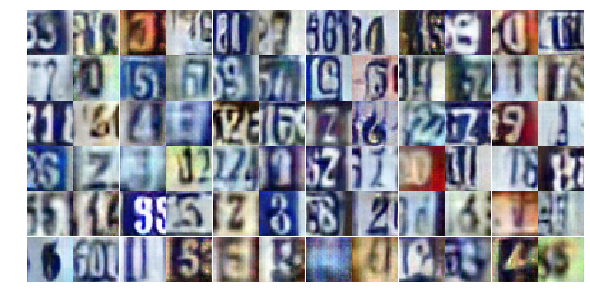

Epoch 25/25... Discriminator Loss: 1.3936... Generator Loss: 0.7845
Epoch 25/25... Discriminator Loss: 1.3457... Generator Loss: 0.7881


In [21]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

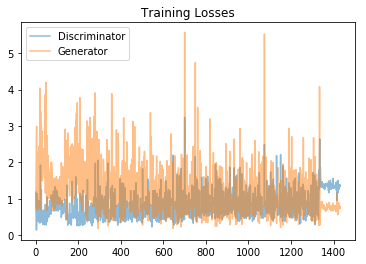

In [22]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

/usr/local/lib/python3.6/dist-packages/matplotlib/axes/_base.py:1334: MatplotlibDeprecationWarning: 
box-forced
  "2.2", "box-forced", obj_type="keyword argument")


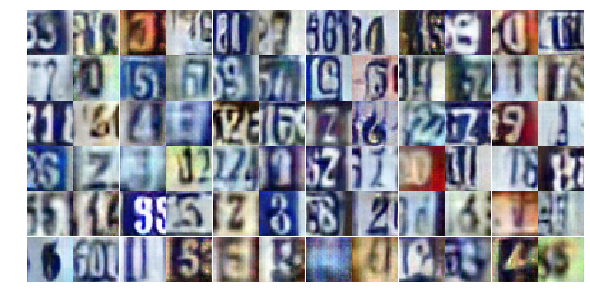

In [24]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))